In [1]:
import sys
import os
import glob
import gsw
import numpy as np
import pandas as pd
import xarray as xr
import xesmf as xe
import cmocean.cm as cm
import matplotlib.pyplot as plt
import matplotlib.path as mpath
import matplotlib.ticker as ticker
import matplotlib.colors as mcolors
import matplotlib.gridspec as gridspec # Plot irregular axes
from matplotlib.patches import Patch # For plot legend in color bar map
from matplotlib.lines import Line2D
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.mpl.gridliner as gridliner
# Add the current directory to the system path
sys.path.append('/g/data/jk72/zc0441')
from scipy.stats import linregress # linear regression
from zpackage.zclef import Zlook,Zsearch
from zpackage import wmt

# Function def

## wmt_in_density

In [2]:
def wmt_in_density(transformation, density_map, density_boundary, density_interval, flag = None):
    """
    Calculate the water mass transformation within density bins.

    Parameters:
        transformation (xarray.DataArray): Transformation data.
        density_map (xarray.DataArray): Density map data.
        density_boundary (tuple): Tuple containing the lower and upper boundaries of the density range.
        density_interval (float): Interval between density bins.
        flag (str, optional): Flag indicating the mode of calculation. 
            If 'lateral', calculates calculates transformation for accumulation mode. 
            If None or any other value, transformation without accumulation. 
            Defaults to None.

    Returns:
        xarray.DataArray: Water mass transformation within density bins.
    """
    interval = density_interval  # Corrected variable name
    density_range = np.arange(density_boundary[0], density_boundary[1], interval) 
    sverdrup = 10**6  # Unit for severdrop 10^6 m^3/s
    km2 = 10**6  # Unit for km2
    tr_list = []
    for den in density_range:
        den_left = 1000 + den - interval/2
        den_right = 1000 + den + interval/2  # the right and left density boundary 
        if flag == 'lateral':
            # Calculate transformation without accumulation
            tranformation_in_den = transformation.where(density_map < den_right) / sverdrup 
        elif flag == 'formation':
            # Calculate formation without accumulation
            tranformation_in_den = transformation.where((density_map >= den_left) & (density_map < den_right)) / sverdrup
        else:
            # Calculate transformation for accumulation mode
            tranformation_in_den = transformation.where((density_map >= den_left) & (density_map < den_right)) / interval / sverdrup
        tranformation_all = tranformation_in_den.sum().values.item()
        tr_list.append(tranformation_all)
        
    tr_in_density = xr.DataArray(tr_list, dims=('density'), coords={'density': density_range}) 
    return tr_in_density

## plot_buo_map

In [3]:
def plot_buo_map(model_list, model_data, map_variable, title=None):
    # Calculate the number of rows and columns for subplots
    fig_num = len(model_list)
    ncol = 4
    nrow = fig_num // ncol if fig_num % ncol == 0 else fig_num // ncol + 1

    # Create subplots with specified projection and size
    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(4.5*ncol, 4.7*nrow),
                            subplot_kw=dict(projection=ccrs.Orthographic(0, -90)))

    # Flatten axs to iterate over all subplots
    axs = axs.flatten()

    # Iterate over each model in model_list
    for index, model in enumerate(model_list):
        ax = axs[index]  # Get current axis
        data = model_data[model]  # Get data for the current model
        lon_key = data['lon_key']  # Longitude key
        lat_key = data['lat_key']  # Latitude key
        lat_edge = data['lat_edge']  # Latitude edge
        si_map = data[map_variable]  # Get map variable data for the current model

        if 'AWI' in model:
            ax.scatter(x=si_map[lon_key], 
                        y=si_map[lat_key], 
                        c=si_map,  # Color based on fsi_values
                        cmap='RdBu_r', 
                        transform=ccrs.PlateCarree(),
                        # ax = ax,
                        vmin=-200,  # Min value for color mapping
                        vmax=200, # Max value for color mapping
                        s = 0.1)  

        else:
            # Plot si_map on the current axis
            fig1 = si_map.plot(x=lon_key, y=lat_key,
                               transform=ccrs.PlateCarree(),
                               levels=np.arange(-200.1, 200.1, 2),
                               add_colorbar=False,
                               ax=ax)


        
        if 'sic_mean_mon' in data:
            sic_sep = data['sic_mean_mon'].sel(month = 9)
            if 'nearest_index' in data:
                nearest_index = data['nearest_index']  # Latitude edge
                sic_sorted = sic_sep.sortby(sic_sep[lon_key][nearest_index,:])
            elif 'FIO' in model:
                nearest_index = 45  # Latitude edge
                sic_sorted = sic_sep.sortby(sic_sep[lon_key][nearest_index,:])
            else:
                sic_sorted = sic_sep
            if 'MPI-ESM1-2-LR' in model_list[index]:
                sic_sorted =sic_sorted.sortby(sic_sorted[lon_key][nearest_index + 20,:])
                sic_sorted =sic_sorted[:,1:-1]
            if 'MPI-ESM-1-2-HAM' in model_list[index]:
                sic_sorted =sic_sorted.sortby(sic_sorted[lon_key][nearest_index + 20,:])
                sic_sorted =sic_sorted[:,2:-2]
            if 'Nor' in model_list[index]:
                sic_sorted =sic_sorted.sortby(sic_sorted[lon_key][nearest_index - 20,:])
            # ==Sea ice extent contour
            if 'AWI' in model:
                sic_sorted = sic_sorted.where(sic_sorted.lat < -45, 0)
                ax.tricontour(sic_sorted.lon, sic_sorted.lat, sic_sorted, 
                                levels = [0.15],
                                transform=ccrs.PlateCarree(),
                                linestyles='dashed',
                                colors = 'k',
                              )
            else:
                sic_sorted.plot.contour(x = lon_key, y=lat_key, levels=[0.15],
                                          ax = ax,
                                          transform=ccrs.PlateCarree(),
                                          linestyles='dashed',
                                          colors = 'k',
                                          )
            
            
        # Add coastlines and gridlines
        ax.coastlines()
        ax.gridlines(linestyle=':', draw_labels=True)
        
        # Set the extent and add land feature
        ax.set_extent([-180, 180, -90, lat_edge], crs=ccrs.PlateCarree())
        ax.add_feature(cfeature.LAND, facecolor='lightgray')
        
        # Set the title for the current subplot
        ax.set_title(model)

        # Add solid line at 50°S latitude
        lon = np.linspace(-180, 180, 100)
        lat = np.full_like(lon, lat_edge)
        ax.plot(lon, lat, color='gray', linestyle='-', transform=ccrs.PlateCarree())

        # Set the boundary with a circle
        theta = np.linspace(0, 2*np.pi, 100)
        center, radius = [0.5, 0.5], 0.5
        verts = np.vstack([np.sin(theta), np.cos(theta)]).T
        circle = mpath.Path(verts * radius + center)
        ax.set_boundary(circle, transform=ax.transAxes)

    # Add colorbar
    cbar = fig.colorbar(fig1, ax=axs.ravel().tolist(), 
                        cax=fig.add_axes([0.2, 0.08, 0.6, 0.01]),
                        orientation='horizontal')
    cbar.set_label(f'W/m$^2$')
    cbar.set_ticks(np.arange(-200, 200.1, 50))

    # Set figure title if provided
    if title:
        fig.suptitle(title, fontsize=16)
        
    # plt.tight_layout() 
    
    # Show the plot
    plt.show()
    return fig

## plot_buo_map_no_si

In [4]:
def plot_buo_map_no_si(model_list, model_data, map_variable, title=None):
    # Calculate the number of rows and columns for subplots
    fig_num = len(model_list)
    ncol = 4
    nrow = fig_num // ncol if fig_num % ncol == 0 else fig_num // ncol + 1

    # Create subplots with specified projection and size
    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(4.5*ncol, 4.7*nrow),
                            subplot_kw=dict(projection=ccrs.Orthographic(0, -90)))

    # Flatten axs to iterate over all subplots
    axs = axs.flatten()

    # Iterate over each model in model_list
    for index, model in enumerate(model_list):
        ax = axs[index]  # Get current axis
        data = model_data[model]  # Get data for the current model
        lon_key = data['lon_key']  # Longitude key
        lat_key = data['lat_key']  # Latitude key
        lat_edge = data['lat_edge']  # Latitude edge
        si_map = data['buo_wfo_map'] - data['buo_fsi_map'] # Get map variable data for the current model

        if 'AWI' in model:
            ax.scatter(x=si_map[lon_key], 
                        y=si_map[lat_key], 
                        c=si_map,  # Color based on fsi_values
                        cmap='RdBu_r', 
                        transform=ccrs.PlateCarree(),
                        # ax = ax,
                        vmin=-200,  # Min value for color mapping
                        vmax=200, # Max value for color mapping
                        s = 0.1)  

        else:
            # Plot si_map on the current axis
            fig1 = si_map.plot(x=lon_key, y=lat_key,
                               transform=ccrs.PlateCarree(),
                               levels=np.arange(-200.1, 200.1, 2),
                               add_colorbar=False,
                               ax=ax)


        
        if 'sic_mean_mon' in data:
            sic_sep = data['sic_mean_mon'].sel(month = 9)
            if 'nearest_index' in data:
                nearest_index = data['nearest_index']  # Latitude edge
                sic_sorted = sic_sep.sortby(sic_sep[lon_key][nearest_index,:])
            elif 'FIO' in model:
                nearest_index = 45  # Latitude edge
                sic_sorted = sic_sep.sortby(sic_sep[lon_key][nearest_index,:])
            else:
                sic_sorted = sic_sep
            if 'MPI-ESM1-2-LR' in model_list[index]:
                sic_sorted =sic_sorted.sortby(sic_sorted[lon_key][nearest_index + 20,:])
                sic_sorted =sic_sorted[:,1:-1]
            if 'MPI-ESM-1-2-HAM' in model_list[index]:
                sic_sorted =sic_sorted.sortby(sic_sorted[lon_key][nearest_index + 20,:])
                sic_sorted =sic_sorted[:,2:-2]
            if 'Nor' in model_list[index]:
                sic_sorted =sic_sorted.sortby(sic_sorted[lon_key][nearest_index - 20,:])
            # ==Sea ice extent contour
            if 'AWI' in model:
                sic_sorted = sic_sorted.where(sic_sorted.lat < -45, 0)
                ax.tricontour(sic_sorted.lon, sic_sorted.lat, sic_sorted, 
                                levels = [0.15],
                                transform=ccrs.PlateCarree(),
                                linestyles='dashed',
                                colors = 'k',
                              )
            else:
                sic_sorted.plot.contour(x = lon_key, y=lat_key, levels=[0.15],
                                          ax = ax,
                                          transform=ccrs.PlateCarree(),
                                          linestyles='dashed',
                                          colors = 'k',
                                          )
            
            
        # Add coastlines and gridlines
        ax.coastlines()
        ax.gridlines(linestyle=':', draw_labels=True)
        
        # Set the extent and add land feature
        ax.set_extent([-180, 180, -90, lat_edge], crs=ccrs.PlateCarree())
        ax.add_feature(cfeature.LAND, facecolor='lightgray')
        
        # Set the title for the current subplot
        ax.set_title(model)

        # Add solid line at 50°S latitude
        lon = np.linspace(-180, 180, 100)
        lat = np.full_like(lon, lat_edge)
        ax.plot(lon, lat, color='gray', linestyle='-', transform=ccrs.PlateCarree())

        # Set the boundary with a circle
        theta = np.linspace(0, 2*np.pi, 100)
        center, radius = [0.5, 0.5], 0.5
        verts = np.vstack([np.sin(theta), np.cos(theta)]).T
        circle = mpath.Path(verts * radius + center)
        ax.set_boundary(circle, transform=ax.transAxes)

    # Add colorbar
    cbar = fig.colorbar(fig1, ax=axs.ravel().tolist(), 
                        cax=fig.add_axes([0.2, 0.08, 0.6, 0.01]),
                        orientation='horizontal')
    cbar.set_label(f'W/m$^2$')
    cbar.set_ticks(np.arange(-200, 200.1, 50))

    # Set figure title if provided
    if title:
        fig.suptitle(title, fontsize=16)
        
    # plt.tight_layout() 
    
    # Show the plot
    plt.show()
    return fig

## plot_dominance_map

In [5]:
def plot_dominance_map(model_list, model_data, map_variable, title=None):
    # Calculate the number of rows and columns for subplots
    fig_num = len(model_list)
    ncol = 4
    nrow = fig_num // ncol if fig_num % ncol == 0 else fig_num // ncol + 1
    colors = ['#3498DB','#AED6F1','#EC7063','#F5B7B1']
    color_label = ['Sea ice-dominated densification region', 'Densification region',
               'Sea ice-dominated lightening region', 'Lightening region']
    # Create subplots with specified projection and size
    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(4.5*ncol, 4.7*nrow),
                            subplot_kw=dict(projection=ccrs.Orthographic(0, -90)))

    # Flatten axs to iterate over all subplots
    axs = axs.flatten()

    # Iterate over each model in model_list
    for index, model in enumerate(model_list):
        ax = axs[index]  # Get current axis
        data = model_data[model]  # Get data for the current model
        lon_key = data['lon_key']  # Longitude key
        lat_key = data['lat_key']  # Latitude key
        lat_edge = data['lat_edge']  # Latitude edge
        si_map = data[map_variable]  # Get map variable data for the current model
        total_map = data['buo_total_map']
        if 'ACCESS-ESM' in model:
            si_map = si_map.fillna(0)
        si_map = si_map/total_map
        
        if 'AWI' in model:
            ax.scatter(x=si_map[lon_key], 
                        y=si_map[lat_key], 
                        c=si_map.where(total_map < 0),  # Color based on fsi_values
                        cmap=mcolors.ListedColormap(['#AED6F1', '#AED6F1' , '#3498DB']),# Blue, 
                        transform=ccrs.PlateCarree(),
                        # ax = ax,
                        vmin=0,  # Min value for color mapping
                        vmax=.5, # Max value for color mapping
                        s = 0.1)  
            ax.scatter(x=si_map[lon_key], 
                        y=si_map[lat_key], 
                        c=si_map.where(total_map > 0),  # Color based on fsi_values
                        cmap=mcolors.ListedColormap(['#F5B7B1', '#F5B7B1' , '#EC7063']),# Blue, 
                        transform=ccrs.PlateCarree(),
                        # ax = ax,
                        vmin=0,  # Min value for color mapping
                        vmax=.5, # Max value for color mapping
                        s = 0.1) 

        else:
            # Plot si_map on the current axis
            fig1 =si_map.where(total_map < 0).plot(x = lon_key,y = lat_key,
                            transform=ccrs.PlateCarree(),
                            # levels = np.arange(-1, 1, .001), 
                            levels = [0, .5], 
                            add_colorbar=False,
                            ax = ax,
                            cmap = mcolors.ListedColormap(['#AED6F1', '#AED6F1' , '#3498DB'])# Blue
                            ) 

            si_map.where(total_map > 0).plot(x = lon_key,y = lat_key,
                            transform=ccrs.PlateCarree(),
                            # levels = np.arange(-1, 1, .001), 
                            levels = [0.0015, .5], 
                            add_colorbar=False,
                            ax = ax,
                            cmap = mcolors.ListedColormap(['#F5B7B1', '#F5B7B1' , '#EC7063'])# Red
                            ) 
        
        if 'sic_mean_mon' in data:
            sic_sep = data['sic_mean_mon'].sel(month = 9)
            if 'nearest_index' in data:
                nearest_index = data['nearest_index']  # Latitude edge
                sic_sorted = sic_sep.sortby(sic_sep[lon_key][nearest_index,:])
            elif 'FIO' in model:
                nearest_index = 45  # Latitude edge
                sic_sorted = sic_sep.sortby(sic_sep[lon_key][nearest_index,:])
            else:
                sic_sorted = sic_sep
            if 'MPI-ESM1-2-LR' in model_list[index]:
                sic_sorted =sic_sorted.sortby(sic_sorted[lon_key][nearest_index + 20,:])
                sic_sorted =sic_sorted[:,1:-1]
            if 'MPI-ESM-1-2-HAM' in model_list[index]:
                sic_sorted =sic_sorted.sortby(sic_sorted[lon_key][nearest_index + 20,:])
                sic_sorted =sic_sorted[:,2:-2]
            if 'Nor' in model_list[index]:
                sic_sorted =sic_sorted.sortby(sic_sorted[lon_key][nearest_index - 20,:])
            # ==Sea ice extent contour
            if 'AWI' in model:
                sic_sorted = sic_sorted.where(sic_sorted.lat < -45, 0)
                ax.tricontour(sic_sorted.lon, sic_sorted.lat, sic_sorted, 
                                levels = [0.15],
                                transform=ccrs.PlateCarree(),
                                linestyles='dashed',
                                colors = 'k',
                              )
            else:
                sic_sorted.plot.contour(x = lon_key, y=lat_key, levels=[0.15],
                                          ax = ax,
                                          transform=ccrs.PlateCarree(),
                                          linestyles='dashed',
                                          colors = 'k',
                                          )
            
            
        # Add coastlines and gridlines
        ax.coastlines()
        ax.gridlines(linestyle=':', draw_labels=True)
        
        # Set the extent and add land feature
        ax.set_extent([-180, 180, -90, lat_edge], crs=ccrs.PlateCarree())
        ax.add_feature(cfeature.LAND, facecolor='lightgray')
        
        # Set the title for the current subplot
        ax.set_title(model)

        # Add solid line at 50°S latitude
        lon = np.linspace(-180, 180, 100)
        lat = np.full_like(lon, lat_edge)
        ax.plot(lon, lat, color='gray', linestyle='-', transform=ccrs.PlateCarree())

        # Set the boundary with a circle
        theta = np.linspace(0, 2*np.pi, 100)
        center, radius = [0.5, 0.5], 0.5
        verts = np.vstack([np.sin(theta), np.cos(theta)]).T
        circle = mpath.Path(verts * radius + center)
        ax.set_boundary(circle, transform=ax.transAxes)

    legend_handles = [Line2D([0], [0], color=color, linewidth=10, linestyle='-', label=f'{color_label[i]}') for i, color in enumerate(colors)]
    
    # Add legend with handles and labels outside the axes
    fig.legend(handles=legend_handles, loc='lower center', bbox_to_anchor=(0.5, 0.07), ncol=len(legend_handles), prop={'size': 12})
        # Collect handles and labels from one of the subplots
    # handles, labels = ax.get_legend_handles_labels()
    
    # # Add a single legend to the figure
    # fig.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, 0.07), ncol=len(handles), prop={'size': 16})
    # cbar.set_label(f'W/m$^2$')
    
    # cbar.set_ticks(np.arange(-200, 200.1, 50))

    # Set figure title if provided
    if title:
        fig.suptitle(title, fontsize=16)
        
    # plt.tight_layout() 
    
    # Show the plot
    plt.show()
    return fig

## plot_upwelling_map

In [6]:
def plot_upwelling_map(model_list, model_data, map_variable, title=None):
    # Calculate the number of rows and columns for subplots
    fig_num = len(model_list)
    ncol = 4
    nrow = fig_num // ncol if fig_num % ncol == 0 else fig_num // ncol + 1

    # Create subplots with specified projection and size
    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(4.5*ncol, 4.7*nrow),
                            subplot_kw=dict(projection=ccrs.Orthographic(0, -90)))

    # Flatten axs to iterate over all subplots
    axs = axs.flatten()

    # Iterate over each model in model_list
    for index, model in enumerate(model_list):
        ax = axs[index]  # Get current axis
        data = model_data[model]  # Get data for the current model
        lon_key = data['lon_key']  # Longitude key
        lat_key = data['lat_key']  # Latitude key
        lat_edge = data['lat_edge']  # Latitude edge
        si_map = data[map_variable]  # Get map variable data for the current model
        
        if 'AWI' in model:
            ax.scatter(x=si_map[lon_key], 
                        y=si_map[lat_key], 
                        c=si_map,  # Color based on fsi_values
                        cmap='RdBu_r', 
                        transform=ccrs.PlateCarree(),
                        # ax = ax,
                        vmin=-200,  # Min value for color mapping
                        vmax=200, # Max value for color mapping
                        s = 0.1)  

        else:
            # Plot si_map on the current axis
            fig1 = si_map.plot(x=lon_key, y=lat_key,
                               transform=ccrs.PlateCarree(),
                               levels=np.arange(-200.1, 200.1, 2),
                               add_colorbar=False,
                               ax=ax)
        
        if 'sic_mean_mon' in data:
            sic_sep = data['sic_mean_mon'].sel(month = 9)
            density = data['surface_density_mean_mon'].mean('month')
            
            if 'nearest_index' in data:
                nearest_index = data['nearest_index']  # Latitude edge
                sic_sorted = sic_sep.sortby(sic_sep[lon_key][nearest_index,:])
                den_sorted = density.sortby(density[lon_key][nearest_index,:])
                
            elif 'FIO' in model:
                nearest_index = 45  # Latitude edge
                sic_sorted = sic_sep.sortby(sic_sep[lon_key][nearest_index,:])
                den_sorted = density.sortby(density[lon_key][nearest_index,:])
                
            else:
                sic_sorted = sic_sep
                
            if 'MPI-ESM1-2-LR' in model_list[index]:
                sic_sorted =sic_sorted.sortby(sic_sorted[lon_key][nearest_index + 20,:])
                sic_sorted =sic_sorted[:,1:-1]
                den_sorted = density.sortby(density[lon_key][nearest_index + 20,:])
                den_sorted =den_sorted[:,1:-1]
                
            if 'MPI-ESM-1-2-HAM' in model_list[index]:
                sic_sorted =sic_sorted.sortby(sic_sorted[lon_key][nearest_index + 20,:])
                den_sorted = density.sortby(density[lon_key][nearest_index + 20,:])
                sic_sorted =sic_sorted[:,2:-2]
                den_sorted =den_sorted[:,2:-2]
                
            if 'Nor' in model_list[index]:
                sic_sorted =sic_sorted.sortby(sic_sorted[lon_key][nearest_index - 20,:])
                den_sorted = density.sortby(density[lon_key][nearest_index - 20,:])
                
            # ==Sea ice extent contour
            if 'AWI' in model:
                # sic_sorted = sic_sorted.where(sic_sorted.lat < -45, 0)
                # ax.tricontour(sic_sorted.lon, sic_sorted.lat, sic_sorted, 
                #                 levels = [0.15],
                #                 transform=ccrs.PlateCarree(),
                #                 linestyles='dashed',
                #                 colors = 'k',
                #               )
                
                density = density.where(density.lat< -45, 0)
                
                ax.tricontour(density.lon, density.lat, density, 
                                levels = [1000+total_min_density[index]],
                                linestyles='dashed',
                                colors = 'b',
                                )
                ax.tricontour(density.lon, density.lat, density, 
                                levels = [1000+total_max_density[index]],
                                linestyles='dashed',
                                colors = 'y',
                                )

                
            else:
                # sic_sorted.plot.contour(x = lon_key, y=lat_key, levels=[0.15],
                #                           ax = ax,
                #                           transform=ccrs.PlateCarree(),
                #                           linestyles='dashed',
                #                           colors = 'k',
                #                           )       
                den_sorted.plot.contour(x = lon_key, y=lat_key, levels=[1000+total_min_density[index]],
                                          ax = ax,
                                          transform=ccrs.PlateCarree(),
                                          linestyles='dashed',
                                          colors = 'b',
                                          ) 
                den_sorted.plot.contour(x = lon_key, y=lat_key, levels=[1000+total_max_density[index]],
                                          ax = ax,
                                          transform=ccrs.PlateCarree(),
                                          linestyles='dashed',
                                          colors = 'dodgerblue',
                                          )  
            
        # Add coastlines and gridlines
        ax.coastlines()
        ax.gridlines(linestyle=':', draw_labels=True)
        
        # Set the extent and add land feature
        ax.set_extent([-180, 180, -90, lat_edge], crs=ccrs.PlateCarree())
        ax.add_feature(cfeature.LAND, facecolor='lightgray')
        
        # Set the title for the current subplot
        ax.set_title(model)

        # Add solid line at 50°S latitude
        lon = np.linspace(-180, 180, 100)
        lat = np.full_like(lon, lat_edge)
        ax.plot(lon, lat, color='gray', linestyle='-', transform=ccrs.PlateCarree())

        # Set the boundary with a circle
        theta = np.linspace(0, 2*np.pi, 100)
        center, radius = [0.5, 0.5], 0.5
        verts = np.vstack([np.sin(theta), np.cos(theta)]).T
        circle = mpath.Path(verts * radius + center)
        ax.set_boundary(circle, transform=ax.transAxes)

    # # Add colorbar
    # cbar = fig.colorbar(fig1, ax=axs.ravel().tolist(), 
    #                     cax=fig.add_axes([0.2, 0.08, 0.6, 0.01]),
    #                     orientation='horizontal')
    # cbar.set_label(f'W/m$^2$')
    # cbar.set_ticks(np.arange(-200, 200.1, 50))

    # Set figure title if provided
    if title:
        fig.suptitle(title, fontsize=16)
        
    # plt.tight_layout() 
    
    # Show the plot
    plt.show()
    return fig

## plot_model_tr_in_density

In [7]:
def plot_model_tr_in_density(model_list_applied, model_data, x_lim=(24.3, 28.4), y_lim=(-60, 25), include_sid = True, include_fsi=True ,include_mix = True, include_melt = True, include_form = True):

    fig_num = len(model_list_applied)
    ncol = 4
    nrow = fig_num // ncol if fig_num % ncol == 0 else fig_num // ncol + 1

    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(5.5*ncol, 4*nrow))
    axs = axs.flatten()

    for index, model in enumerate(model_list_applied):
        ax = axs[index]

        data = model_data[model]
        hfds_tr_in_density = data['hfds_tr_in_density'] / 12
        wfo_tr_in_density = data['wfo_tr_in_density'] / 12
        total_tr_in_density = data['total_tr_in_density'] / 12
        
        total_tr_in_density.plot(label='Total surface flux', linewidth=2, color='black', linestyle='-', alpha = 0.7,ax=ax)
        hfds_tr_in_density.plot(label='Heat', color='r', ax=ax)
        # wfo_tr_in_density.plot(label='Freshwater', color='dodgerblue', ax=ax)
        
        if include_sid:
            if 'sid_tr_in_density' in data:
                sid_tr_in_density = data['sid_tr_in_density'] / 12
                sid_tr_in_density.plot(label='Freshwater from sea ice (sidmassth)', linestyle='--', color='#F4D03F', ax=ax)  
                if include_melt:
                    sid_melt_tr_in_density = data['sid_melt_tr_in_density'] / 12
                    sid_melt_tr_in_density.plot(label='Freshwater from sea ice melt (sidmassth)', linestyle='--', color='#2ECC71', ax=ax)  
                if include_form:
                    sid_form_tr_in_density = data['sid_form_tr_in_density'] / 12
                    sid_form_tr_in_density.plot(label='Freshwater from sea ice form (sidmassth)', linestyle='--', color='#9B59B6', ax=ax)  
        if include_fsi:
            if 'fsi_tr_in_density' in data:
                fsi_tr_in_density = data['fsi_tr_in_density'] / 12
                non_si_tr_in_density = wfo_tr_in_density - fsi_tr_in_density
                non_si_tr_in_density.plot(label='non-sea ice FW', color='cyan', ax=ax)
                fsi_tr_in_density.plot(label='Sea ice FW', linestyle='-', color='dodgerblue', ax=ax)
                if include_melt:
                    fsi_melt_tr_in_density = data['fsi_melt_tr_in_density'] / 12
                    fsi_melt_tr_in_density.plot(label='Freshwater from sea ice melt (fsitherm)', linestyle='--', color='#2ECC71', ax=ax)  
                if include_form:
                    fsi_form_tr_in_density = data['fsi_form_tr_in_density'] / 12
                    fsi_form_tr_in_density.plot(label='Freshwater from sea ice form (fsitherm)', linestyle='--', color='#9B59B6', ax=ax)  
                    
        if include_mix and 'mix_tr_in_density' in data:
            mix_tr_in_density = data['mix_tr_in_density'] / 12
            if 'MIROC6' not in model:
                mix_tr_in_density.plot(label='Mixing', linestyle=':', color='k', ax=ax)
            
        # Add a grid
        ax.grid(linestyle=':')

        # Set the x and y axis labels
        if index % ncol == 0:
            ax.set_ylabel('Transformation Rate [Sv]')
        else:
            ax.set_ylabel('')
        if index // 4 == nrow - 1:
            ax.set_xlabel('Density Range')
        else:
            ax.set_xlabel('')
        ax.set_title(model)
        ax.set_xlim(x_lim)
        ax.set_ylim(y_lim)
        if 'MRI' in model or "FIO" in model:
            ax.set_ylim(y_lim[0]*1.6, y_lim[1]*1.6)
        # ax.legend(loc = 'lower right')
        
    # Collect handles and labels from one of the subplots
    handles, labels = axs[0].get_legend_handles_labels()
    
    # Add a single legend to the figure
    fig.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, 0.07), ncol=len(handles), prop={'size': 16})

    # plt.tight_layout() 
    
    # Show the plot
    plt.show()
    return fig

## plot_model_tr_in_density_annual

In [8]:
def plot_model_tr_in_density_annual(model_list_applied, model_data, x_lim=(24.3, 28.4), y_lim=(-60, 25), include_sid = True, include_fsi=True ,include_mix = True, include_melt = True, include_form = True):

    fig_num = len(model_list_applied)
    ncol = 4
    nrow = fig_num // ncol if fig_num % ncol == 0 else fig_num // ncol + 1

    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(5.5*ncol, 4*nrow))
    axs = axs.flatten()

    for index, model in enumerate(model_list_applied):
        ax = axs[index]

        data = model_data[model]
        hfds_tr_in_density = data['hfds_tr_in_density_annual'] 
        wfo_tr_in_density = data['wfo_tr_in_density_annual']
        total_tr_in_density = data['total_tr_in_density_annual']

        hfds_tr_in_density.plot(label='Heat', color='r', ax=ax)
        wfo_tr_in_density.plot(label='Freshwater', color='dodgerblue', ax=ax)
        total_tr_in_density.plot(label='Total surface flux', linewidth=2, color='black', ax=ax)
        
        if include_mix:
            mix_tr_in_density = data['mix_tr_in_density_annual']
            mix_tr_in_density.plot(label='Mixing', linestyle=':', color='k', ax=ax)
        
        if include_sid:
            if 'sid_tr_in_density' in data:
                sid_tr_in_density = data['sid_tr_in_density_annual']
                sid_tr_in_density.plot(label='Freshwater from sea ice (sidmassth)', linestyle='--', color='#F4D03F', ax=ax)  
                if include_melt:
                    sid_melt_tr_in_density = data['sid_melt_tr_in_density_annual']
                    sid_melt_tr_in_density.plot(label='Freshwater from sea ice melt (sidmassth)', linestyle='--', color='#2ECC71', ax=ax)  
                if include_form:
                    sid_form_tr_in_density = data['sid_form_tr_in_density_annual']
                    sid_form_tr_in_density.plot(label='Freshwater from sea ice form (sidmassth)', linestyle='--', color='#9B59B6', ax=ax)  
        if include_fsi:
            if 'fsi_tr_in_density' in data:
                fsi_tr_in_density = data['fsi_tr_in_density_annual']
                fsi_tr_in_density.plot(label='Freshwater from sea ice (fsitherm)', linestyle='--', color='dodgerblue', ax=ax)
                if include_melt:
                    fsi_melt_tr_in_density = data['fsi_melt_tr_in_density_annual']
                    fsi_melt_tr_in_density.plot(label='Freshwater from sea ice melt (fsitherm)', linestyle='--', color='#2ECC71', ax=ax)  
                if include_form:
                    fsi_form_tr_in_density = data['fsi_form_tr_in_density_annual']
                    fsi_form_tr_in_density.plot(label='Freshwater from sea ice form (fsitherm)', linestyle='--', color='#9B59B6', ax=ax)  

        # Add a grid
        ax.grid(linestyle=':')

        # Set the x and y axis labels
        if index % ncol == 0:
            ax.set_ylabel('Transformation Rate [Sv]')
        else:
            ax.set_ylabel('')
        if index // 4 == nrow - 1:
            ax.set_xlabel('Density Range')
        else:
            ax.set_xlabel('')
        ax.set_title(model)
        ax.set_xlim(x_lim)
        ax.set_ylim(y_lim)
        if 'MRI' in model or "FIO" in model:
            ax.set_ylim(y_lim[0]*1.6, y_lim[1]*1.6)
        ax.legend(loc = 'lower right')
        
    # Add a legend to the first subplot
    # axs[-1].legend()

    plt.tight_layout() 
    
    # Show the plot
    plt.show()
    return fig

## plot_model_fm_tr_in_density

In [9]:
def plot_model_fm_tr_in_density(model_list_applied, model_data, x_lim=(24.3, 28.4), y_lim=(-60, 25), include_sid = True, include_fsi=True ,include_mix = True, include_melt = True, include_form = True):

    fig_num = len(model_list_applied)
    ncol = 4
    nrow = fig_num // ncol if fig_num % ncol == 0 else fig_num // ncol + 1

    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(5.5*ncol, 4*nrow))
    axs = axs.flatten()

    for index, model in enumerate(model_list_applied):
        ax = axs[index]

        data = model_data[model]
        hfds_tr_in_density = data['hfds_tr_in_density'] / 12
        wfo_tr_in_density = data['wfo_tr_in_density'] / 12
        total_tr_in_density = data['total_tr_in_density'] / 12

        # total_tr_in_density.plot(label='Total surface flux', linewidth=2, color='black', linestyle='-', alpha = 0.7,ax=ax)
        # hfds_tr_in_density.plot(label='Heat', color='r', ax=ax)
        # wfo_tr_in_density.plot(label='Freshwater', color='dodgerblue', ax=ax)
        
        if include_mix and 'mix_tr_in_density' in data:
            mix_tr_in_density = data['mix_tr_in_density'] / 12
            mix_tr_in_density.plot(label='Mixing', linestyle=':', color='k', ax=ax)
        
        if include_sid:
            if 'sid_tr_in_density' in data:
                sid_tr_in_density = data['sid_tr_in_density'] / 12
                sid_tr_in_density.plot(label='Freshwater from sea ice (sidmassth)', linestyle='--', color='#F4D03F', ax=ax)  
                if include_melt:
                    sid_melt_tr_in_density = data['sid_melt_tr_in_density'] / 12
                    sid_melt_tr_in_density.plot(label='Freshwater from sea ice melt (sidmassth)', linestyle='--', color='#2ECC71', ax=ax)  
                if include_form:
                    sid_form_tr_in_density = data['sid_form_tr_in_density'] / 12
                    sid_form_tr_in_density.plot(label='Freshwater from sea ice form (sidmassth)', linestyle='--', color='#9B59B6', ax=ax)  
        if include_fsi:
            if 'fsi_tr_in_density' in data:
                fsi_tr_in_density = data['fsi_tr_in_density'] / 12
                non_si_tr_in_density = wfo_tr_in_density - fsi_tr_in_density
                # non_si_tr_in_density.plot(label='non-sea ice FW', color='cyan', ax=ax)
                fsi_tr_in_density.plot(label='Sea ice FW', linestyle='-', color='dodgerblue', ax=ax)
                if include_melt:
                    fsi_melt_tr_in_density = data['fsi_melt_tr_in_density'] / 12
                    fsi_melt_tr_in_density.plot(label='Freshwater from sea ice melt (fsitherm)', linestyle='--', color='#2ECC71', ax=ax)  
                if include_form:
                    fsi_form_tr_in_density = data['fsi_form_tr_in_density'] / 12
                    fsi_form_tr_in_density.plot(label='Freshwater from sea ice form (fsitherm)', linestyle='--', color='#9B59B6', ax=ax)  

        # Add a grid
        ax.grid(linestyle=':')

        # Set the x and y axis labels
        if index % ncol == 0:
            ax.set_ylabel('Transformation Rate [Sv]')
        else:
            ax.set_ylabel('')
        if index // 4 == nrow - 1:
            ax.set_xlabel('Density Range')
        else:
            ax.set_xlabel('')
        ax.set_title(model)
        ax.set_xlim(x_lim)
        ax.set_ylim(y_lim)
        # if 'MRI' in model or "FIO" in model:
        #     ax.set_ylim(y_lim[0]*1.6, y_lim[1]*1.6)
        # ax.legend(loc = 'lower right')
        
    # Collect handles and labels from one of the subplots
    handles, labels = ax.get_legend_handles_labels()
    
    # Add a single legend to the figure
    fig.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, 0.07), ncol=len(handles), prop={'size': 16})

    # plt.tight_layout() 
    
    # Show the plot
    plt.show()
    return fig

## plot_tr_in_ts

In [170]:
# Define a custom colormap with white in the middle
colors = ["red", "white", "blue"]
n_bins = 100  # Number of bins in the colormap
cmap_name = "custom_blue_white_red"

# Create the colormap
custom_cmap = mcolors.LinearSegmentedColormap.from_list(cmap_name, colors, N=n_bins)
# Use TwoSlopeNorm to center the colormap at zero
# norm = TwoSlopeNorm(vmin=-0.02, vcenter=0, vmax=0.02)

In [ ]:
# cancellation_ratio = 

In [216]:
def plot_tr_in_ts(model_list_applied, variable_applied, model_data, sal_lim = [32.2, 35.5], tem_lim = [-2.2, 5] , lat_limit = -45, include_colorbar=True):
    fig_num = len(model_list_applied)
    ncol = 4
    nrow = fig_num // ncol if fig_num % ncol == 0 else fig_num // ncol + 1

    sverdrup = 1e6
    pressure =0
    # Define the temperature and salinity ranges
    sal_range = np.linspace(sal_lim[0], sal_lim[1], 100)
    tem_range = np.linspace(tem_lim[0], tem_lim[1], 100)
    
    # Create a grid of temperature and salinity values
    temperature, salinity = np.meshgrid(tem_range, sal_range)
    # Calculate density using gsw library
    density = gsw.rho(salinity, temperature, pressure)

    # Define the number of bins for salinity and temperature
    num_bins_sal = 100
    num_bins_tem = 100
    sal_interval = (sal_lim[-1]-sal_lim[0])/num_bins_sal
    tem_interval = (tem_lim[-1]-tem_lim[0])/num_bins_tem
    
    fig, axs = plt.subplots(nrows = nrow, ncols = ncol, figsize=(5.5*ncol, 4*nrow))
    axs = axs.flatten()
    for index, model in enumerate(model_list_applied):
        ax = axs[index]
        data = model_data[model]
        lon_key = data['lon_key']
        lat_key = data['lat_key']
        lat_edge = data['lat_edge']
        # Filter the data based on latitude limit
        sal_surface = data['sos_mean_mon']
        tem_surface = data['tos_mean_mon']
        tr_surface = data[variable_applied]/sverdrup
    
        sal_surface = sal_surface.where(sal_surface[lat_key] < lat_limit)
        tem_surface = tem_surface.where(sal_surface[lat_key] < lat_limit)
        tr_surface = tr_surface.where(tr_surface[lat_key] < lat_limit)
    
        # Eazy way to trim sal_surface
        sal_surface = sal_surface * data[variable_applied]/ data[variable_applied]
        tem_surface = tem_surface * data[variable_applied]/ data[variable_applied]
        
        # my_array = data['tr_lateral_mean_mon'][lon_key].values
        # unique_values, unique_indices = np.unique(my_array, return_index=True)
        
        # Calculate density using gsw library
        pressure = 0  # Assuming surface pressure for simplicity
        den_p = gsw.rho(sal_surface, tem_surface, pressure)
        
        # Calculate the 2D histogram-like bins
        hist2D, tem_edges , sal_edges= np.histogram2d(tem_surface.values.flatten(),
                                                      sal_surface.values.flatten(),
                                                      bins=[num_bins_sal, num_bins_tem],
                                                      range=[tem_lim,sal_lim],
                                                      weights=tr_surface.values.flatten())
        
        # Normalize the accumulated values by the number of occurrences in each bin to get the mean "tr_sur"
        hist2D[abs(hist2D) < 0.0001] = np.nan  # Set zero values to NaN to avoid division by zero
        
        # Create a density contour plot
        contour_plot = ax.contourf(sal_edges[:-1]+sal_interval/2, tem_edges[:-1]+tem_interval/2,# Plot the contour at the centre of the grid
                                    hist2D/12,
                                    cmap = 'RdBu',  # the colormap as needed  # cm.balance, #cmap_br,#
                                    # cmap = custom_cmap,
                                    levels=  np.linspace(-0.02, 0.02, 21), #np.arange(-0.02, 0.02, 0.001), # 
                                    extend='both')
    
        # Create a density contour plot
        contour_lines = ax.contour(salinity, temperature, density, colors='k', levels=10)
        ax.clabel(contour_lines, inline=True, fontsize=8, fmt='%1.1f')  # Add labels to contour lines
        
        ax.text(
            34,
            2.5,
            f"Overlap rate: {cancellation_rate[index] * 100:.0f}%",  # Multiply by 100 to show as percentage
            ha='left', va='center', fontsize=12, color='black',
            bbox=dict(facecolor='#D5D8DC', edgecolor='none', boxstyle='round,pad=0.3')  # Add background
        )
        # Labels and title
        ax.set_title(f'{model}')
        # Set the x and y axis labels
        if index%ncol == 0:
            ax.set_ylabel('Temperature [°C]')
        else:
            ax.set_ylabel('')
        if index // 4 == nrow -1:
            ax.set_xlabel('Salinity [‰]') 
        else:
            ax.set_xlabel('')
        # Set the plot limits
        ax.set_xlim(sal_lim)
        ax.set_ylim(tem_lim)
        
        ax.grid(linestyle = '--', alpha = 0.7)

    # fig.tight_layout() 
    
    # Add colorbar
    if include_colorbar:
        cbar = fig.colorbar(contour_plot, ax=axs.ravel().tolist(),
                            cax=fig.add_axes([0.92, 0.25, 0.015, 0.5]))
        formatter = ticker.ScalarFormatter(useMathText=True)
        formatter.set_powerlimits((-1, 1))
        cbar.formatter = formatter
        cbar.update_ticks()
        cbar.set_label('Transformation Rate [Sv]')
    
    # Show the plot
    plt.show()
    return fig

## plot_lat_in_ts

In [11]:
def plot_lat_in_ts(model_list_applied, variable_applied, model_data, sal_lim=[32.2, 35.5], tem_lim=[-2.2, 5], lat_limit=-45, include_colorbar=True):
    fig_num = len(model_list_applied)
    ncol = 4
    nrow = fig_num // ncol if fig_num % ncol == 0 else fig_num // ncol + 1

    sverdrup = 1e6
    pressure = 0
    # Define the temperature and salinity ranges
    sal_range = np.linspace(sal_lim[0], sal_lim[1], 100)
    tem_range = np.linspace(tem_lim[0], tem_lim[1], 100)
    
    # Create a grid of temperature and salinity values
    temperature, salinity = np.meshgrid(tem_range, sal_range)
    # Calculate density using gsw library
    density = gsw.rho(salinity, temperature, pressure)

    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(5.5*ncol, 4*nrow))
    axs = axs.flatten()
    
    for index, model in enumerate(model_list_applied):
        ax = axs[index]
        data = model_data[model]
        lon_key = data['lon_key']
        lat_key = data['lat_key']
        
        # Filter the data based on latitude limit
        sal_surface = data['sos_mean_mon'].where(data['sos_mean_mon'][lat_key] < lat_limit, drop=True)
        tem_surface = data['tos_mean_mon'].where(data['sos_mean_mon'][lat_key] < lat_limit, drop=True)
        tr_surface = (data[variable_applied] / sverdrup).where(data['sos_mean_mon'][lat_key] < lat_limit, drop=True)
        # tr_surface[lat_key].expand_dims(time=12)
        # Flatten the arrays for scatter plot

        ex_tr_surface = tr_surface[lat_key].where(tr_surface[lat_key] < lat_limit, drop=True).expand_dims(month=12)
        
        mask = tr_surface.notnull()
        ex_tr_surface = ex_tr_surface.where(mask, drop=True)
        lat_flat = np.abs(ex_tr_surface.values.flatten())
        sal_flat = sal_surface.where(mask, drop=True).values.flatten()
        tem_flat = tem_surface.where(mask, drop=True).values.flatten()
        
        # Define levels for colormap normalization
        norm = mcolors.Normalize(vmin=50, vmax=75)
        # Scatter plot in TS plot with color representing latitude
        scatter_plot = ax.scatter(sal_flat, tem_flat, c=lat_flat, cmap='turbo', s=1, alpha=0.5, norm=norm)
        
        # Create a density contour plot
        contour_lines = ax.contour(salinity, temperature, density, colors='k', levels=10)
        ax.clabel(contour_lines, inline=True, fontsize=8, fmt='%1.1f')  # Add labels to contour lines
        
        # Labels and title
        ax.set_title(f'{model}')
        # Set the x and y axis labels
        if index % ncol == 0:
            ax.set_ylabel('Temperature [°C]')
        else:
            ax.set_ylabel('')
        if index // 4 == nrow - 1:
            ax.set_xlabel('Salinity [‰]') 
        else:
            ax.set_xlabel('')
        # Set the plot limits
        ax.set_xlim(sal_lim)
        ax.set_ylim(tem_lim)
        
        ax.grid(linestyle='--', alpha=0.7)
    
    # Add colorbar
    if include_colorbar:
        cbar = fig.colorbar(scatter_plot, ax=axs.ravel().tolist(), cax=fig.add_axes([0.92, 0.25, 0.015, 0.5]))
        cbar.set_label('Latitude')
    
    plt.show()
    return fig


In [12]:
def tr_to_fr(tranformation_rate):
    """ Convert transformation rate to fomation rate
    """
    fr = xr.zeros_like(tranformation_rate)
    for index, value in enumerate(tranformation_rate):
        value = value.item()  # Get the value from the DataArray
        if value > 0:
            # index_2 = index+1
            fr[index] += abs(value)
            fr[index-1] -= abs(value)
        else:
            fr[index-1] += abs(value)
            fr[index] -= abs(value)
            
            # index_2 = index-1
        # fr[index] -= abs(value)
        # if index_2 >=0 and index_2 < len(fr):
        #     fr[index_2] += abs(value)
    return fr

In [13]:
range(16)

range(0, 16)

In [14]:
def tr_to_fr(transformation_rate):
    """
    Convert transformation rate to formation rate for 1D and 2D arrays.
    """
    # Ensure the input is a DataArray
    if not isinstance(transformation_rate, xr.DataArray):
        raise ValueError("Input must be an xarray DataArray")
    
    # Initialize formation rate array with the same shape as the transformation rate array
    fr = xr.zeros_like(transformation_rate)
    
    # Handle 1D case
    if transformation_rate.ndim == 1:
        for index, value in enumerate(transformation_rate):
            value = value.item()  # Get the value from the DataArray
            if value > 0:
                # index_2 = index + 1
                fr[index] += abs(value)
                fr[index-1] -= abs(value)
            else:
                # index_2 = index - 1
                fr[index-1] += abs(value)
                fr[index] -= abs(value)
            # fr[index] -= abs(value)
            # if index_2 >= 0 and index_2 < len(fr):
            #     fr[index_2] += abs(value)
    
    # Handle 2D case
    elif transformation_rate.ndim == 2:
        for i in range(transformation_rate.shape[0]):
            for j in range(transformation_rate.shape[1]):
                value = transformation_rate[i, j].item()
                if value > 0:
                    # index_2 = j + 1
                    fr[i,j] += abs(value)
                    fr[i,j-1] -= abs(value)
                else:
                    fr[i,j-1] += abs(value)
                    fr[i,j] -= abs(value)
                    # index_2 = j - 1

                # fr[i, j] -= abs(value)

                # if index_2 >= 0 and index_2 < transformation_rate.shape[1]:
                #     fr[i, index_2] += abs(value)
    
    else:
        raise ValueError("Input must be a 1D or 2D xarray DataArray")
    
    return fr

In [15]:
def fr_new_interval(fr,interval):
    """Covert the intervel of formation rate
    """
    if interval == 0.1:
        return fr
    else:
        new_data_values = []
        step = int(10*interval)
        for i in range(0, 40, step):
            sum_values = fr[i:i+2].sum()
            new_data_values.append(sum_values)
        density_range = np.arange(24.5,28.5,interval)
        # Create a new DataArray with the calculated values
        new_data = xr.DataArray(new_data_values, dims=('density'), coords={'density': density_range}) 
        return new_data
    

In [16]:
def plot_correlation(xx, yy, model_list_p):
    model_series = {}
    xx_series = {}
    yy_series = {}
    
    for x,y,model in zip(xx,yy,model_list_p):
        series = model.split('-')[0]  # Assuming the series is the part before the first '-'
        if series not in model_series:
            model_series[series] = []
            xx_series[series] = []
            yy_series[series] = []
        model_series[series].append(model)
        xx_series[series].append(x)
        yy_series[series].append(y)
     
    colors = plt.cm.tab10.colors
    index_color = 0 # the index for selecting model and color
    index_model = 0
    # Set the figure size
    plt.figure(figsize=(10, 6))
    
    for series, models in model_series.items():
        marker_styles = ['o', 's', '+', 'x']
        color = colors[index_color]
        index_color = index_color + 1
        xx1 = xx_series[series]
        yy1 = yy_series[series]
         
        # Scatter plot
        for x, y, model in zip(xx1, yy1, models):
            marker_style = marker_styles.pop(0)  # Pop the first line style for the current series        
            plt.scatter(x, y, 
                        label=model ,
                        marker =  marker_style,
                        color = color,
                        )
            index_model = index_model + 1
    
    # Compute linear regression
    slope, intercept, r_value, p_value, std_err = linregress(xx, yy)
    
    # Calculate regression line
    regression_line = slope * np.array(xx) + intercept
    
    # Plot the regression line
    plt.plot(xx, regression_line, color='red', label='Regression line')
    
    # Add correlation and regression equation to the plot
    plt.text(0.1, 0.9, f'r_value: {r_value:.2f}\np-value: {p_value:.4f}\nSlope: {slope:.2f}\nIntercept: {intercept:.2f}', transform=plt.gca().transAxes, fontsize=10, verticalalignment='top')
    
    
    # Add labels and title
    plt.xlabel('Water mass formation due to sea ice [Sv]')
    plt.ylabel('Water mass formation due to freshwater [Sv]')
    # plt.title('Scatter plot with Linear Regression')
    plt.grid(linestyle = '--', alpha = 0.7)
    # Add legend
    plt.legend(loc = 'lower right', ncol=2)
    
    # Show plot
    plt.show()

# Model list sorting

In [17]:
model_list = ['ACCESS-CM2',
 'ACCESS-ESM1-5',
 'AWI-CM-1-1-MR',
 'CMCC-CM2-HR4',
 'CMCC-CM2-SR5',
 'CMCC-ESM2',
 'CNRM-CM6-1',
 'CNRM-CM6-1-HR',
 'CNRM-ESM2-1',
 'CanESM5',
 'EC-Earth3',
 'EC-Earth3-AerChem',
 'EC-Earth3-CC',
 # 'EC-Earth3-Veg',
 # 'EC-Earth3-Veg-LR',
 'FGOALS-f3-L',
 'FGOALS-g3',
 'FIO-ESM-2-0',
 # 'GISS-E2-1-G',
 # 'GISS-E2-1-G-CC',
 'IPSL-CM6A-LR',
 'IPSL-CM6A-LR-INCA',
 'MIROC6',
 'MPI-ESM-1-2-HAM',
 'MPI-ESM1-2-HR',
 'MPI-ESM1-2-LR',
 'MRI-ESM2-0',
 'NorESM2-LM',
 'NorESM2-MM',
 'SAM0-UNICON',
 'UKESM1-0-LL']
# Create empty lists to store models with SID and FSI data
model_list_sid = []
model_list_fsi = []

# Iterate over the model list to check for SID data
for model in model_list:
    # Construct the path for SID data file
    sid_path = f'/g/data/jk72/zc0441/Subject_1/1979_2014_mean_data/{model}_sid_flux.nc'
    
    # Check if SID data file exists
    sid_exist = os.path.exists(sid_path)
    
    # If SID data file exists, add the model to the list
    if sid_exist:
        model_list_sid.append(model)

# Iterate over the model list to check for FSI data
for model in model_list:
    # Construct the path for FSI data file
    fsi_path = f'/g/data/jk72/zc0441/Subject_1/1979_2014_mean_data/{model}_fsi_flux.nc'
    
    # Check if FSI data file exists
    fsi_exist = os.path.exists(fsi_path)
    
    # If FSI data file exists, add the model to the list
    if fsi_exist:
        model_list_fsi.append(model)

model_list_sid_fsi = [model for model in model_list_sid if model in model_list_fsi]

model_list_fsi_rank = [
                        'IPSL-CM6A-LR',
                        'IPSL-CM6A-LR-INCA',
                        'FIO-ESM-2-0',
                        'ACCESS-CM2',
                        'ACCESS-ESM1-5',
                        'AWI-CM-1-1-MR',
                        'MRI-ESM2-0',
                        'NorESM2-MM',
                        'NorESM2-LM',
                         # 'CMCC-ESM2',
                         # 'CMCC-CM2-SR5',
                        'MPI-ESM1-2-HR',
                        'EC-Earth3-AerChem',
                        'EC-Earth3',
                        'MPI-ESM1-2-LR',
                        'EC-Earth3-CC',
                        'MPI-ESM-1-2-HAM',
                        'MIROC6'
                        ]

# Data loading

In [18]:
max_density = [27.5, 27.5, 27.4, 27.5, 27.5, 27.5, 27.3, 27.2, 27.3, 27.3, 27.3, 27.3, 27.2, 27.4, 27.3]
min_density = [26.8, 27.0, 27.1, 26.9, 27.3, 26.7, 26.8, 27.0, 27.0, 26.7, 26.6, 26.5, 26.4, 26.6, 26.7]
total_max_density = [27.5, 27.5, 27.4, 27.5, 27.5, 27.5, 27.3, 27.6, 27.6, 27.3, 27.3, 27.3, 27.4, 27.3, 27.5, 27.5]
total_min_density = [26.5, 26.5, 26.6, 26.6, 26.9, 26.6, 26.8, 26.8, 26.7, 26.9, 26.6, 26.5, 26.7, 26.6, 26.6, 26.6]

In [19]:
# Dictionary to store data for each model
model_data = {}

for model in model_list:
    surface_flux_path = f'/g/data/jk72/zc0441/Subject_1/1979_2014_mean_data/{model}_surface_flux.nc'
    sic_path = f'/g/data/jk72/zc0441/Subject_1/1979_2014_mean_data/{model}_sic.nc'
    sid_path = f'/g/data/jk72/zc0441/Subject_1/1979_2014_mean_data/{model}_sid_flux.nc'
    fsi_path = f'/g/data/jk72/zc0441/Subject_1/1979_2014_mean_data/{model}_fsi_flux.nc'
    sif_path = f'/g/data/jk72/zc0441/Subject_1/1979_2014_mean_data/{model}_sif_flux.nc'
    lateral_flux_path = f'/g/data/jk72/zc0441/Subject_1/1979_2014_mean_data/{model}_lateral_flux.nc'
    
    sic_exist = os.path.exists(sic_path)
    sid_exist = os.path.exists(sid_path)
    fsi_exist = os.path.exists(fsi_path)
    sif_exist = os.path.exists(sif_path)
    lateral_flux_exist = os.path.exists(lateral_flux_path)

    # Load surface data
    surface_flux_data = xr.open_dataset(surface_flux_path)
    ## Load data
    hfds_mean_mon = surface_flux_data.hfds_mean_mon
    wfo_mean_mon = surface_flux_data.wfo_mean_mon
    tos_mean_mon = surface_flux_data.tos_mean_mon
    sos_mean_mon = surface_flux_data.sos_mean_mon
    grid_area = surface_flux_data.grid_area
    ## Load config
    lat_key = surface_flux_data.lat_key 
    lon_key = surface_flux_data.lon_key 
    lat_edge = surface_flux_data.lat_edge
    
    # Store all data for the current model in a dictionary
    model_data[model] = {
        'hfds_mean_mon': hfds_mean_mon,
        'wfo_mean_mon': wfo_mean_mon,
        'tos_mean_mon': tos_mean_mon,
        'sos_mean_mon': sos_mean_mon,
        'grid_area': grid_area,
        'lat_key': lat_key,
        'lon_key': lon_key,
        'lat_edge': lat_edge,
    }    
    
    # Load lateral data
    if lateral_flux_exist:
        lateral_flux_data = xr.open_dataset(lateral_flux_path)
        
        vmo_mean_mon = lateral_flux_data.vmo_mean_mon
        thetao_mean_mon = lateral_flux_data.thetao_mean_mon
        so_mean_mon = lateral_flux_data.so_mean_mon
        nearest_index = lateral_flux_data.nearest_index
        model_data[model].update({
            'vmo_mean_mon': vmo_mean_mon,
            'thetao_mean_mon': thetao_mean_mon,
            'so_mean_mon': so_mean_mon,
            'nearest_index': nearest_index,
        })
    
    if sic_exist:
        sic_data = xr.open_dataset(sic_path)
        sic_mean_mon = sic_data.sic_mean_mon
        if 'FGOALS' in model:
            sic_mean_mon_m = sic_mean_mon.loc[dict(j=slice(None, None, -1))]
            sic_mean_mon = xr.DataArray(sic_mean_mon_m, coords=wfo_mean_mon.coords, dims=wfo_mean_mon.dims)
        model_data[model]['sic_mean_mon'] = sic_mean_mon
        
    if sid_exist:
        sid_data = xr.open_dataset(sid_path)
        sid_mean_mon = sid_data.sid_mean_mon
        if 'FGOALS' in model:
            sid_mean_mon_m = sid_mean_mon.loc[dict(j=slice(None, None, -1))]
            sid_mean_mon = xr.DataArray(sid_mean_mon_m, coords=wfo_mean_mon.coords, dims=wfo_mean_mon.dims)
        model_data[model]['sid_mean_mon'] = sid_mean_mon
        
    if sif_exist:
        sif_data = xr.open_dataset(sif_path)
        sif_mean_mon = sif_data.sif_mean_mon
        model_data[model]['sif_mean_mon'] = sif_mean_mon
        
    if fsi_exist:
        fsi_data = xr.open_dataset(fsi_path)
        fsi_mean_mon = fsi_data.fsi_mean_mon
        model_data[model]['fsi_mean_mon'] = fsi_mean_mon
        if 'ACCESS' in model:
            no_si_fwf_mean_mon = wfo_mean_mon - fsi_mean_mon
            if 'ACCESS-CM2' in model:
                new_fsi_mean_mon = sif_mean_mon - fsi_mean_mon + fsi_mean_mon*4/5
            if 'ACCESS-ESM1-5' in model:
                new_fsi_mean_mon = sif_mean_mon
            new_wfo_mean_mon = no_si_fwf_mean_mon + new_fsi_mean_mon
            new_wfo_mean_mon  = xr.DataArray(new_wfo_mean_mon, coords=wfo_mean_mon.coords, dims=wfo_mean_mon.dims)
            model_data[model]['fsi_mean_mon'] = new_fsi_mean_mon
            model_data[model].update({'new_wfo_mean_mon': new_wfo_mean_mon})

# Calculation 

##  Calculation of Transformation Rate

In [20]:
for model in model_list:
    #Retrieve data for the current model
    data = model_data[model]
    lon_key = data['lon_key']

    surface_density_mean_mon = gsw.rho(data['sos_mean_mon'], data['tos_mean_mon'], 0)
    
    pre_mean = 0
    tr_hfds_weighted_mon = wmt.trans_rate_heat(data['hfds_mean_mon'], data['sos_mean_mon'], data['tos_mean_mon'], pre_mean) * data['grid_area']
    tr_wfo_weighted_mon = wmt.trans_rate_water(data['wfo_mean_mon'], data['sos_mean_mon'], data['tos_mean_mon'], pre_mean) * data['grid_area']
    if 'sid_mean_mon' in data:
        tr_sid = wmt.trans_rate_seaice(data['sid_mean_mon'], data['sos_mean_mon'], data['tos_mean_mon'], pre_mean)
        # The sea ice grid didn;t match ocean grid in 'NorESM2' and 'CMCC'
        if 'NorESM2' in model:
            tr_sid_weighted_mon = tr_sid * data['grid_area'][:-1,:]
        elif 'CMCC' in model:
            tr_sid_weighted_mon = tr_sid * data['grid_area'][:-1,1:-1]
        else:
            tr_sid_weighted_mon = tr_sid * data['grid_area']
        model_data[model]['tr_sid_weighted_mon'] = tr_sid_weighted_mon
     
    if 'fsi_mean_mon' in data:
        tr_fsi_weighted_mon = wmt.trans_rate_water(data['fsi_mean_mon'], data['sos_mean_mon'], data['tos_mean_mon'], pre_mean) * data['grid_area']
        model_data[model]['tr_fsi_weighted_mon'] = tr_fsi_weighted_mon
                
    if 'sid_mean_mon' in data:
        model_data[model]['tr_sid_weighted_mon'] = tr_sid_weighted_mon
    if 'fsi_mean_mon' in data:
        model_data[model]['tr_fsi_weighted_mon'] = tr_fsi_weighted_mon
    # Update model_data dictionary with the calculated values
    data.update({
        'surface_density_mean_mon': surface_density_mean_mon,
        'tr_hfds_weighted_mon': tr_hfds_weighted_mon,
        'tr_wfo_weighted_mon': tr_wfo_weighted_mon,
    })

    ## Lateral flux calculation
    # flag for models have lateral flux
    if 'vmo_mean_mon' in data.keys():
        lateral_density_mean_mon = gsw.rho(data['so_mean_mon'], data['thetao_mean_mon'],0)
        tr_lateral_mean_mon = data['vmo_mean_mon']/lateral_density_mean_mon
        
        my_array = tr_lateral_mean_mon[lon_key].values
        unique_values, unique_indices = np.unique(my_array, return_index=True)
        # Check if the array contains duplicates
        has_duplicates = len(unique_values) < len(my_array)
        
        # Flag if 'EC-Earth' or 'CNRM' or 'IPSL' in model:
        if 'EC-Earth' in model or 'MPI' in model or 'MIROC6' in model or 'CNRM-CM6-1-HR' in model: 
            if has_duplicates:
                # Select the unique values 
                lateral_density_mean_mon = lateral_density_mean_mon[:,:,unique_indices]
                tr_lateral_mean_mon = tr_lateral_mean_mon[:,:,unique_indices]
    
        data.update({
            'lateral_density_mean_mon': lateral_density_mean_mon,
            'tr_lateral_mean_mon': tr_lateral_mean_mon,
        })    

## Calcluation of Buoyancy flux 

In [21]:
for model in model_list:
    #Retrieve data for the current model
    data = model_data[model]
    lon_key = data['lon_key']
    lat_key = data['lat_key']

    sos_mean_annual = data['sos_mean_mon'].mean('month')
    tos_mean_annual = data['tos_mean_mon'].mean('month')
    hfds_mean_annual = data['hfds_mean_mon'].mean('month')
    wfo_mean_annual = data['wfo_mean_mon'].mean('month')
    if 'sid_mean_mon' in data:
        sid_mean_annual = data['sid_mean_mon'].mean('month')
        
        # The sea ice grid didn;t match ocean grid in 'NorESM2' and 'CMCC'
        if 'NorESM2' in model:
            buo_sid_map = wmt.buoyancy_flux_water_to_heat(sid_mean_annual,sos_mean_annual[:-1,:], tos_mean_annual[:-1,:], 0)
        elif 'CMCC' in model:
            buo_sid_map = wmt.buoyancy_flux_water_to_heat(sid_mean_annual,sos_mean_annual[:-1,1:-1], tos_mean_annual[:-1,1:-1], 0)
        else:
            buo_sid_map = wmt.buoyancy_flux_water_to_heat(sid_mean_annual,sos_mean_annual, tos_mean_annual, 0)
        model_data[model]['buo_sid_map'] = buo_sid_map
        
    if 'fsi_mean_mon' in data:
        fsi_mean_annual = data['fsi_mean_mon'].mean('month')
        buo_fsi_map = wmt.buoyancy_flux_water_to_heat(fsi_mean_annual,sos_mean_annual, tos_mean_annual, 0)
        model_data[model]['buo_fsi_map'] = buo_fsi_map
        
    buo_total_map, buo_hfds_map, buo_wfo_map = wmt.buoyancy_flux(hfds_mean_annual, wfo_mean_annual, sos_mean_annual, tos_mean_annual, 0,
                                         formula='hf_term')
    
    data.update({
        'buo_total_map': buo_total_map,
        'buo_hfds_map': buo_hfds_map,
        'buo_wfo_map': buo_wfo_map,
    })   

## Calculation of Melting and formation flux

In [22]:
def calculate_melt_form(si_flux, grid_area, lat_key):
    """
    """
    si_flux_south = si_flux.where(si_flux[lat_key] < -45)
    si_flux_weighted = si_flux_south * grid_area

    si_form = (si_flux_weighted.where(si_flux_weighted < 0).sum() / 1e9 / 12).item()
    si_melt = (si_flux_weighted.where(si_flux_weighted > 0).sum() / 1e9 / 12).item()

    return abs(si_melt), abs(si_form)

In [23]:
for model in model_list: 
    data = model_data[model]
    lat_key = data['lat_key']
    grid_area = data['grid_area']
    wfo_mean_mon = data['wfo_mean_mon'] * grid_area
    hfds_mean_mon = data['hfds_mean_mon'] * grid_area    
    wfo_mean_mon = wfo_mean_mon.where(wfo_mean_mon[lat_key] < -45)
    hfds_mean_mon = hfds_mean_mon.where(hfds_mean_mon[lat_key] < -45)
    wfo_sum = (wfo_mean_mon.sum() / 1e9 / 12).item()
    hfds_sum = (hfds_mean_mon.sum()/ 12).item()
    data.update({
            'wfo_sum': abs(wfo_sum),
            'hfds_sum': hfds_sum,         
            }) 
    
    if 'fsi_mean_mon' in data:
        fsi_mean_mon = data['fsi_mean_mon']
        fsi_melt, fsi_form = calculate_melt_form(fsi_mean_mon, grid_area, lat_key)
        epr_mean_mon = (data['wfo_mean_mon'] - data['fsi_mean_mon']) * grid_area
        epr_mean_mon = epr_mean_mon.where(epr_mean_mon[lat_key] < -45)
        epr_sum = (epr_mean_mon.sum() / 1e9 / 12).item()
        
        data.update({
                    'fsi_melt': fsi_melt,
                    'fsi_form': fsi_form,
                    'epr_sum': abs(epr_sum),
                    }) 
    if 'sid_mean_mon' in data:
        sid_mean_mon = data['sid_mean_mon']
        sid_melt, sid_form = calculate_melt_form(sid_mean_mon, grid_area, lat_key)
        data.update({
                    'sid_melt': sid_melt,
                    'sid_form': sid_form,
                    }) 
    if 'sif_mean_mon' in data:
        sif_mean_mon = data['sif_mean_mon']
        sif_melt, sif_form = calculate_melt_form(sif_mean_mon, grid_area, lat_key)
        data.update({
                    'sif_melt': sif_melt,
                    'sif_form': sif_form,
                    }) 
    

In [24]:
sid_melting = []
sid_form = []
fsi_melting = []
fsi_form = []
sid_annual_melting = []
sid_annual_form = []
# month_weights = xr.DataArray([31/365.25,28.25/365.25,31/365.25,30/365.25,31/365.25,30/365.25,31/365.25,31/365.25,30/365.25,31/365.25,30/365.25,31/365.25],
#                             dims='month_weight',
#                             coords={'month_weight': range(1, 13)})
for model in model_list_sid_fsi:
    data = model_data[model]
    lat_key = data['lat_key']    
    sid_mean_mon = data['sid_mean_mon']
    fsi_mean_mon = data['fsi_mean_mon']
    
    grid_area = data['grid_area']
    sid_mean_mon = sid_mean_mon.where(sid_mean_mon[lat_key] < -45)
    fsi_mean_mon = fsi_mean_mon.where(fsi_mean_mon[lat_key] < -45)
    sid_mean_annual = sid_mean_mon.mean('month')
    
    
    sid_mean_mon_annual_weighted = sid_mean_mon * grid_area #* month_weights
    fsi_mean_mon_annual_weighted = fsi_mean_mon * grid_area #* month_weights
    sid_mean_annual_weighted = sid_mean_annual * grid_area 
    

    # Flag for CMCC, sea ice grid is inconsistant with ocean grid
    if 'CMCC' in model: 
        sid_mean_mon_annual_weighted = sid_mean_mon * grid_area[:-1,1:-1]# * month_weights
        sid_mean_annual_weighted = sid_mean_annual * grid_area[:-1,1:-1]

    sid_fresh = (sid_mean_mon_annual_weighted.where(sid_mean_mon_annual_weighted > 0).sum() / 1e9 / 12).item()
    sid_melt = (sid_mean_mon_annual_weighted.where(sid_mean_mon_annual_weighted < 0).sum() / 1e9 / 12).item()
    fsi_fresh = (fsi_mean_mon_annual_weighted.where(fsi_mean_mon_annual_weighted > 0).sum() / 1e9 / 12).item()
    fsi_melt = (fsi_mean_mon_annual_weighted.where(fsi_mean_mon_annual_weighted < 0).sum() / 1e9 / 12).item()
    sid_annual_fresh = (sid_mean_annual_weighted.where(sid_mean_annual_weighted > 0).sum() / 1e9 ).item()
    sid_annual_melt = (sid_mean_annual_weighted.where(sid_mean_annual_weighted < 0).sum() / 1e9 ).item()
    
    sid_melting.append(abs(sid_fresh))
    sid_form.append(abs(sid_melt))
    fsi_melting.append(abs(fsi_fresh))
    fsi_form.append(abs(fsi_melt))
    sid_annual_melting.append(abs(sid_annual_fresh))
    sid_annual_form.append(abs(sid_annual_melt))

## Calculation of Transforamtion rate in denisty calculation 

### Monthly weighted

In [25]:
density_boundary = [24.5, 28.5]
density_interval = 0.1
lat_edge = -45
for model in model_list[:]:

    data = model_data[model]
    # Surface flux
    surface_density_mean_mon = data['surface_density_mean_mon']
    tr_wfo_weighted_mon = data['tr_wfo_weighted_mon']
    tr_hfds_weighted_mon = data['tr_hfds_weighted_mon']
    if 'sid_mean_mon' in data:
        tr_sid_weighted_mon = data['tr_sid_weighted_mon']
    if 'fsi_mean_mon' in data:
        tr_fsi_weighted_mon = data['tr_fsi_weighted_mon']
    lat_key = data['lat_key']
    
    surface_density_mean_mon_within_lat = surface_density_mean_mon.where(surface_density_mean_mon[lat_key]<lat_edge) # sift the study region
    
    wfo_tr_in_density = wmt_in_density(tr_wfo_weighted_mon, surface_density_mean_mon_within_lat, density_boundary, density_interval)
    hfds_tr_in_density = wmt_in_density(tr_hfds_weighted_mon, surface_density_mean_mon_within_lat, density_boundary, density_interval)
    total_tr_in_density = hfds_tr_in_density + wfo_tr_in_density
    
    if 'sid_mean_mon' in data:
        sid_tr_in_density = wmt_in_density(tr_sid_weighted_mon, surface_density_mean_mon_within_lat, density_boundary, density_interval)
        sid_form_tr_in_density = wmt_in_density(tr_sid_weighted_mon.where(tr_sid_weighted_mon > 0), surface_density_mean_mon_within_lat, density_boundary, density_interval)
        sid_melt_tr_in_density = wmt_in_density(tr_sid_weighted_mon.where(tr_sid_weighted_mon < 0), surface_density_mean_mon_within_lat, density_boundary, density_interval)
        data.update({
            'sid_tr_in_density': sid_tr_in_density,
            'sid_form_tr_in_density': sid_form_tr_in_density,
            'sid_melt_tr_in_density': sid_melt_tr_in_density,           
                    })
    if 'fsi_mean_mon' in data:
        fsi_tr_in_density = wmt_in_density(tr_fsi_weighted_mon, surface_density_mean_mon_within_lat, density_boundary, density_interval)
        fsi_form_tr_in_density = wmt_in_density(tr_fsi_weighted_mon.where(tr_fsi_weighted_mon > 0), surface_density_mean_mon_within_lat, density_boundary, density_interval)
        fsi_melt_tr_in_density = wmt_in_density(tr_fsi_weighted_mon.where(tr_fsi_weighted_mon < 0), surface_density_mean_mon_within_lat, density_boundary, density_interval)
        data.update({
            'fsi_tr_in_density': fsi_tr_in_density,
            'fsi_form_tr_in_density': fsi_form_tr_in_density,
            'fsi_melt_tr_in_density': fsi_melt_tr_in_density,           
                    })

    data.update({
        'wfo_tr_in_density': wfo_tr_in_density,
        'hfds_tr_in_density': hfds_tr_in_density,
        'total_tr_in_density': total_tr_in_density,  
    })   
    # Lateral flux
    if 'lateral_density_mean_mon' in data.keys():
        lateral_density_mean_mon = data['lateral_density_mean_mon']
        tr_lateral_mean_mon = data['tr_lateral_mean_mon']
        lateral_tr_in_density = wmt_in_density(tr_lateral_mean_mon, lateral_density_mean_mon, density_boundary, density_interval, 'lateral')
        lateral_fr_in_density = wmt_in_density(tr_lateral_mean_mon, lateral_density_mean_mon, density_boundary, density_interval, 'formation')
        
        mix_tr_in_density = -lateral_tr_in_density - total_tr_in_density
        
        data.update({
        'mix_tr_in_density': mix_tr_in_density,
        'lateral_fr_in_density': lateral_fr_in_density, # lateral formation rate        
        })  


### Annual mean

In [26]:
density_boundary = [24.5, 28.5]
density_interval = 0.1
lat_edge = -45
for model in model_list[:]:

    data = model_data[model]
    # Surface flux
    surface_density_mean_mon = data['surface_density_mean_mon'].mean('month')
    tr_wfo_weighted_mon = data['tr_wfo_weighted_mon'].mean('month')
    tr_hfds_weighted_mon = data['tr_hfds_weighted_mon'].mean('month')
    if 'sid_mean_mon' in data:
        tr_sid_weighted_mon = data['tr_sid_weighted_mon'].mean('month')
    if 'fsi_mean_mon' in data:
        tr_fsi_weighted_mon = data['tr_fsi_weighted_mon'].mean('month')
    lat_key = data['lat_key']
    
    surface_density_mean_mon_within_lat = surface_density_mean_mon.where(surface_density_mean_mon[lat_key]<lat_edge) # sift the study region
    
    wfo_tr_in_density = wmt_in_density(tr_wfo_weighted_mon, surface_density_mean_mon_within_lat, density_boundary, density_interval)
    hfds_tr_in_density = wmt_in_density(tr_hfds_weighted_mon, surface_density_mean_mon_within_lat, density_boundary, density_interval)
    total_tr_in_density = hfds_tr_in_density + wfo_tr_in_density
    
    if 'sid_mean_mon' in data:
        sid_tr_in_density = wmt_in_density(tr_sid_weighted_mon, surface_density_mean_mon_within_lat, density_boundary, density_interval)
        sid_form_tr_in_density = wmt_in_density(tr_sid_weighted_mon.where(tr_sid_weighted_mon > 0), surface_density_mean_mon_within_lat, density_boundary, density_interval)
        sid_melt_tr_in_density = wmt_in_density(tr_sid_weighted_mon.where(tr_sid_weighted_mon < 0), surface_density_mean_mon_within_lat, density_boundary, density_interval)
        data.update({
            'sid_tr_in_density_annual': sid_tr_in_density,
            'sid_form_tr_in_density_annual': sid_form_tr_in_density,
            'sid_melt_tr_in_density_annual': sid_melt_tr_in_density,           
                    })
    if 'fsi_mean_mon' in data:
        fsi_tr_in_density = wmt_in_density(tr_fsi_weighted_mon, surface_density_mean_mon_within_lat, density_boundary, density_interval)
        fsi_form_tr_in_density = wmt_in_density(tr_fsi_weighted_mon.where(tr_fsi_weighted_mon > 0), surface_density_mean_mon_within_lat, density_boundary, density_interval)
        fsi_melt_tr_in_density = wmt_in_density(tr_fsi_weighted_mon.where(tr_fsi_weighted_mon < 0), surface_density_mean_mon_within_lat, density_boundary, density_interval)
        data.update({
            'fsi_tr_in_density_annual': fsi_tr_in_density,
            'fsi_form_tr_in_density_annual': fsi_form_tr_in_density,
            'fsi_melt_tr_in_density_annual': fsi_melt_tr_in_density,           
                    })

    data.update({
        'wfo_tr_in_density_annual': wfo_tr_in_density,
        'hfds_tr_in_density_annual': hfds_tr_in_density,
        'total_tr_in_density_annual': total_tr_in_density,  
    })   
    # Lateral flux
    if 'lateral_density_mean_mon' in data.keys():
        lateral_density_mean_mon = data['lateral_density_mean_mon'].mean('month')
        tr_lateral_mean_mon = data['tr_lateral_mean_mon'].mean('month')
        lateral_tr_in_density = wmt_in_density(tr_lateral_mean_mon, lateral_density_mean_mon, density_boundary, density_interval, 'lateral')
        lateral_fr_in_density = wmt_in_density(tr_lateral_mean_mon, lateral_density_mean_mon, density_boundary, density_interval, 'formation')
        
        mix_tr_in_density = -lateral_tr_in_density - total_tr_in_density
        
        data.update({
        'mix_tr_in_density_annual': mix_tr_in_density,
        'lateral_fr_in_density_annual': lateral_fr_in_density, # lateral formation rate        
        })  


# Plot

## Plot of Transformation in density coordinate

### Monthly weighted

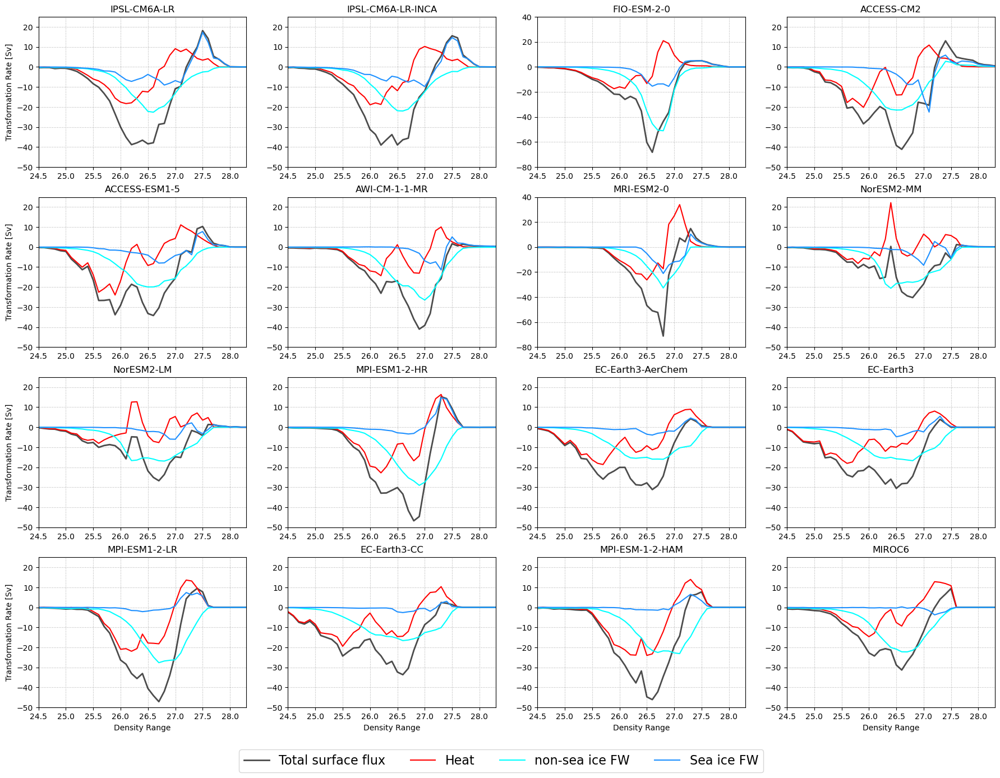

In [27]:


model_list_applied = model_list_fsi_rank
# model_list_applied = model_list_fsi
plots = plot_model_tr_in_density(model_list_applied, model_data, 
                                 include_mix = False, 
                                 include_sid = False, 
                                 include_melt = False, 
                                 include_form = False,
                                 y_lim=(-50, 25),
                                 x_lim=(24.5, 28.3),
                                )
plots.savefig('tr_in_density_cmip6',bbox_inches='tight')

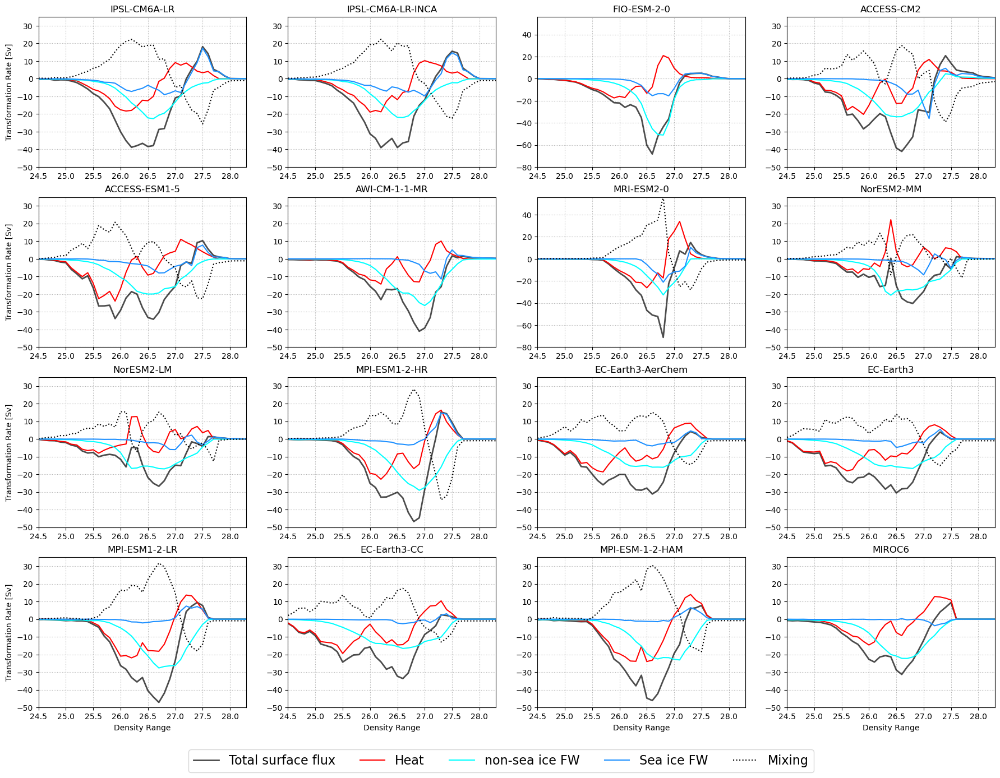

In [28]:


model_list_applied = model_list_fsi_rank
# model_list_applied = model_list_fsi
plots = plot_model_tr_in_density(model_list_applied, model_data, 
                                 include_mix = True, 
                                 include_sid = False, 
                                 include_melt = False, 
                                 include_form = False,
                                 y_lim=(-50, 35),
                                 x_lim=(24.5, 28.3),
                                )
plots.savefig('tr_in_density_with_mix_cmip6',bbox_inches='tight')

In [29]:

# Create an empty DataFrame to store the data
df = pd.DataFrame()

# Iterate over each model and get the fsi_tr_in_density values
for model in model_list_fsi_rank:
    data = model_data[model]
    fsi_tr_in_density = data['total_tr_in_density']
    fsi_tr_in_density_values = fsi_tr_in_density.values/12
    
    # Add the values to the DataFrame with the model name as the column header
    df[model] = fsi_tr_in_density_values

# Save the DataFrame to an Excel file
df.to_excel('total_tr_in_density_values.xlsx', index=False)


In [30]:

# Create an empty DataFrame to store the data
df = pd.DataFrame()

# Iterate over each model and get the fsi_tr_in_density values
for model in model_list_fsi_rank:
    data = model_data[model]
    fsi_form_tr_in_density = model_data[model]['fsi_form_tr_in_density']
    fsi_form_tr_in_density_values = fsi_form_tr_in_density.values/12
    fsi_melt_tr_in_density = model_data[model]['fsi_melt_tr_in_density']
    fsi_melt_tr_in_density_values = fsi_melt_tr_in_density.values/12
    # Add the values to the DataFrame with the model name as the column header
    df[model + 'form'] = fsi_form_tr_in_density_values
    df[model + 'melt'] = fsi_melt_tr_in_density_values
    

# Save the DataFrame to an Excel file
df.to_excel('fsi_form_melt_tr_in_density_values.xlsx', index=False)

### Annual mean

In [31]:
# model_list_applied = model_list_fsi_rank
# plots = plot_model_tr_in_density_annual(model_list_applied, model_data, x_lim=(26.2, 28.2), y_lim=(-60, 10),
#                                         include_mix = False,
#                                         include_sid = False,
#                                         include_melt = False,
#                                         include_form = False)

In [32]:

# # Create an empty DataFrame to store the data
# df = pd.DataFrame()

# # Iterate over each model and get the fsi_tr_in_density values
# for model in model_list_fsi_rank:
#     data = model_data[model]
#     fsi_tr_in_density = data['total_tr_in_density_annual']
#     fsi_tr_in_density_values = fsi_tr_in_density.values
    
#     # Add the values to the DataFrame with the model name as the column header
#     df[model] = fsi_tr_in_density_values

# # Save the DataFrame to an Excel file
# df.to_excel('total_tr_in_density_annual.xlsx', index=False)


### Freeze and melt

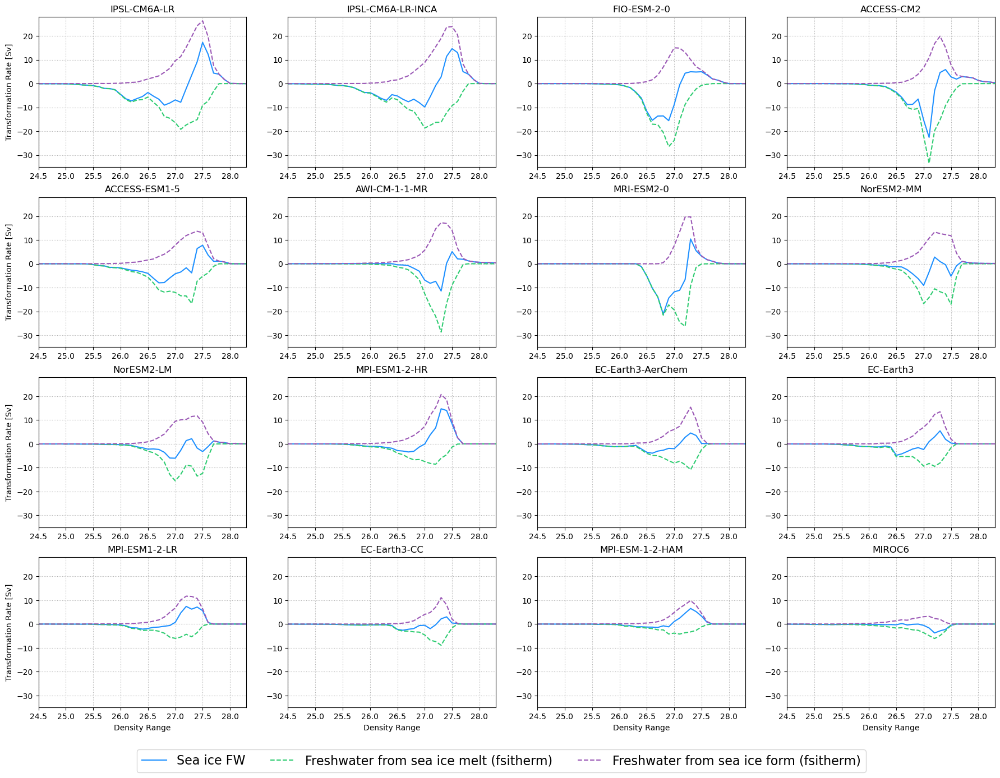

In [33]:

model_list_applied = model_list_fsi_rank
# model_list_applied = model_list_fsi
plots = plot_model_fm_tr_in_density(model_list_applied, model_data, 
                                 include_mix = False, 
                                 include_sid = False, 
                                 include_melt = True, 
                                 include_form = True,
                                 y_lim=(-35, 28),
                                 x_lim=(24.5, 28.3),
                                )
# plots.savefig('tr_in_density_cmip6',bbox_inches='tight')

## Plot the sea ice volume of melting and forming

In [34]:
mf_sid_models = []; sid_melt = []; sid_form = []
mf_fsi_models = []; fsi_melt = []; fsi_form = []
mf_sif_models = []; sif_melt = []; sif_form = []
wfo_sum_list = []
epr_sum_list = []
hfds_sum_list = []



for model in model_list_fsi_rank:
    data = model_data[model]
    
    if 'fsi_melt' in data:
        mf_fsi_models.append(model)
        fsi_melt.append(data['fsi_melt'])
        fsi_form.append(data['fsi_form'])
        wfo_sum_list.append(data['wfo_sum'])
        epr_sum_list.append(data['epr_sum'])
        hfds_sum_list.append(data['hfds_sum'])
        

    if 'sid_melt' in data:
        mf_sid_models.append(model)
        sid_melt.append(data['sid_melt'])
        sid_form.append(data['sid_form'])
        
    if 'sif_melt' in data:
        mf_sif_models.append(model)
        sif_melt.append(data['sif_melt'])
        sif_form.append(data['sif_form'])

In [35]:
fsi_melt

[0.7594200746666666,
 0.7469773653333333,
 0.625806464,
 0.588065792,
 0.5437844906666667,
 0.4939083912518542,
 0.5695096746666667,
 0.461468928,
 0.44380539733333335,
 0.286350464,
 0.31445098666666665,
 0.308624576,
 0.2008610133333333,
 0.205609984,
 0.144304416,
 0.15461493333333334]

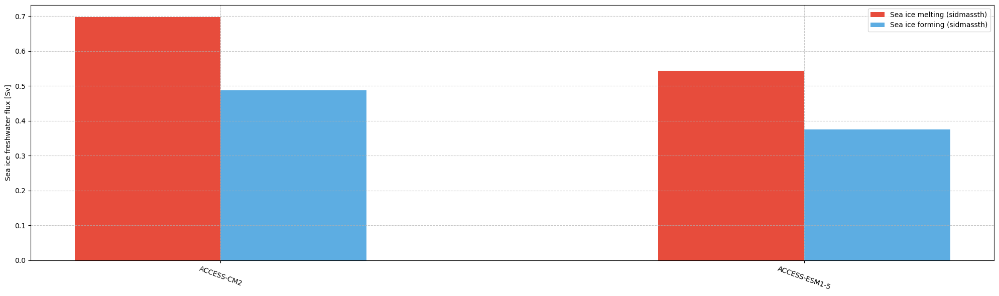

In [36]:
# Bar plot
bar_width = 0.25
bar_positions = range(len(mf_sif_models))

fig, ax = plt.subplots(figsize = (20,6))
        
bar1 = ax.bar([pos + 0*bar_width for pos in bar_positions], sif_melt, bar_width, label='Sea ice melting (sidmassth)',color = '#E74C3C')
bar2 = ax.bar([pos + 1*bar_width for pos in bar_positions], sif_form, bar_width, label='Sea ice forming (sidmassth)', color = '#5DADE2')

ax.set_xticks([pos + .5 * bar_width for pos in bar_positions])
ax.set_xticklabels(mf_sif_models, rotation=-20, ha='center') 
ax.legend()

# plt.xlabel('Model')
plt.ylabel('Sea ice freshwater flux [Sv]')
# plt.title('Fresh and Dense Values for Each Model')
plt.grid(linestyle = '--', alpha = 0.7)
plt.tight_layout() 

plt.show()

In [37]:
hfds_sum_list

[-42193669237418.664,
 -68405004599296.0,
 -259752486152874.66,
 -68145293295616.0,
 -90382665427626.67,
 64780527339081.81,
 -256467261194240.0,
 -360213605515264.0,
 -307227309812394.7,
 -11830532156074.666,
 132950466581845.33,
 189421322939050.66,
 15297018156373.334,
 186811571066197.34,
 41664610915669.336,
 -184662432066218.66]

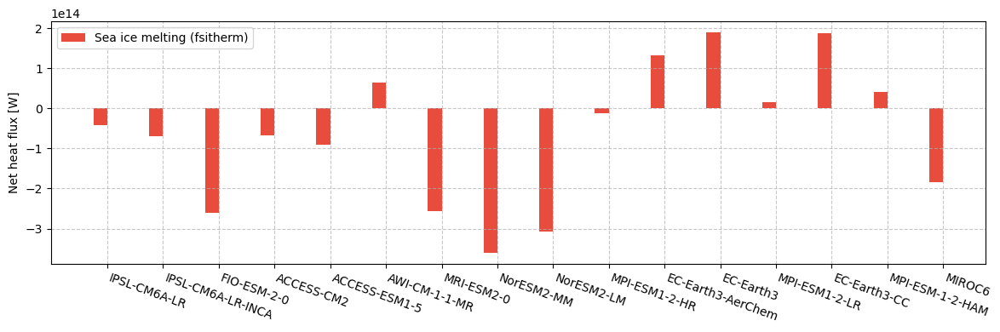

In [38]:
# Bar plot
bar_width = 0.25
bar_positions = range(len(mf_fsi_models))

fig, ax = plt.subplots(figsize = (12,4))
        
bar1 = ax.bar([pos + 0*bar_width for pos in bar_positions], hfds_sum_list, bar_width, label='Sea ice melting (fsitherm)',color = '#E74C3C')
# bar2 = ax.bar([pos + 1*bar_width for pos in bar_positions], fsi_form, bar_width, label='Sea ice freezing (fsitherm)', color = '#5DADE2')

ax.set_xticks([pos + .5 * bar_width for pos in bar_positions])
ax.set_xticklabels(mf_fsi_models, rotation=-20, ha='left') 
ax.legend()

# plt.xlabel('Model')
plt.ylabel('Net heat flux [W]')
# plt.title('Fresh and Dense Values for Each Model')
plt.grid(linestyle = '--', alpha = 0.7)
plt.tight_layout() 

plt.show()

In [39]:
mean_value_melt = np.mean(fsi_melt)
std_deviation_melt = np.std(fsi_melt)

# Print the mean and standard deviation of fsi_melt
print("Mean of FSI melt:", mean_value_melt)
print("Standard Deviation of FSI melt:", std_deviation_melt)

Mean of FSI melt: 0.4279726844532409
Standard Deviation of FSI melt: 0.1966849764622976


In [40]:
mean_value_form = np.mean(fsi_form)
std_deviation_form = np.std(fsi_form)

# Print the mean and standard deviation of fsi_form
print("Mean of FSI Form:", mean_value_form)
print("Standard Deviation of FSI Form:", std_deviation_form)

Mean of FSI Form: 0.32943657878181176
Standard Deviation of FSI Form: 0.13269565853731968


In [41]:
mean_value_form = np.mean(wfo_sum_list)
std_deviation_form = np.std(wfo_sum_list)

# Print the mean and standard deviation of wfo_sum_list
print("Mean of wfo :", mean_value_form)
print("Standard Deviation of wfo:", std_deviation_form)

Mean of wfo : 1.064878343059484
Standard Deviation of wfo: 0.12773658549109823


In [42]:
mean_value_form = np.mean(epr_sum_list)
std_deviation_form = np.std(epr_sum_list)

# Print the mean and standard deviation of epr_sum_list
print("Mean of wfo :", mean_value_form)
print("Standard Deviation of wfo:", std_deviation_form)

Mean of wfo : 0.9386427987219617
Standard Deviation of wfo: 0.1576062080058121


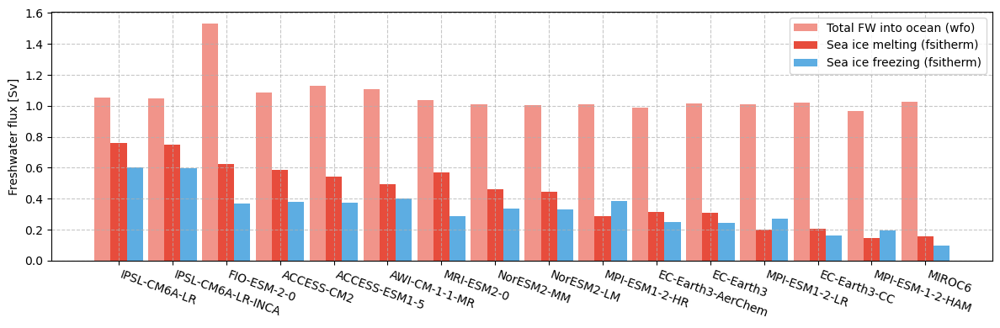

In [43]:
# Bar plot
bar_width = 0.30
bar_positions = range(len(mf_fsi_models))

fig, ax = plt.subplots(figsize = (12,4))

# bar1 = ax.bar([pos + 0 *bar_width for pos in bar_positions], epr_sum_list, bar_width, label='Freshwater flux from land and atmosphere', color = '#F1948A')
bar1 = ax.bar([pos + 0 *bar_width for pos in bar_positions], wfo_sum_list, bar_width, label='Total FW into ocean (wfo)', color = '#F1948A')
bar2 = ax.bar([pos + 1*bar_width for pos in bar_positions], fsi_melt, bar_width, label='Sea ice melting (fsitherm)',color = '#E74C3C')
bar3 = ax.bar([pos + 2*bar_width for pos in bar_positions], fsi_form, bar_width, label='Sea ice freezing (fsitherm)', color = '#5DADE2')


ax.set_xticks([pos + 1 * bar_width for pos in bar_positions])
ax.set_xticklabels(mf_fsi_models, rotation=-20, ha='left') 
ax.legend()

# plt.xlabel('Model')
plt.ylabel('Freshwater flux [Sv]')
# plt.title('Fresh and Dense Values for Each Model')
plt.grid(linestyle = '--', alpha = 0.7)
plt.tight_layout() 
plt.savefig('melt_and_form.png')
plt.show()

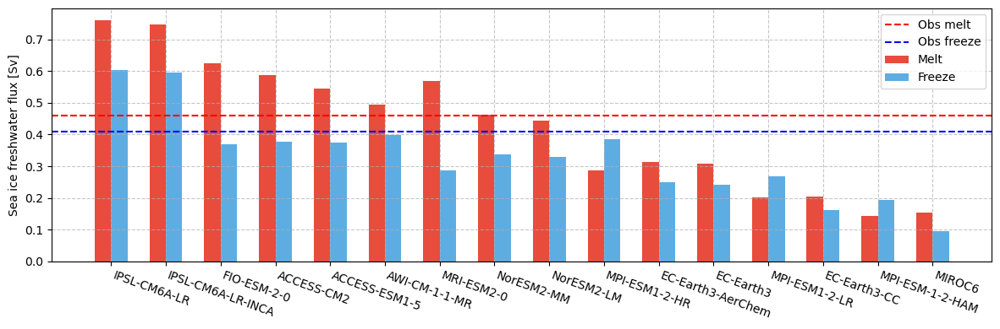

In [44]:
# Bar plot
bar_width = 0.30
bar_positions = range(len(mf_fsi_models))
freeze_value = 0.41
melt_value = 0.46
freeze_uncertainty = 0.11
melt_uncertainty = 0.10


fig, ax = plt.subplots(figsize = (12,4))
        
bar1 = ax.bar([pos + 0*bar_width for pos in bar_positions], fsi_melt, bar_width, label='Melt',color = '#E74C3C')
bar2 = ax.bar([pos + 1*bar_width for pos in bar_positions], fsi_form, bar_width, label='Freeze', color = '#5DADE2')
# bar2 = ax.bar([pos + 2.1*bar_width for pos in bar_positions], wfo_sum_list, bar_width, label='Non-seaice water flux', color = '#27AE60')


ax.set_xticks([pos + .5 * bar_width for pos in bar_positions])
ax.set_xticklabels(mf_fsi_models, rotation=-20, ha='left') 

# Adding a horizontal line for the reference value
ax.axhline(melt_value, color='r', linestyle='--', linewidth=1.5, label=f'Obs melt')

ax.axhline(freeze_value, color='b', linestyle='--', linewidth=1.5, label='Obs freeze')



# Adding the uncertainty band
# ax.fill_between([-0.5, len(mf_fsi_models) - 0.5], 
#                 freeze_value - freeze_uncertainty, 
#                 freeze_value + freeze_uncertainty, 
#                 color='b', alpha=0.1)#, label=f'Uncertainty (±{freeze_uncertainty:.2f})')
# ax.fill_between([-0.5, len(mf_fsi_models) - 0.5], 
#                 melt_value - melt_uncertainty, 
#                 melt_value + melt_uncertainty, 
#                 color='r', alpha=0.1)

ax.legend()

# plt.xlabel('Model')
plt.ylabel('Sea ice freshwater flux [Sv]')
# plt.title('Fresh and Dense Values for Each Model')
plt.grid(linestyle = '--', alpha = 0.7)
plt.tight_layout() 
# plt.savefig('melt_and_form.png')
plt.show()
fig.savefig('melt_and_form.png')


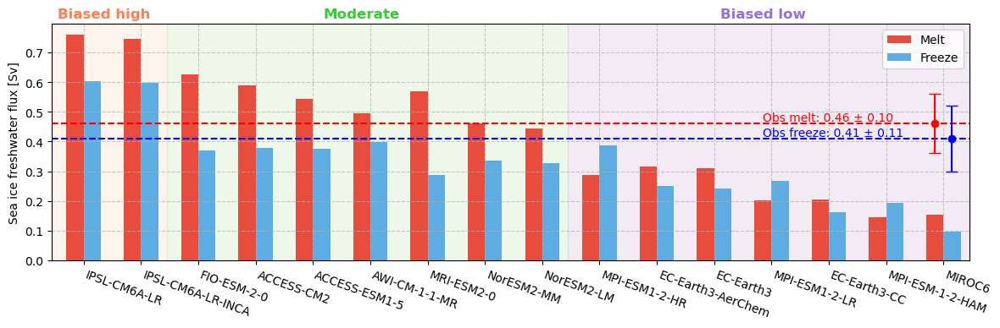

In [45]:

# Pre-defined reference values and uncertainties
freeze_value = 0.41
melt_value = 0.46
freeze_uncertainty = 0.11
melt_uncertainty = 0.10

# Group classifications (for example, dividing into 3 groups)
group_boundaries = [(0, 1), (2, 8), (9, 15)]  # Define the start and end indices for each group
# group_colors = ['#F0E68C', '#D3D3D3', '#ADD8E6']  # Colors for shading
group_colors = ['#FFDDC1', '#C4E8B7', '#D8BFD8']  # Improved colors for shading
group_labels = ['Biased high', 'Moderate', 'Biased low']  # Labels for each group
label_colors = ['#FF7F50', '#32CD32', '#9370DB'] 

# Plotting
bar_width = 0.30
bar_positions = range(len(mf_fsi_models))

fig, ax = plt.subplots(figsize=(12, 4))

# Adding shaded regions to indicate groups
for i, (start, end) in enumerate(group_boundaries):
    ax.axvspan(start - 0.4, end + 0.6, color=group_colors[i], alpha=0.3)

    # Adding group labels
    mid_point = (start + end) / 2  # Calculate the middle of the group for label placement
    ax.text(mid_point, max(fsi_melt + fsi_form) + 0.07, group_labels[i], 
            ha='center', va='center', fontsize=12, fontweight='bold', color=label_colors[i])
# Creating bars for melting and freezing
bar1 = ax.bar([pos + 0 * bar_width for pos in bar_positions], fsi_melt, bar_width, label='Melt', color='#E74C3C')
bar2 = ax.bar([pos + 1 * bar_width for pos in bar_positions], fsi_form, bar_width, label='Freeze', color='#5DADE2')

# Setting the x-axis ticks and labels
ax.set_xticks([pos + 0.5 * bar_width for pos in bar_positions])
ax.set_xticklabels(mf_fsi_models, rotation=-20, ha='left') 

# Adding horizontal lines for the reference values
ax.axhline(melt_value, color='r', linestyle='--', linewidth=1.5)
ax.axhline(freeze_value, color='b', linestyle='--', linewidth=1.5)

# Adding error bars to the reference lines to represent uncertainty
ax.errorbar(x=len(mf_fsi_models)-1, y=melt_value, yerr=melt_uncertainty, fmt='o', color='r', capsize=5)
ax.errorbar(x=len(mf_fsi_models) - 0.7, y=freeze_value, yerr=freeze_uncertainty, fmt='o', color='b', capsize=5)

# Adding text annotations for reference values and uncertainties
ax.text(len(mf_fsi_models) - 4, melt_value + 0.02, f'Obs melt: {melt_value} ± {melt_uncertainty:.2f}', color='r', fontsize=10, va='center')
ax.text(len(mf_fsi_models) - 4, freeze_value + 0.02, f'Obs freeze: {freeze_value} ± {freeze_uncertainty}', color='b', fontsize=10, va='center')

# Setting labels, legend, and grid
ax.set_ylabel('Sea ice freshwater flux [Sv]')
ax.set_xlim(-0.4, 15.6)
ax.legend()
ax.grid(linestyle='--', alpha=0.7)
plt.tight_layout()
fig.savefig('melt_and_form.png')

# Displaying and saving the plot
plt.show()


In [46]:
##======Sorting model
list2 = [x + y for x,y in zip(fsi_melt, fsi_form)]
# Combine model_list and data_list into pairs
combined_list = list(zip(mf_fsi_models, list2))

# Sort the combined list by the values in data_list (in descending order)
sorted_combined_list = sorted(combined_list, key=lambda x: x[1], reverse=True)

# Unzip the sorted list to get back the sorted model_list and data_list
sorted_model_list, sorted_data_list = zip(*sorted_combined_list)

print("Sorted Model List:", sorted_model_list)
print("Sorted Data List:", sorted_data_list)


Sorted Model List: ('IPSL-CM6A-LR', 'IPSL-CM6A-LR-INCA', 'FIO-ESM-2-0', 'ACCESS-CM2', 'ACCESS-ESM1-5', 'AWI-CM-1-1-MR', 'MRI-ESM2-0', 'NorESM2-MM', 'NorESM2-LM', 'MPI-ESM1-2-HR', 'EC-Earth3-AerChem', 'EC-Earth3', 'MPI-ESM1-2-LR', 'EC-Earth3-CC', 'MPI-ESM-1-2-HAM', 'MIROC6')
Sorted Data List: (1.3633751893333335, 1.3434268586666667, 0.9947353173333333, 0.9659194453333333, 0.9195437226666667, 0.8928880090941756, 0.8572960213333334, 0.797931776, 0.7721744853333334, 0.6725711360000001, 0.5633535573333333, 0.5513584853333333, 0.4692649173333333, 0.36747415466666666, 0.337007968, 0.250227168)


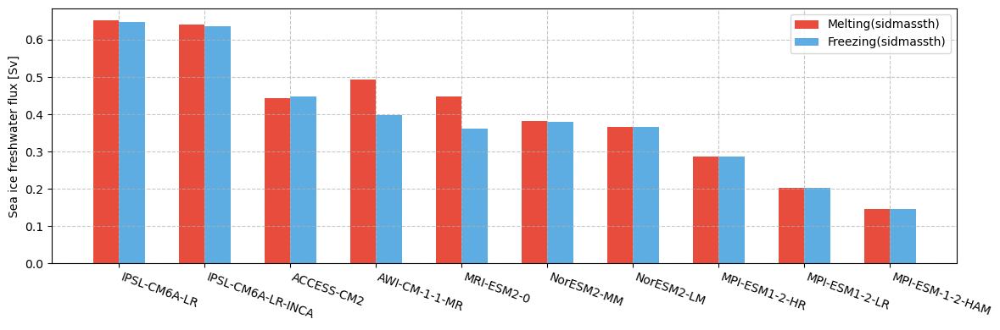

In [47]:
# Bar plot
bar_width = 0.30
bar_positions = range(len(mf_sid_models))

fig, ax = plt.subplots(figsize = (12,4))
        
bar1 = ax.bar([pos + 0*bar_width for pos in bar_positions], sid_melt, bar_width, label='Melting(sidmassth)',color = '#E74C3C')
bar2 = ax.bar([pos + 1*bar_width for pos in bar_positions], sid_form, bar_width, label='Freezing(sidmassth)', color = '#5DADE2')
# bar2 = ax.bar([pos + 2.1*bar_width for pos in bar_positions], wfo_sum_list, bar_width, label='Non-seaice water flux', color = '#27AE60')


ax.set_xticks([pos + .5 * bar_width for pos in bar_positions])
ax.set_xticklabels(mf_sid_models, rotation=-20, ha='left') 
ax.legend()

# plt.xlabel('Model')
plt.ylabel('Sea ice freshwater flux [Sv]')
# plt.title('Fresh and Dense Values for Each Model')
plt.grid(linestyle = '--', alpha = 0.7)
plt.tight_layout() 
plt.savefig('melt_and_form_.png')
plt.show()
# fig.savefig('melt_and_form.png')


In [48]:
# # Bar plot
# bar_width = 0.25
# bar_positions = range(len(model_list_sid_fsi))

# fig, ax = plt.subplots(figsize = (20,6))

# bar1 = ax.bar([pos + 0*bar_width for pos in bar_positions], sid_melting, bar_width, label='Sea ice melting (sidmassth)',color = '#E74C3C')
# bar2 = ax.bar([pos + 1*bar_width for pos in bar_positions], sid_form, bar_width, label='Sea ice forming (sidmassth)', color = '#5DADE2' )
# # bar3 = ax.bar([pos + 0*bar_width for pos in bar_positions], sid_annual_melting, bar_width, label='Transported melting (sidmassth)',color = '#922B21')
# # bar4 = ax.bar([pos + 1*bar_width for pos in bar_positions], sid_annual_form, bar_width, label='Transported forming (sidmassth)', color = '#2874A6' )
# bar3 = ax.bar([pos + 0*bar_width for pos in bar_positions], [x - y for x, y in zip( sid_melting,sid_annual_melting)], bar_width, label='Untransported melting (sidmassth)',color = '#922B21')
# bar4 = ax.bar([pos + 1*bar_width for pos in bar_positions], [x - y for x, y in zip( sid_form,sid_annual_form)], bar_width, label='Untransported forming (sidmassth)', color = '#2874A6' )
# ax.set_xticks([pos + .5 * bar_width for pos in bar_positions])
# ax.set_xticklabels(model_list_sid_fsi, rotation=-20, ha='center') 
# ax.legend()

# # plt.xlabel('Model')
# plt.ylabel('Sea ice freshwater flux [Sv]')
# # plt.title('Fresh and Dense Values for Each Model')
# plt.grid(linestyle = '--', alpha = 0.7)
# plt.tight_layout() 

# plt.show()

In [49]:
# xr.Dataset(fsi_annual_melting)
len(fsi_form)

16

In [50]:
# len(fsi_annual_melting)

In [51]:
model_list_fsi

['ACCESS-CM2',
 'ACCESS-ESM1-5',
 'AWI-CM-1-1-MR',
 'CMCC-CM2-SR5',
 'CMCC-ESM2',
 'EC-Earth3',
 'EC-Earth3-AerChem',
 'EC-Earth3-CC',
 'FIO-ESM-2-0',
 'IPSL-CM6A-LR',
 'IPSL-CM6A-LR-INCA',
 'MIROC6',
 'MPI-ESM-1-2-HAM',
 'MPI-ESM1-2-HR',
 'MPI-ESM1-2-LR',
 'MRI-ESM2-0',
 'NorESM2-LM',
 'NorESM2-MM']

In [52]:
fsi_annual_melt_list = []
fsi_annual_freeze_list = []

for model in mf_fsi_models:
    data = model_data[model]
    lat_key = data['lat_key']    
    # sid_mean_mon = data['sid_mean_mon']
    fsi_mean_mon = data['fsi_mean_mon']
    
    grid_area = data['grid_area']
    # sid_mean_mon = sid_mean_mon.where(sid_mean_mon[lat_key] < -45)
    fsi_mean_mon = fsi_mean_mon.where(fsi_mean_mon[lat_key] < -45)
    fsi_mean_annual = fsi_mean_mon.mean('month')

    fsi_mean_mon_annual_weighted = fsi_mean_mon * grid_area #* month_weights
    fsi_mean_annual_weighted = fsi_mean_annual * grid_area 
    
    # fsi_fresh = (fsi_mean_mon_annual_weighted.where(fsi_mean_mon_annual_weighted > 0).sum() / 1e9 / 12).item()
    # fsi_melt = (fsi_mean_mon_annual_weighted.where(fsi_mean_mon_annual_weighted < 0).sum() / 1e9 / 12).item()
    fsi_annual_melt = (fsi_mean_annual_weighted.where(fsi_mean_annual_weighted > 0).sum() / 1e9 ).item()
    fsi_annual_freeze = (fsi_mean_annual_weighted.where(fsi_mean_annual_weighted < 0).sum() / 1e9 ).item()

    fsi_annual_melt_list.append(fsi_annual_melt)
    fsi_annual_freeze_list.append(-fsi_annual_freeze)

In [53]:
fsi_annual_freeze_list

[0.239174256,
 0.235674144,
 0.132540128,
 0.143301968,
 0.150219504,
 0.18190543962946693,
 0.062021604,
 0.184569488,
 0.206459328,
 0.099901688,
 0.104969608,
 0.107990328,
 0.067563544,
 0.075112232,
 0.048417592,
 0.049007752]

In [54]:
ratio = np.array(fsi_annual_freeze_list)/ np.array(fsi_form) 
# Creating a DataFrame for models and their ratios
data = {
    'Model': mf_fsi_models,
    'Ratio (Form/Annual Freeze)': ratio
}

df_models_ratio = pd.DataFrame(data)

# Display the DataFrame
print(df_models_ratio)

                Model  Ratio (Form/Annual Freeze)
0        IPSL-CM6A-LR                    0.396013
1   IPSL-CM6A-LR-INCA                    0.395128
2         FIO-ESM-2-0                    0.359257
3          ACCESS-CM2                    0.379253
4       ACCESS-ESM1-5                    0.399776
5       AWI-CM-1-1-MR                    0.455927
6          MRI-ESM2-0                    0.215513
7          NorESM2-MM                    0.548558
8          NorESM2-LM                    0.628742
9       MPI-ESM1-2-HR                    0.258665
10  EC-Earth3-AerChem                    0.421730
11          EC-Earth3                    0.444892
12      MPI-ESM1-2-LR                    0.251723
13       EC-Earth3-CC                    0.464045
14    MPI-ESM-1-2-HAM                    0.251254
15             MIROC6                    0.512568


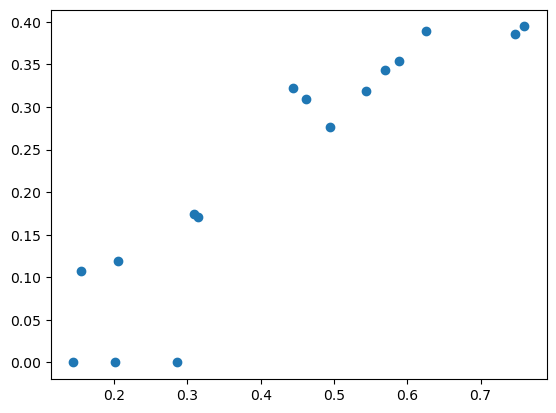

In [55]:
plt.scatter(fsi_melt,fsi_annual_melt_list)

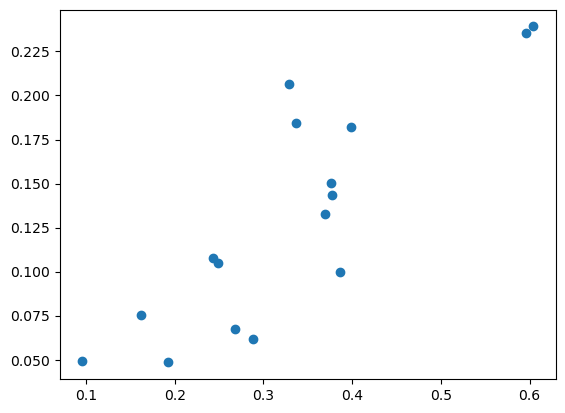

In [56]:
plt.scatter(fsi_form,fsi_annual_freeze_list)

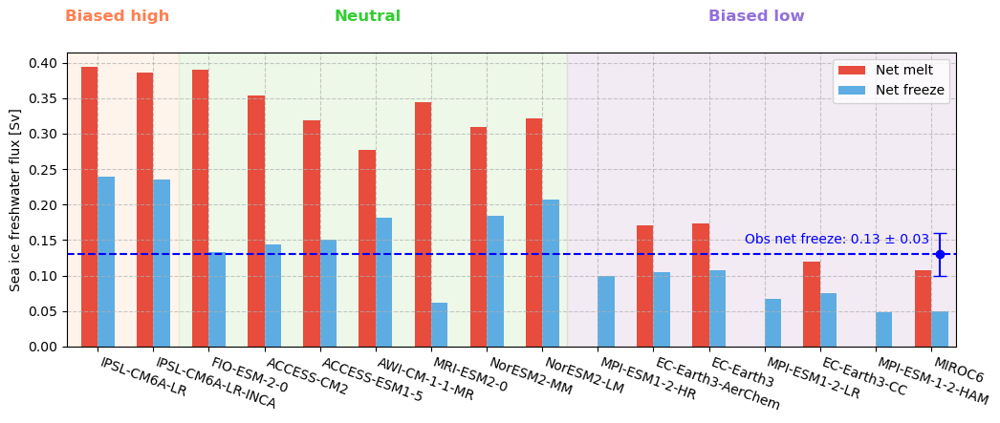

In [57]:

# Pre-defined reference values and uncertainties
net_freeze_value = 0.13
# melt_value = 0.46
net_freeze_uncertainty = 0.03
# melt_uncertainty = 0.10

# Group classifications (for example, dividing into 3 groups)
group_boundaries = [(0, 1), (2, 8), (9, 15)]  # Define the start and end indices for each group
# group_colors = ['#F0E68C', '#D3D3D3', '#ADD8E6']  # Colors for shading
group_colors = ['#FFDDC1', '#C4E8B7', '#D8BFD8']  # Improved colors for shading
group_labels = ['Biased high', 'Neutral', 'Biased low']  # Labels for each group
label_colors = ['#FF7F50', '#32CD32', '#9370DB'] 

# Plotting
bar_width = 0.30
bar_positions = range(len(mf_fsi_models))

fig, ax = plt.subplots(figsize=(12, 4))

# Adding shaded regions to indicate groups
for i, (start, end) in enumerate(group_boundaries):
    ax.axvspan(start - 0.4, end + 0.6, color=group_colors[i], alpha=0.3)

    # Adding group labels
    mid_point = (start + end) / 2  # Calculate the middle of the group for label placement
    ax.text(mid_point, max(fsi_annual_melt_list + fsi_annual_freeze_list) + 0.07, group_labels[i], 
            ha='center', va='center', fontsize=12, fontweight='bold', color=label_colors[i])
# Creating bars for melting and freezing
bar1 = ax.bar([pos + 0 * bar_width for pos in bar_positions], fsi_annual_melt_list, bar_width, label='Net melt', color='#E74C3C')
bar2 = ax.bar([pos + 1 * bar_width for pos in bar_positions], fsi_annual_freeze_list, bar_width, label='Net freeze', color='#5DADE2')

# Setting the x-axis ticks and labels
ax.set_xticks([pos + 0.5 * bar_width for pos in bar_positions])
ax.set_xticklabels(mf_fsi_models, rotation=-20, ha='left') 

# # Adding horizontal lines for the reference values
# ax.axhline(melt_value, color='r', linestyle='--', linewidth=1.5)
ax.axhline(net_freeze_value, color='b', linestyle='--', linewidth=1.5)

# # Adding error bars to the reference lines to represent uncertainty
# ax.errorbar(x=len(mf_fsi_models)-1, y=melt_value, yerr=melt_uncertainty, fmt='o', color='r', capsize=5)
ax.errorbar(x=len(mf_fsi_models) - 0.7, y=net_freeze_value, yerr=net_freeze_uncertainty, fmt='o', color='b', capsize=5)

# # Adding text annotations for reference values and uncertainties
# ax.text(len(mf_fsi_models) - 4, melt_value + 0.02, f'Obs melt: {melt_value} ± {melt_uncertainty}', color='r', fontsize=10, va='center')
ax.text(len(mf_fsi_models) - 4.2, net_freeze_value + 0.02, f'Obs net freeze: {net_freeze_value} ± {net_freeze_uncertainty}', color='b', fontsize=10, va='center')

# Setting labels, legend, and grid
ax.set_ylabel('Sea ice freshwater flux [Sv]')
ax.set_xlim(-0.4, 15.6)
ax.legend()
ax.grid(linestyle='--', alpha=0.7)
# plt.tight_layout()
# fig.savefig('melt_and_form.png')

# Displaying and saving the plot
plt.show()


In [58]:
# sid_melting = []
# sid_form = []
# fsi_melting = []
# fsi_form = []
# fsi_annual_melting = []
# fsi_annual_form = []
# # month_weights = xr.DataArray([31/365.25,28.25/365.25,31/365.25,30/365.25,31/365.25,30/365.25,31/365.25,31/365.25,30/365.25,31/365.25,30/365.25,31/365.25],
# #                             dims='month_weight',
# #                             coords={'month_weight': range(1, 13)})
# for model in model_list_fsi:
#     data = model_data[model]
#     lat_key = data['lat_key']    
#     # sid_mean_mon = data['sid_mean_mon']
#     fsi_mean_mon = data['fsi_mean_mon']
    
#     grid_area = data['grid_area']
#     # sid_mean_mon = sid_mean_mon.where(sid_mean_mon[lat_key] < -45)
#     fsi_mean_mon = fsi_mean_mon.where(fsi_mean_mon[lat_key] < -45)
#     fsi_mean_annual = fsi_mean_mon.mean('month')
    
    
#     # sid_mean_mon_annual_weighted = sid_mean_mon * grid_area #* month_weights
#     fsi_mean_mon_annual_weighted = fsi_mean_mon * grid_area #* month_weights
#     fsi_mean_annual_weighted = fsi_mean_annual * grid_area 
    

#     # Flag for CMCC, sea ice grid is inconsistant with ocean grid
#     # if 'CMCC' in model: 
#     #     fsi_mean_mon_annual_weighted = fsi_mean_mon * grid_area[:-1,1:-1]# * month_weights
#     #     fsi_mean_annual_weighted = fsi_mean_annual * grid_area[:-1,1:-1]

#     # sid_fresh = (sid_mean_mon_annual_weighted.where(sid_mean_mon_annual_weighted > 0).sum() / 1e9 / 12).item()
#     # sid_melt = (sid_mean_mon_annual_weighted.where(sid_mean_mon_annual_weighted < 0).sum() / 1e9 / 12).item()
#     fsi_fresh = (fsi_mean_mon_annual_weighted.where(fsi_mean_mon_annual_weighted > 0).sum() / 1e9 / 12).item()
#     fsi_melt = (fsi_mean_mon_annual_weighted.where(fsi_mean_mon_annual_weighted < 0).sum() / 1e9 / 12).item()
#     fsi_annual_fresh = (fsi_mean_annual_weighted.where(fsi_mean_annual_weighted > 0).sum() / 1e9 ).item()
#     fsi_annual_melt = (fsi_mean_annual_weighted.where(fsi_mean_annual_weighted < 0).sum() / 1e9 ).item()
    
#     # sid_melting.append(sid_fresh)
#     # sid_form.append(sid_melt)
#     fsi_melting.append(fsi_fresh)
#     fsi_form.append(fsi_melt)
#     fsi_annual_melting.append(fsi_annual_fresh)
#     fsi_annual_form.append(fsi_annual_melt)

# # Bar plot
# bar_width = 0.40
# bar_positions = range(len(model_list_fsi))

# fig, ax = plt.subplots(figsize=(8, 6))

# bar1 = ax.barh([pos + 0 * bar_width for pos in bar_positions], fsi_melting, bar_width, label='Sea ice melting ', color='#E74C3C')
# bar2 = ax.barh([pos + 1 * bar_width for pos in bar_positions], fsi_form, bar_width, label='Sea ice forming ', color='#5DADE2')
# bar3 = ax.barh([pos + 0 * bar_width for pos in bar_positions], [x - y for x, y in zip(fsi_melting, fsi_annual_melting)], bar_width, label='Untransported melting ', color='#922B21')
# bar4 = ax.barh([pos + 1 * bar_width for pos in bar_positions], [x - y for x, y in zip(fsi_form, fsi_annual_form)], bar_width, label='Untransported forming ', color='#2874A6')
# ax.set_yticks([pos + 1.5 * bar_width for pos in bar_positions])
# ax.set_yticklabels(model_list_fsi, 
#                    # rotation=-20, 
#                    ha='left')
# ax.legend()

# plt.xlabel('Sea ice freshwater flux [Sv]')
# plt.ylabel('Model')
# plt.grid(linestyle='--', alpha=0.7)
# plt.tight_layout()

# plt.show()


In [59]:
# # model_list_sif_fsi = ['ACCESS-CM2','ACCESS-ESM1-5']
# model_list_sif_fsi = ['ACCESS-CM2']

# sid_melting = []
# sid_form = []
# sif_melting = []
# sif_form = []
# fsi_melting = []
# fsi_form = []
# sif_annual_melting = []
# sif_annual_form = []
# # month_weights = xr.DataArray([31/365.25,28.25/365.25,31/365.25,30/365.25,31/365.25,30/365.25,31/365.25,31/365.25,30/365.25,31/365.25,30/365.25,31/365.25],
# #                             dims='month_weight',
# #                             coords={'month_weight': range(1, 13)})
# for model in model_list_sif_fsi:
#     data = model_data[model]
#     lat_key = data['lat_key']   
#     sid_mean_mon = data['sid_mean_mon']
#     sif_mean_mon = data['sif_mean_mon']
#     fsi_mean_mon = data['fsi_mean_mon']
    
#     grid_area = data['grid_area']
#     sid_mean_mon = sid_mean_mon.where(sid_mean_mon[lat_key] < -45)
#     sif_mean_mon = sif_mean_mon.where(sif_mean_mon[lat_key] < -45)
#     fsi_mean_mon = fsi_mean_mon.where(fsi_mean_mon[lat_key] < -45)
#     sif_mean_annual = sif_mean_mon.mean('month')
    
#     sid_mean_mon_annual_weighted = sid_mean_mon * grid_area #* month_weights
#     sif_mean_mon_annual_weighted = sif_mean_mon * grid_area #* month_weights
#     fsi_mean_mon_annual_weighted = fsi_mean_mon * grid_area #* month_weights
#     sif_mean_annual_weighted = sif_mean_annual * grid_area 
    

#     # Flag for CMCC, sea ice grid is inconsistant with ocean grid
#     if 'CMCC' in model: 
#         sid_mean_mon_annual_weighted = sid_mean_mon * grid_area[:-1,1:-1]# * month_weights
#         sid_mean_annual_weighted = sid_mean_annual * grid_area[:-1,1:-1]
        
#     sid_fresh = (sid_mean_mon_annual_weighted.where(sid_mean_mon_annual_weighted > 0).sum() / 1e9 / 12).item()
#     sid_melt = (sid_mean_mon_annual_weighted.where(sid_mean_mon_annual_weighted < 0).sum() / 1e9 / 12).item()
#     sif_fresh = (sif_mean_mon_annual_weighted.where(sif_mean_mon_annual_weighted > 0).sum() / 1e9 / 12).item()
#     sif_melt = (sif_mean_mon_annual_weighted.where(sif_mean_mon_annual_weighted < 0).sum() / 1e9 / 12).item()
#     fsi_fresh = (fsi_mean_mon_annual_weighted.where(fsi_mean_mon_annual_weighted > 0).sum() / 1e9 / 12).item()
#     fsi_melt = (fsi_mean_mon_annual_weighted.where(fsi_mean_mon_annual_weighted < 0).sum() / 1e9 / 12).item()
#     sif_annual_fresh = (sif_mean_annual_weighted.where(sif_mean_annual_weighted > 0).sum() / 1e9 ).item()
#     sif_annual_melt = (sif_mean_annual_weighted.where(sif_mean_annual_weighted < 0).sum() / 1e9 ).item()

#     sid_melting.append(abs(sid_fresh))
#     sid_form.append(abs(sid_melt))
#     sif_melting.append(abs(sif_fresh))
#     sif_form.append(abs(sif_melt))
#     fsi_melting.append(abs(fsi_fresh))
#     fsi_form.append(abs(fsi_melt))
#     sif_annual_melting.append(abs(sif_annual_fresh))
#     sif_annual_form.append(abs(sif_annual_melt))

# # Bar plot
# bar_width = 0.15
# bar_positions = range(len(model_list_sif_fsi))

# fig, ax = plt.subplots(figsize = (10,6))

# bar1 = ax.bar([pos + 0*bar_width for pos in bar_positions], fsi_melting, bar_width, label='Sea ice melting (fsitherm)',color = '#E74C3C')
# bar2 = ax.bar([pos + 1*bar_width for pos in bar_positions], fsi_form, bar_width, label='Sea ice freezing (fsitherm)', color = '#5DADE2' )
# bar3 = ax.bar([pos + 2.1*bar_width for pos in bar_positions], sid_melting, bar_width, label='Sea ice melting (sidmassth)',color = '#A569BD')
# bar4 = ax.bar([pos + 3.1*bar_width for pos in bar_positions], sid_form, bar_width, label='Sea ice freezing (sidmassth)', color = '#58D68D' )
# bar5 = ax.bar([pos + 4.2*bar_width for pos in bar_positions], sif_melting, bar_width, label='Sea ice melting (siflfwbot)',color = '#D68910')
# bar6 = ax.bar([pos + 5.2*bar_width for pos in bar_positions], sif_form, bar_width, label='Sea ice freezing (siflfwbot)', color = '#BA4A00' )
# # bar3 = ax.bar([pos + 2*bar_width for pos in bar_positions], ep_values, bar_width, label='Freshwater extraction',color = '#E74C3C' )
# for bars in [bar1, bar2, bar3, bar4, bar5, bar6]:
#     for bar in bars:
#         height = bar.get_height()
#         ax.text(bar.get_x() + bar.get_width() / 2, height, f'{height:.2f}', ha='center', va='bottom')

# ax.set_xticks([pos + 1.5 * bar_width for pos in bar_positions])
# ax.set_xticklabels(model_list_sif_fsi, rotation=-20, ha='center') 
# ax.legend()

# plt.xlabel('Model')
# plt.ylabel('Sea ice freshwater flux [Sv]')
# # plt.title('Fresh and Dense Values for Each Model')
# plt.grid(linestyle = '--', alpha = 0.7)

# # # Add text annotations on top of each bar
# # for i, (fresh, dense) in enumerate(zip(fresh_values, dense_values)):
# #     ax.text(i, fresh + 0.01, f'{fresh:.2f}', ha='center', va='bottom', color='black')
# #     ax.text(i + bar_width, dense + 0.01, f'{dense:.2f}', ha='center', va='bottom', color='black')

# plt.tight_layout() 

# plt.show()

## Plot of Density

In [60]:
def plot_density_map(model_list, model_data, map_variable, title=None):
    # Calculate the number of rows and columns for subplots
    fig_num = len(model_list)
    ncol = 4
    nrow = fig_num // ncol if fig_num % ncol == 0 else fig_num // ncol + 1

    # Create subplots with specified projection and size
    fig, axs = plt.subplots(nrows=nrow, ncols=ncol, figsize=(4.5*ncol, 4.7*nrow),
                            subplot_kw=dict(projection=ccrs.Orthographic(0, -90)))

    # Flatten axs to iterate over all subplots
    axs = axs.flatten()

    # Iterate over each model in model_list
    for index, model in enumerate(model_list):
        ax = axs[index]  # Get current axis
        data = model_data[model]  # Get data for the current model
        lon_key = data['lon_key']  # Longitude key
        lat_key = data['lat_key']  # Latitude key
        lat_edge = data['lat_edge']  # Latitude edge
        si_map = data[map_variable]  # Get map variable data for the current model
        si_map = si_map.mean('month')
        if 'AWI' in model:
            ax.scatter(x=si_map[lon_key], 
                        y=si_map[lat_key], 
                        c=si_map,  # Color based on fsi_values
                        cmap=cm.dense, 
                        transform=ccrs.PlateCarree(),
                        # ax = ax,
                        vmin=1026.8,  # Min value for color mapping
                        vmax=1028.0, # Max value for color mapping
                        s = 0.1)  

        else:
            # Plot si_map on the current axis
            fig1 = si_map.plot(x=lon_key, y=lat_key,
                               transform=ccrs.PlateCarree(),
                               levels=np.arange(1026.8, 1028.0, 0.2),
                               cmap = cm.dense,
                               add_colorbar=False,
                               ax=ax)
        
        if 'sic_mean_mon' in data:
            sic_sep = data['sic_mean_mon'].sel(month = 9)
            density = data['surface_density_mean_mon'].mean('month')
            
            if 'nearest_index' in data:
                nearest_index = data['nearest_index']  # Latitude edge
                sic_sorted = sic_sep.sortby(sic_sep[lon_key][nearest_index,:])
                den_sorted = density.sortby(density[lon_key][nearest_index,:])
                
            elif 'FIO' in model:
                nearest_index = 45  # Latitude edge
                sic_sorted = sic_sep.sortby(sic_sep[lon_key][nearest_index,:])
                den_sorted = density.sortby(density[lon_key][nearest_index,:])
                
            else:
                sic_sorted = sic_sep
                
            if 'MPI-ESM1-2-LR' in model_list[index]:
                sic_sorted =sic_sorted.sortby(sic_sorted[lon_key][nearest_index,:])
                sic_sorted =sic_sorted[:,4:-4]
                den_sorted = density.sortby(density[lon_key][nearest_index+25,:])
                den_sorted =den_sorted[:,4:-4]
                
            if 'MPI-ESM-1-2-HAM' in model_list[index]:
                sic_sorted =sic_sorted.sortby(sic_sorted[lon_key][nearest_index,:])
                den_sorted = density.sortby(density[lon_key][nearest_index + 25,:])
                sic_sorted =sic_sorted[:,4:-4]
                den_sorted =den_sorted[:,4:-4]
                
            if 'Nor' in model_list[index]:
                sic_sorted =sic_sorted.sortby(sic_sorted[lon_key][nearest_index - 20,:])
                den_sorted = density.sortby(density[lon_key][nearest_index - 20,:])
            if 'IPSL' in model:
                sic_sorted =sic_sorted.sortby(sic_sorted[lon_key][nearest_index,:])
                den_sorted = density.sortby(density[lon_key][nearest_index,:])  
                sic_sorted =sic_sorted[:,1:-1]
                den_sorted =den_sorted[:,1:-1]
            # ==Sea ice extent contour
            if 'AWI' in model:
                dd =0
                # density = density.where(density.lat< -45, 0).where(density.lat> -72, 99999)
                # # density = density.where(density < 1026.8.4)
                # contour = ax.tricontour(density.lon, density.lat, density, 
                #                 levels = np.arange(1026.8, 1028.0, 0.2),
                #                 transform=ccrs.PlateCarree(),
                #                 linestyles='dashed',
                #                 colors = 'k',
                #                 )
                # ax.clabel(contour, inline=True, fontsize=6, fmt='%1.1f')  # Customize fontsize and format as needed
                

                
            else:
                den_sorted = den_sorted.where(den_sorted[lat_key]< -45, 0)
                contour = den_sorted.plot.contour(x = lon_key, y=lat_key, 
                                          levels=np.arange(1026.8, 1028.0, 0.2),
                                          ax = ax,
                                          transform=ccrs.PlateCarree(),
                                          linestyles='dashed',
                                          colors = 'k',
                                          )       
                # Add in-line text labels
                ax.clabel(contour, inline=True, fontsize=6, fmt='%1.1f')  # Customize fontsize and format as needed
            
        # Add coastlines and gridlines
        ax.coastlines()
        ax.gridlines(linestyle=':', draw_labels=True)
        
        # Set the extent and add land feature
        ax.set_extent([-180, 180, -90, lat_edge], crs=ccrs.PlateCarree())
        ax.add_feature(cfeature.LAND, facecolor='lightgray')
        
        # Set the title for the current subplot
        ax.set_title(model)

        # Add solid line at 50°S latitude
        lon = np.linspace(-180, 180, 100)
        lat = np.full_like(lon, lat_edge)
        ax.plot(lon, lat, color='gray', linestyle='-', transform=ccrs.PlateCarree())

        # Set the boundary with a circle
        theta = np.linspace(0, 2*np.pi, 100)
        center, radius = [0.5, 0.5], 0.5
        verts = np.vstack([np.sin(theta), np.cos(theta)]).T
        circle = mpath.Path(verts * radius + center)
        ax.set_boundary(circle, transform=ax.transAxes)

    # Add colorbar
    cbar = fig.colorbar(fig1, ax=axs.ravel().tolist(), 
                        cax=fig.add_axes([0.2, 0.08, 0.6, 0.01]),
                        orientation='horizontal')
    cbar.set_label(f'W/m$^2$')
    cbar.set_ticks(np.arange(1026.8, 1028.0, 0.2))

    # Set figure title if provided
    if title:
        fig.suptitle(title, fontsize=16)
        
    # plt.tight_layout() 
    
    # Show the plot
    plt.show()
    return fig

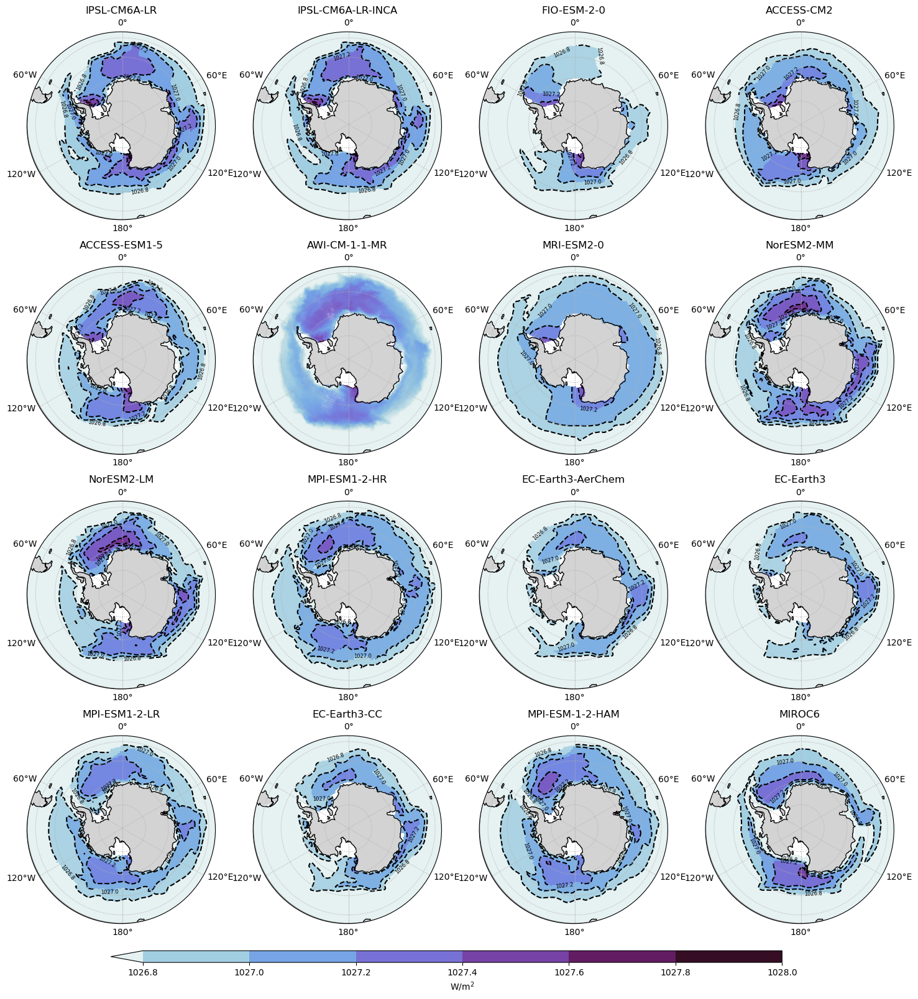

In [61]:
model_list_applied = model_list_fsi_rank
# model_list_applied = model_list_fsi
map_variable = 'surface_density_mean_mon'
plot_wfo_buo = plot_density_map(model_list_applied, model_data, map_variable)
plot_wfo_buo.savefig('plot_density_ensemble', bbox_inches='tight')

## Plot of buoyancy map

### Total freshwater

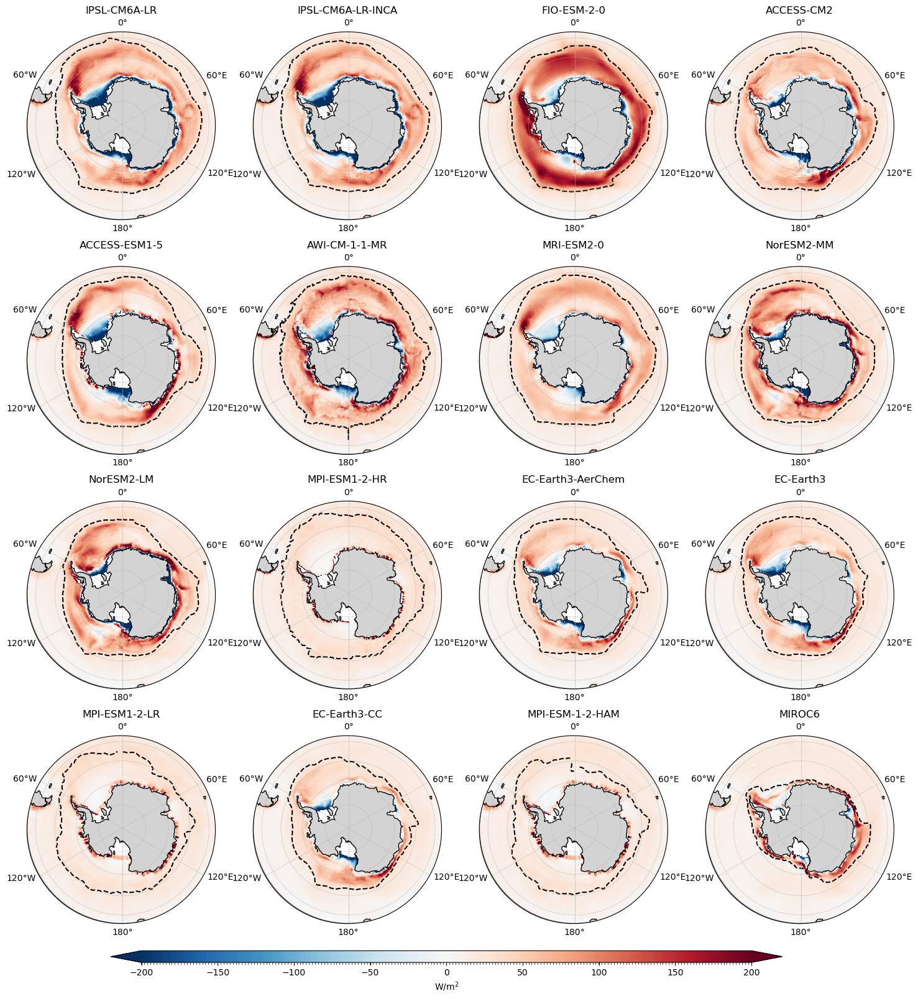

In [62]:
model_list_applied = model_list_fsi_rank
# model_list_applied = model_list_fsi
map_variable = 'buo_wfo_map'
plot_wfo_buo = plot_buo_map(model_list_applied, model_data, map_variable)
plot_wfo_buo.savefig('buo_map_wfo_cmip6', bbox_inches='tight')

### no-sea ice freshwater

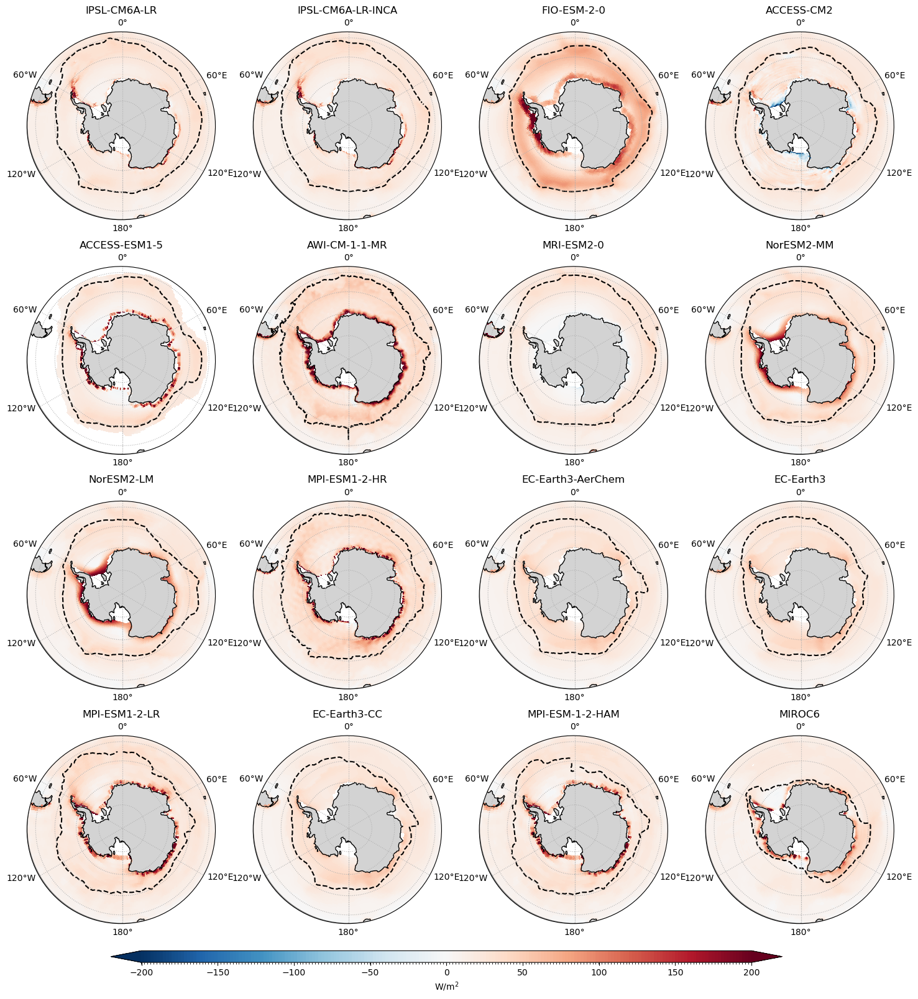

In [63]:
model_list_applied = model_list_fsi_rank
# model_list_applied = model_list_fsi
map_variable = 'buo_wfo_map'
plot_nosi_buo = plot_buo_map_no_si(model_list_applied, model_data, map_variable)
plot_nosi_buo.savefig('buo_map_non_si_cmip6', bbox_inches='tight')

### Total heat

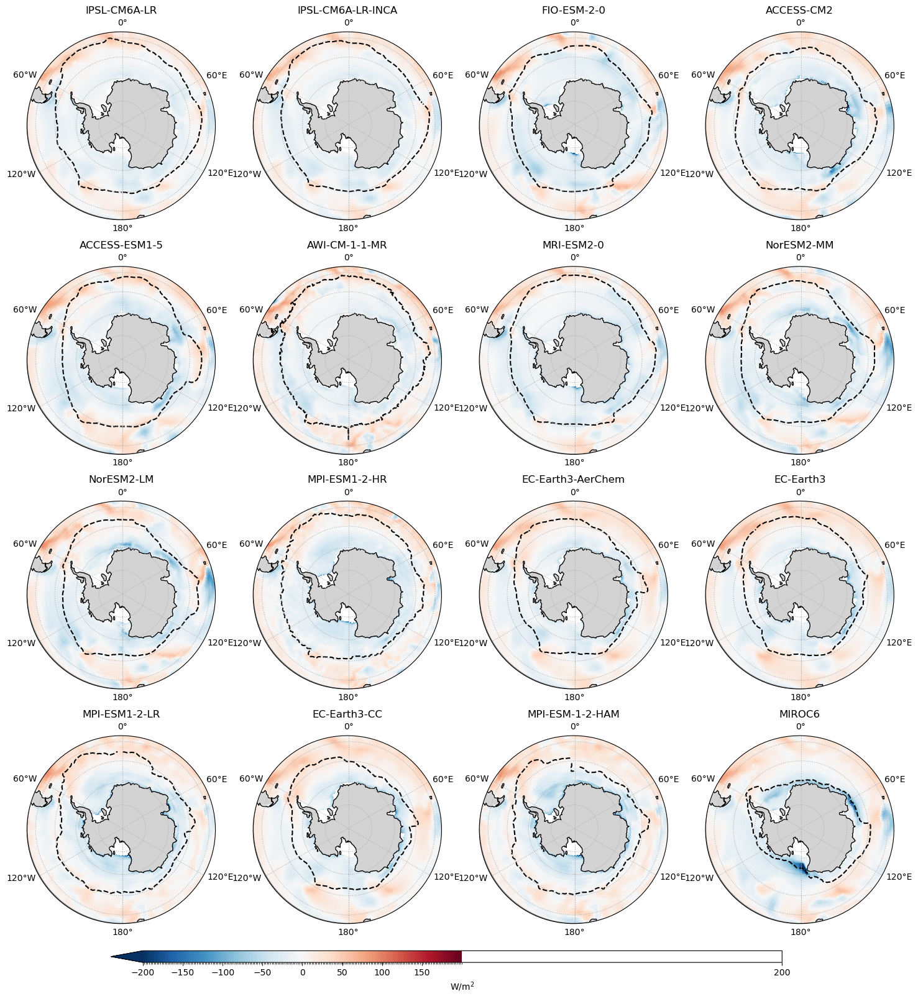

In [64]:
model_list_applied = model_list_fsi_rank
map_variable = 'buo_hfds_map'
plots = plot_buo_map(model_list_applied, model_data, map_variable)
plots.savefig('buo_map_hfds_cmip6',bbox_inches='tight')

### Sea ice

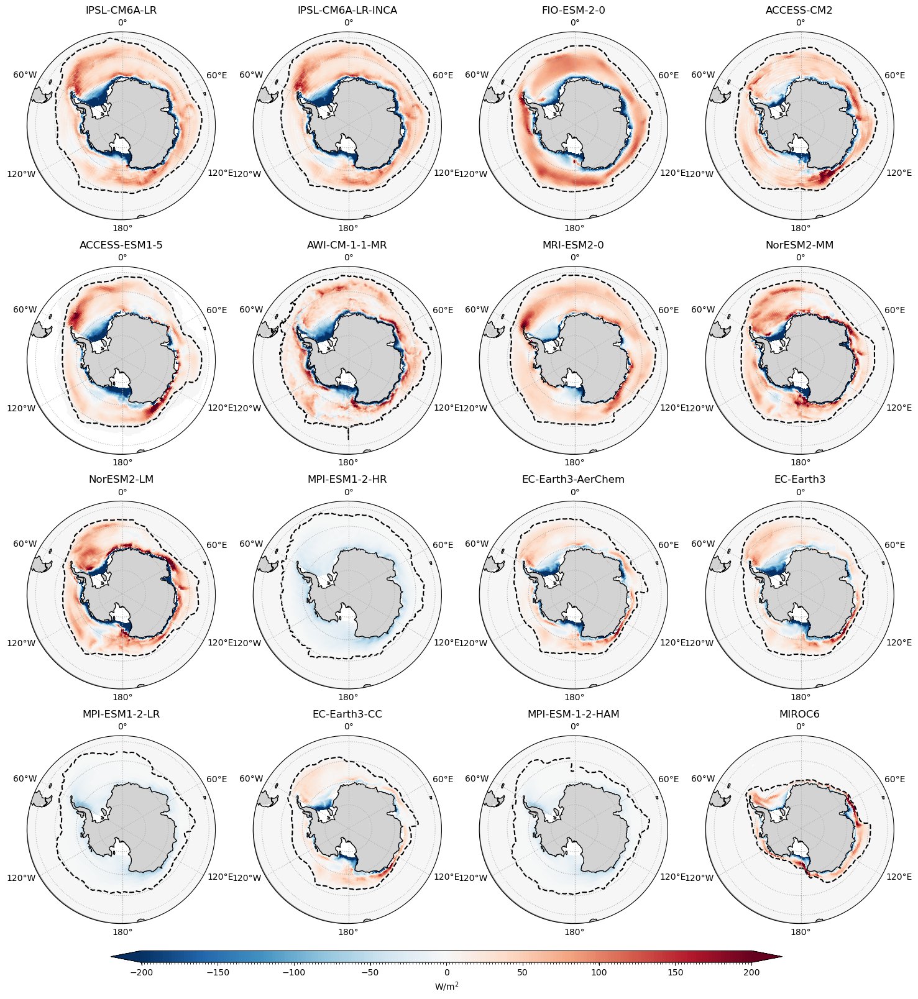

In [65]:
model_list_applied = model_list_fsi_rank
map_variable = 'buo_fsi_map'
plots = plot_buo_map(model_list_applied, model_data, map_variable)
plots.savefig('buo_map_si_cmip6',bbox_inches='tight')

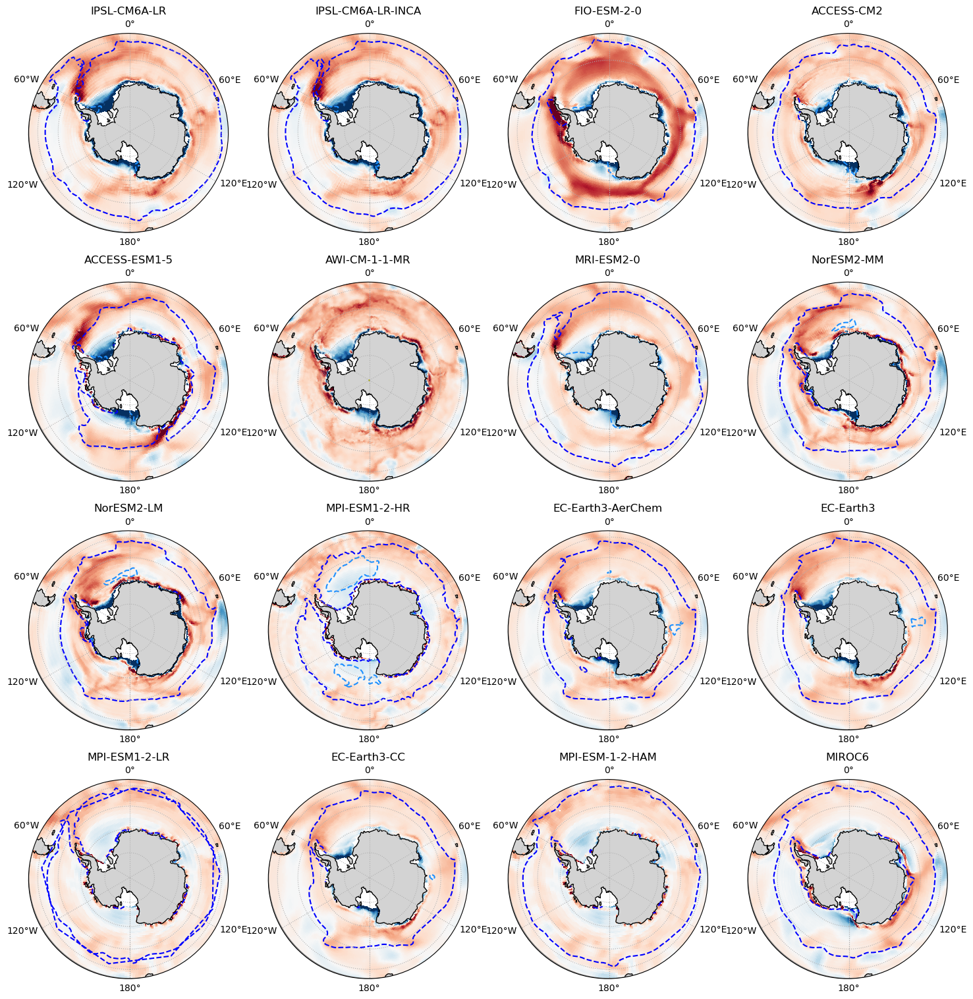

In [66]:
model_list_applied = model_list_fsi_rank
# model_list_applied = model_list_fsi
map_variable = 'buo_total_map'
plot_total_buo = plot_upwelling_map(model_list_applied, model_data, map_variable)

### Sea ice Dominance

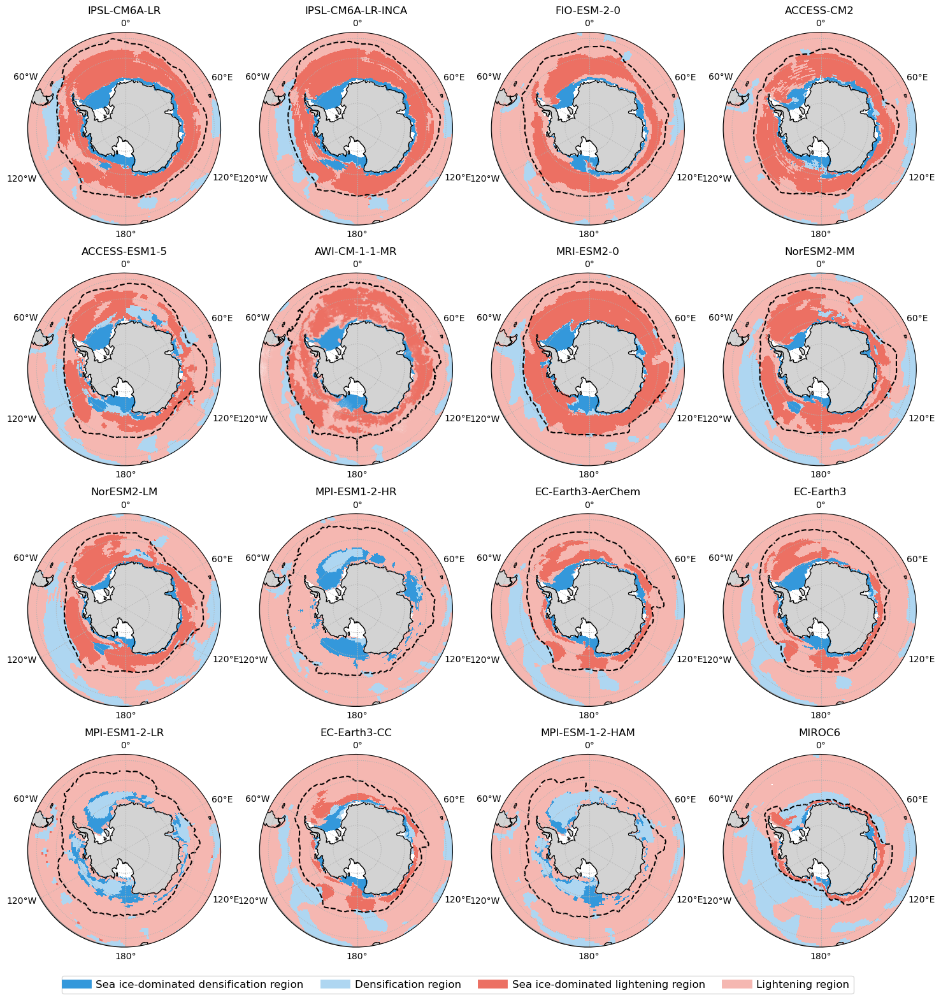

In [67]:
model_list_applied = model_list_fsi_rank
# model_list_applied = model_list_fsi
map_variable = 'buo_fsi_map'
plots = plot_dominance_map(model_list_applied, model_data, map_variable)
plots.savefig('plot_fsi_dominance_cmip6',bbox_inches='tight')

## Plot of TS

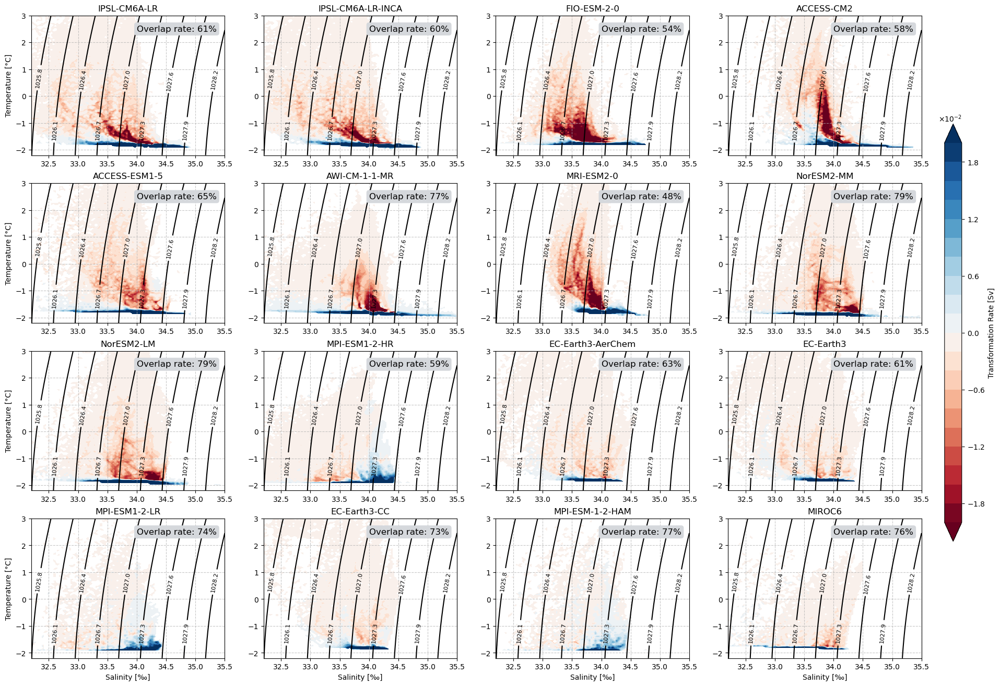

In [217]:
model_list_applied = model_list_fsi_rank
variable_applied  = 'tr_fsi_weighted_mon'
plots = plot_tr_in_ts(model_list_applied , variable_applied, model_data, lat_limit=-45 , tem_lim=[-2.2, 3])#, lat_limit=-45, sal_lim=[32.2, 35.5], tem_lim=[-2.2, 5], include_colorbar=True)
plots.savefig('tr_in_ts_cmip6',bbox_inches='tight')

## Plot of Lat in TS

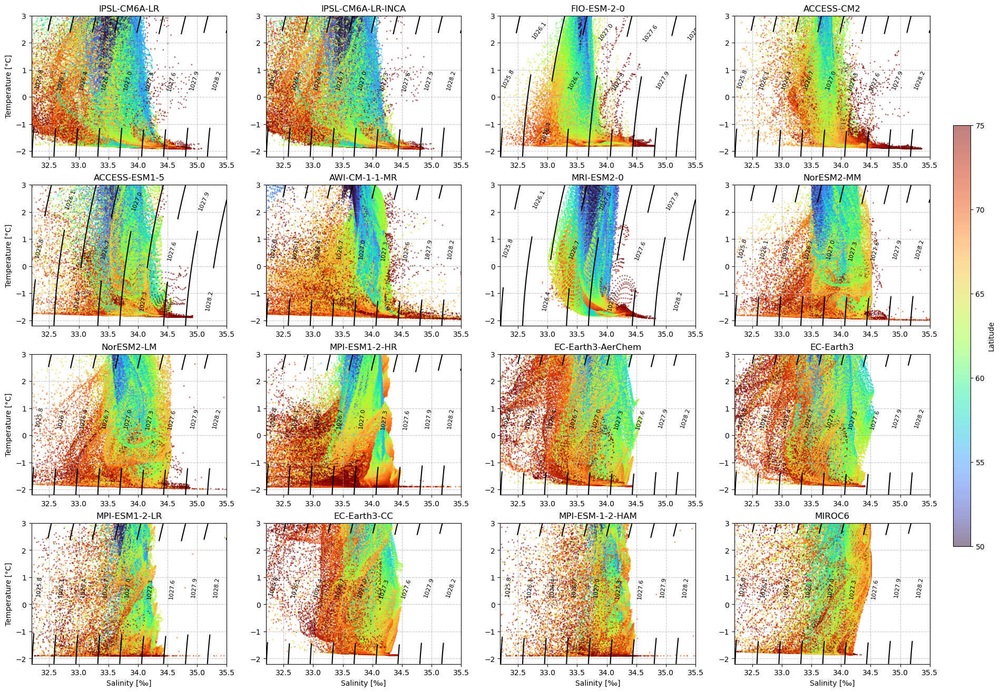

In [69]:
model_list_applied = model_list_fsi_rank
variable_applied  = 'tr_fsi_weighted_mon'
plots = plot_lat_in_ts(model_list_applied , variable_applied, model_data, lat_limit=-45 , tem_lim=[-2.2, 3])#, lat_limit=-45, sal_lim=[32.2, 35.5], tem_lim=[-2.2, 5], include_colorbar=True)
plots.savefig('lat_in_ts_cmip6',bbox_inches='tight')

In [70]:
def wmt_in_salinity(transformation, salinity_map, salinity_boundary, salinity_interval):
    """
    Calculate the water mass transformation within salinity bins.

    Parameters:
        transformation (xarray.DataArray): Transformation data.
        salinity_map (xarray.DataArray): salinity map data.
        salinity_boundary (tuple): Tuple containing the lower and upper boundaries of the salinity range.
        salinity_interval (float): Interval between salinity bins.
    Returns:
        xarray.DataArray: Water mass transformation within salinity bins.
    """
    interval = salinity_interval  # Corrected variable name
    salinity_range = np.arange(salinity_boundary[0], salinity_boundary[1], interval) 
    sverdrup = 10**6  # Unit for severdrop 10^6 m^3/s
    km2 = 10**6  # Unit for km2
    tr_list = []
    for sal in salinity_range:
        sal_left = sal - interval/2
        sal_right = sal + interval/2  # the right and left salinity boundary 
        
        # Calculate transformation for accumulation mode
        tranformation_in_sal = transformation.where((salinity_map >= sal_left) & (salinity_map < sal_right)) / 0.1 / sverdrup
        tranformation_all = tranformation_in_sal.sum().values.item()
        tr_list.append(tranformation_all)
        
    tr_in_salinity = xr.DataArray(tr_list, dims=('salinity'), coords={'salinity': salinity_range}) 
    return tr_in_salinity

In [71]:
model_list_applied = model_list_sid
variable_applied  = 'tr_sid_weighted_mon'
salinity_range = [32.5, 35.5]
salinity_interval = 0.1
for model in model_list_applied:
    data = model_data[model]
    lat_key = data['lat_key']
    tr_sid_form = data[variable_applied].where(data[variable_applied] > 0)/12
    tr_sid_melt = data[variable_applied].where(data[variable_applied] < 0)/12
    
    sos_map = data['sos_mean_mon'].where(data['sos_mean_mon'][lat_key] < -45)
    tr_sid_form_in_salinity = wmt_in_salinity(tr_sid_form, sos_map, salinity_range, salinity_interval)
    tr_sid_melt_in_salinity = wmt_in_salinity(tr_sid_melt, sos_map, salinity_range, salinity_interval)
    data.update({
        'tr_sid_form_in_salinity': tr_sid_form_in_salinity,
        'tr_sid_melt_in_salinity': tr_sid_melt_in_salinity
        
    }) 

In [72]:
# model_data[model_list_sid[-1]]['tr_sid_melt_in_salinity'].plot()
# model_data[model_list_sid[-1]]['tr_sid_form_in_salinity'].plot()


In [73]:
# model_data[model_list_sid[5]]['sid_melt_tr_in_density'].plot()
# model_data[model_list_sid[5]]['sid_form_tr_in_density'].plot()


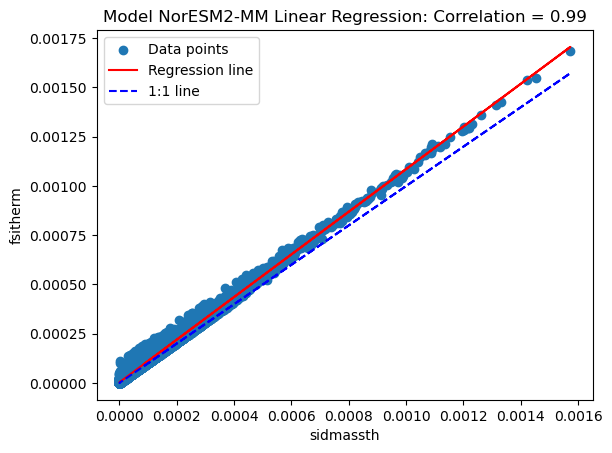

1.082689058480128


In [74]:

model = model_list_sid_fsi[-1]
data = model_data[model]
xx = data['sid_mean_mon'].where(data['sid_mean_mon']>0)
yy = data['fsi_mean_mon'].where(data['fsi_mean_mon']>0)

if 'CMCC' in model or 'NorESM' in model:
    yy = yy * xx/xx

# Assuming xx and yy are xarray DataArrays
xx_values = xx.values.flatten()
yy_values = yy.values.flatten()

# Filter out NaN values
valid_indices = ~np.isnan(xx_values) & ~np.isnan(yy_values)
xx_values = xx_values[valid_indices]
yy_values = yy_values[valid_indices]

# Perform linear regression
slope, intercept, r_value, p_value, std_err = linregress(xx_values, yy_values)

# Calculate the regression line
regression_line = slope * xx_values + intercept

# Plot the scatter plot
plt.scatter(xx_values, yy_values, label='Data points')

# Plot the regression line
plt.plot(xx_values, regression_line, color='red', label='Regression line')

# Add 1:1 line
plt.plot(xx_values, xx_values, color='blue', linestyle='--', label='1:1 line')

# Add labels and title
plt.xlabel('sidmassth')
plt.ylabel('fsitherm')
plt.title(f'Model {model} Linear Regression: Correlation = {r_value:.2f}')

# Add legend
plt.legend()

# Show plot
plt.show()
print(slope)

In [75]:
# Plot of correlation between 12

/jobfs/128132580.gadi-pbs/ipykernel_58485/4190903085.py:48: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/jobfs/128132580.gadi-pbs/ipykernel_58485/4190903085.py:51: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.savefig('correlation1_plots.png')
/g/data/hh5/public/apps/miniconda3/envs/analysis3-24.04/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


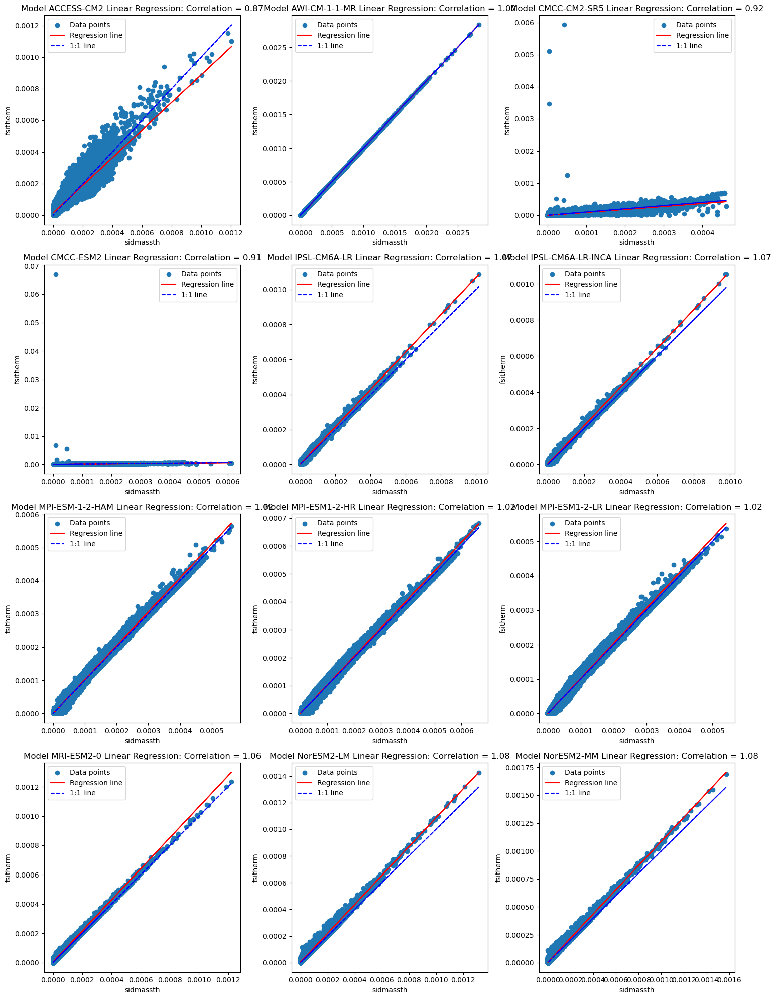

In [76]:
# Assuming model_list_sid_fsi is a list of models
num_models = len(model_list_sid_fsi)
num_cols = 3  # Number of columns for subplots
num_rows = (num_models - 1) // num_cols + 1  # Calculate number of rows

fig, axs = plt.subplots(num_rows, num_cols, figsize=(15, 5*num_rows))

for i, model in enumerate(model_list_sid_fsi):
    data = model_data[model]
    xx = data['sid_mean_mon'].where(data['sid_mean_mon'] > 0)
    yy = data['fsi_mean_mon'].where(data['fsi_mean_mon'] > 0)

    if 'CMCC' in model or 'NorESM' in model:
        yy = yy * xx / xx

    # Extract values and filter NaNs
    xx_values = xx.values.flatten()
    yy_values = yy.values.flatten()
    valid_indices = ~np.isnan(xx_values) & ~np.isnan(yy_values)
    xx_values = xx_values[valid_indices]
    yy_values = yy_values[valid_indices]

    # Perform linear regression
    slope, intercept, r_value, p_value, std_err = linregress(xx_values, yy_values)

    # Calculate the regression line
    regression_line = slope * xx_values + intercept

    # Determine subplot index
    row = i // num_cols
    col = i % num_cols

    # Plot the scatter plot and regression line
    ax = axs[row, col]
    ax.scatter(xx_values, yy_values, label='Data points')
    ax.plot(xx_values, regression_line, color='red', label='Regression line')
    ax.plot(xx_values, xx_values, color='blue', linestyle='--', label='1:1 line')

    # Add labels and title
    ax.set_xlabel('sidmassth')
    ax.set_ylabel('fsitherm')
    ax.set_title(f'Model {model} Linear Regression: Correlation = {slope:.2f}')

    # Add legend
    ax.legend()

# Adjust layout
plt.tight_layout()

# Save the figure as PNG
plt.savefig('correlation1_plots.png')

# Show plot
plt.show()


## Plot of formation

In [77]:
for model in model_list_fsi_rank:
    data = model_data[model]
    if 'mix_tr_in_density' in data:
        mix = data['mix_tr_in_density']/12        
        mix_fr = tr_to_fr(mix)    
        data.update({
                    'mix_fr' : mix_fr,
                    })
    fsi = data['fsi_tr_in_density']/12
    wfo = data['wfo_tr_in_density']/12
    total = data['total_tr_in_density']/12
    hfds = data['hfds_tr_in_density']/12
    
    fsi_fr = tr_to_fr(fsi) # Use function tr_to_fr to transform WMT to WMF
    wfo_fr = tr_to_fr(wfo)
    total_fr = tr_to_fr(total)
    hfds_fr = tr_to_fr(hfds)
    
    data.update({'fsi_fr' : fsi_fr,
        'wfo_fr' : wfo_fr,
        'hfds_fr' : hfds_fr,
        'total_fr' : total_fr,   
    })

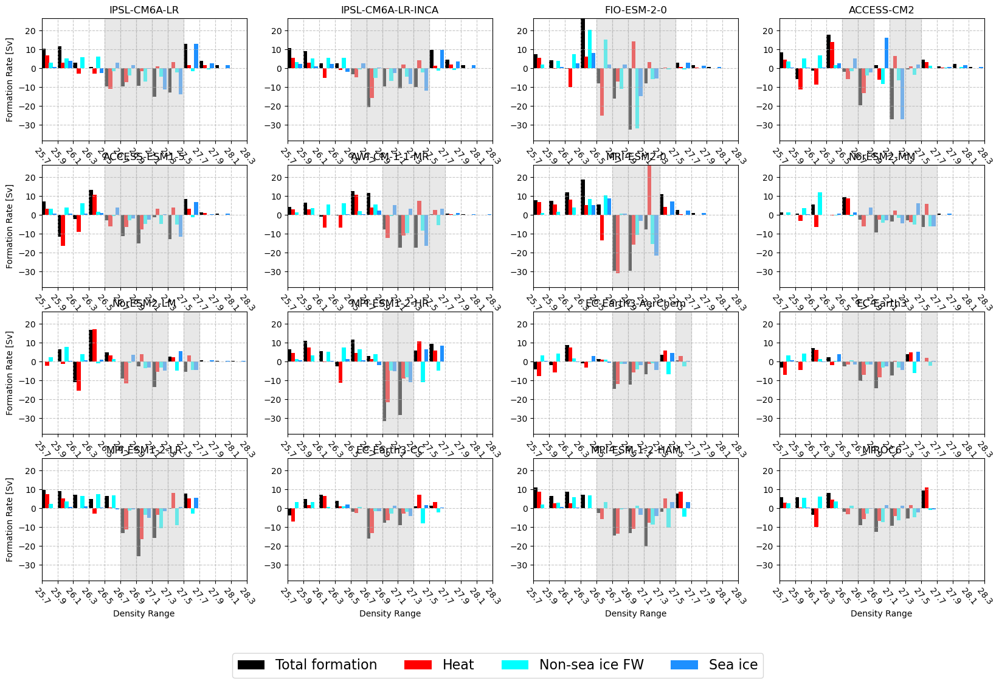

In [78]:
# Assuming model_list_fsi_rank is a list of models
num_models = len(model_list_fsi_rank)
num_cols = 4  # Number of columns for subplots
num_rows = (num_models - 1) // num_cols + 1  # Calculate number of rows
x_tic = [24.5, 24.7, 24.9, 25.1, 25.3, 25.5, 25.7, 25.9, 26.1, 26.3, 26.5,
       26.7, 26.9, 27.1, 27.3, 27.5, 27.7, 27.9, 28.1, 28.3]
# Set up the figure and axes
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 3*num_rows))

for i, model in enumerate(model_list_fsi_rank):
    # Get data for the current model
    data = model_data[model]
    hfds_fr = data['hfds_fr']
    wfo_fr = data['wfo_fr']
    fsi_fr = data['fsi_fr']
    # if 'lateral_fr_in_density' in data:
    #     total_fr = data['lateral_fr_in_density']/12
    # else:
    #     total_fr = wfo_fr + hfds_fr
    total_fr = wfo_fr + hfds_fr
    

    # Data for multiple series
    number_data = 4
    interval = 0.2
    bar_width = interval / number_data

    # Create new data with adjusted interval
    hfds_fr_new = fr_new_interval(hfds_fr, interval)
    wfo_fr_new = fr_new_interval(wfo_fr, interval)
    fsi_fr_new = fr_new_interval(fsi_fr, interval)
    total_fr_new = fr_new_interval(total_fr, interval)

    # Determine subplot index
    row = i // num_cols
    col = i % num_cols

    # Create a bar plot for the current model
    ax = axs[row, col]

    # ax.bar(hfds_fr_new.density + 0 * bar_width, hfds_fr_new + wfo_fr_new, width=bar_width, color='k', align='edge', label='Total formation')
    # ax.bar(hfds_fr_new.density + 0.9 * bar_width, hfds_fr_new, width=bar_width, color='r', align='edge', label='Heat')
    # ax.bar(hfds_fr_new.density + 1.8 * bar_width, wfo_fr_new, width=bar_width, color='cyan', align='edge', label='Freshwater')
    # ax.bar(hfds_fr_new.density + 2.7 * bar_width, fsi_fr_new, width=bar_width, color='dodgerblue', align='edge', label='Sea ice')
    # Plot bars for total formation
    bars_total = ax.bar(hfds_fr_new.density + 0 * bar_width, total_fr_new, width=bar_width, color='k', align='edge', label='Total formation')
    
    # Plot bars for heat
    bars_heat = ax.bar(hfds_fr_new.density + 0.9 * bar_width, hfds_fr_new, width=bar_width, color='r', align='edge', label='Heat')
    
    # Plot bars for freshwater
    bars_freshwater = ax.bar(hfds_fr_new.density + 1.8 * bar_width, wfo_fr_new - fsi_fr_new, width=bar_width, color='cyan', align='edge', label='Non-sea ice FW')
    
    # Plot bars for sea ice
    bars_sea_ice = ax.bar(hfds_fr_new.density + 2.7 * bar_width, fsi_fr_new, width=bar_width, color='dodgerblue', align='edge', label='Sea ice')

    # Add gray background where hfds_fr_new + wfo_fr_new is negative
    for bar_total, density in zip(bars_total, hfds_fr_new.density):
        if density > 26.4 and density < 27.6:
            if bar_total.get_height() < 1:
                ax.axvspan(density, density + interval, color='lightgrey', alpha=0.5)
 
    ax.set_xlabel('Density')
    ax.set_ylabel('Formation Rate [Sv]')
    ax.set_xticks(np.arange(24.5,28.5,interval))
    ax.set_xticklabels(x_tic, fontsize=10, rotation=-50)
    # Set the x and y axis labels
    if col  == 0:
        ax.set_ylabel('Formation Rate [Sv]')
    else:
        ax.set_ylabel('')
    if row  == num_rows - 1:
        ax.set_xlabel('Density Range')
    else:
        ax.set_xlabel('')
    
    # ax.set_xticklabels(np.arange(24.5,28.5,interval), rotation=-20)
    ax.set_title(f'{model}')
    # ax.legend(loc = 'lower right')
    # ax.grid(axis='x')
    ax.grid(linestyle = '--', alpha =0.7)
    
    # ax.set_ylim(-32, 22)
    ax.set_ylim(-38.4, 26.4)        
    
    # if 'MRI' in model:
    ax.set_xlim(25.7, 28.3)
    
# Collect handles and labels from one of the subplots
handles, labels = ax.get_legend_handles_labels()

# Add a single legend to the figure
fig.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, 0.02), ncol=len(handles), prop={'size': 16})

# Save the figure as PNG
plt.savefig('formation_plots.png', bbox_inches='tight')
# Show plot
plt.show()


### Formation

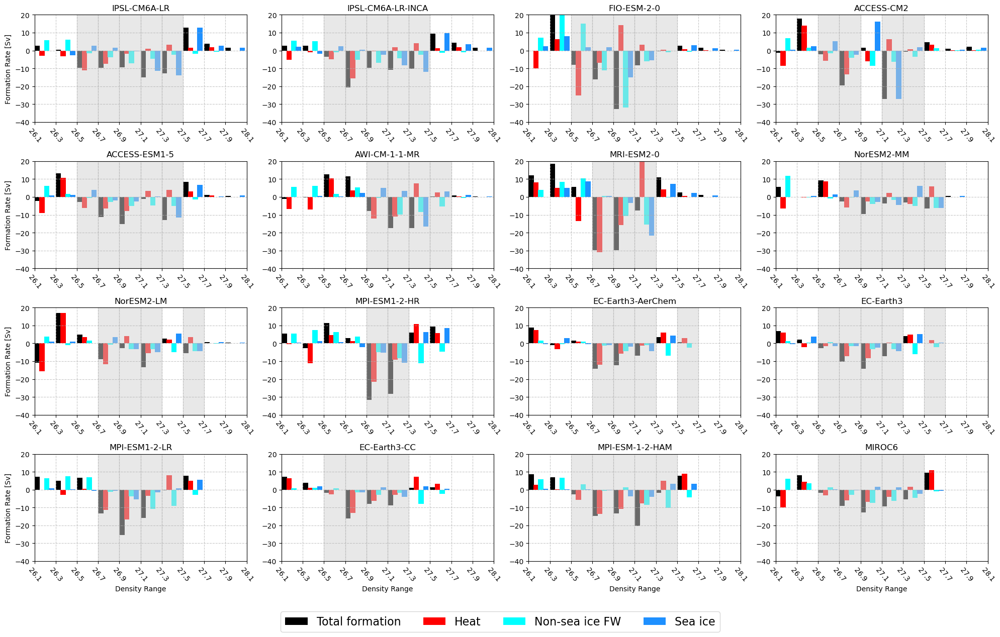

In [79]:
bar_interval = 0.2
# Assuming model_list_fsi_rank is a list of models
num_models = len(model_list_fsi_rank)
num_cols = 4  # Number of columns for subplots
num_rows = (num_models - 1) // num_cols + 1  # Calculate number of rows
x_tic = np.arange(24.5, 28.5, bar_interval)
# Set up the figure and axes
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 3*num_rows))

for i, model in enumerate(model_list_fsi_rank):
    # Get data for the current model
    data = model_data[model]
    hfds_fr = data['hfds_fr']
    wfo_fr = data['wfo_fr']
    fsi_fr = data['fsi_fr']
    total_fr = wfo_fr + hfds_fr

    # Data for multiple series
    number_data = 4
    interval = bar_interval 
    bar_width = interval / number_data

    # Create new data with adjusted interval
    hfds_fr_new = fr_new_interval(hfds_fr, interval)
    wfo_fr_new = fr_new_interval(wfo_fr, interval)
    fsi_fr_new = fr_new_interval(fsi_fr, interval)
    total_fr_new = fr_new_interval(total_fr, interval)

    data.update({
        'hfds_fr_new': hfds_fr_new,
        'wfo_fr_new': wfo_fr_new,
        'fsi_fr_new': fsi_fr_new,
    })

    # Determine subplot index
    row = i // num_cols
    col = i % num_cols

    # Create a bar plot for the current model
    ax = axs[row, col]

    # Plot bars for total formation
    bars_total = ax.bar(hfds_fr_new.density + 0 * bar_width, total_fr_new, width=bar_width, color='k', align='edge', label='Total formation')
    
    # Plot bars for heat
    bars_heat = ax.bar(hfds_fr_new.density + 0.9 * bar_width, hfds_fr_new, width=bar_width, color='r', align='edge', label='Heat')
    
    # Plot bars for freshwater
    bars_freshwater = ax.bar(hfds_fr_new.density + 1.8 * bar_width, wfo_fr_new - fsi_fr_new, width=bar_width, color='cyan', align='edge', label='Non-sea ice FW')
    
    # Plot bars for sea ice
    bars_sea_ice = ax.bar(hfds_fr_new.density + 2.7 * bar_width, fsi_fr_new, width=bar_width, color='dodgerblue', align='edge', label='Sea ice')

    # Add gray background where hfds_fr_new + wfo_fr_new is negative
    for bar_total, density in zip(bars_total, hfds_fr_new.density):
        if density > 26.4 and density < 27.6:
            if bar_total.get_height() < 1:
                ax.axvspan(density, density + interval, color='lightgrey', alpha=0.5)
 
    ax.set_xlabel('Density')
    ax.set_ylabel('Formation Rate [Sv]')
    ax.set_xticks(np.arange(24.5,28.5,interval))
    ax.set_xticklabels([f'{xt:.1f}' for xt in x_tic], fontsize=10, rotation=-50)
    # Set the x and y axis labels
    if col == 0:
        ax.set_ylabel('Formation Rate [Sv]')
    else:
        ax.set_ylabel('')
    if row == num_rows - 1:
        ax.set_xlabel('Density Range')
    else:
        ax.set_xlabel('')
    
    ax.set_title(f'{model}')
    ax.grid(linestyle = '--', alpha =0.7)
    
    ax.set_ylim(-40, 20)        
    ax.set_xlim(26.1, 28.1)
    
# Collect handles and labels from one of the subplots
handles, labels = ax.get_legend_handles_labels()

# Add a single legend to the figure
fig.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, -0.01), ncol=4, prop={'size': 16})

# Adjust layout
plt.tight_layout()
# Save the figure as PNG
plt.savefig('formation_plots.png', bbox_inches='tight')
# Show plot
plt.show()


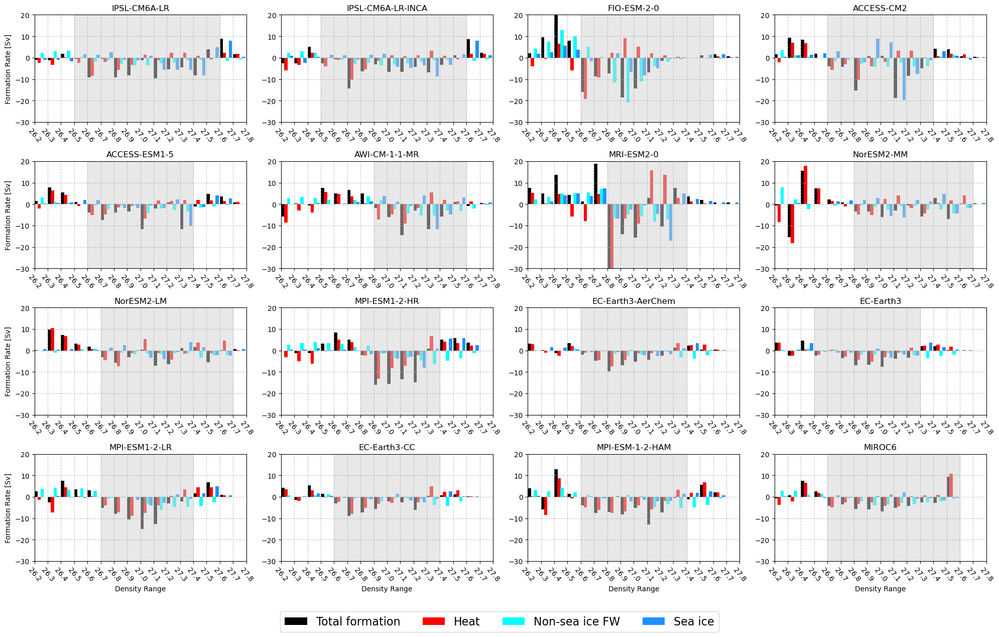

In [80]:

# Assuming model_list_fsi_rank is a list of models
num_models = len(model_list_fsi_rank)
num_cols = 4  # Number of columns for subplots
num_rows = (num_models - 1) // num_cols + 1  # Calculate number of rows

x_tic = np.arange(24.5, 28.5, 0.1)

# Set up the figure and axes
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 3*num_rows))

for i, model in enumerate(model_list_fsi_rank):
    # Get data for the current model
    data = model_data[model]
    hfds_fr = data['hfds_fr']
    wfo_fr = data['wfo_fr']
    fsi_fr = data['fsi_fr']
    total_fr = wfo_fr + hfds_fr

    # Data for multiple series
    number_data = 4
    interval = 0.1
    bar_width = interval / number_data

    # Create new data with adjusted interval
    hfds_fr_new = fr_new_interval(hfds_fr, interval)
    wfo_fr_new = fr_new_interval(wfo_fr, interval)
    fsi_fr_new = fr_new_interval(fsi_fr, interval)
    total_fr_new = fr_new_interval(total_fr, interval)

    # Determine subplot index
    row = i // num_cols
    col = i % num_cols

    # Create a bar plot for the current model
    ax = axs[row, col]

    # Plot bars for total formation
    bars_total = ax.bar(hfds_fr_new.density + 0 * bar_width, total_fr_new, width=bar_width, color='k', align='edge', label='Total formation')
    
    # Plot bars for heat
    bars_heat = ax.bar(hfds_fr_new.density + 0.9 * bar_width, hfds_fr_new, width=bar_width, color='r', align='edge', label='Heat')
    
    # Plot bars for freshwater
    bars_freshwater = ax.bar(hfds_fr_new.density + 1.8 * bar_width, wfo_fr_new - fsi_fr_new, width=bar_width, color='cyan', align='edge', label='Non-sea ice FW')
    
    # Plot bars for sea ice
    bars_sea_ice = ax.bar(hfds_fr_new.density + 2.7 * bar_width, fsi_fr_new, width=bar_width, color='dodgerblue', align='edge', label='Sea ice')

    # Plot background for pumping region
    total_tr_in_density = data['total_tr_in_density']
    den_max = total_tr_in_density.where(total_tr_in_density.density < 27.7).idxmax()
    den_min = total_tr_in_density.where(total_tr_in_density.density > 26.4).idxmin()
    if 'ACCESS-CM2' in model:
        den_max -= 0.1
    if 'ACCESS-ESM1-5' in model:
        den_max -= 0.2
    if 'MRI-ESM2.0' in model:
        den_max -= 0.2
    if model == 'EC-Earth3':
        den_max -= 0.1
    if 'MPI-ESM1-2-LR' in model:
        den_max -= 0.1
    if 'MPI-ESM-1-2-HAM' in model:
        den_max -= 0.2
    ax.axvspan(den_min, den_max + interval, color='lightgrey', alpha=0.5)
    data.update({
        'den_min': den_min,
        'den_max': den_max,        
                })
 
    ax.set_xlabel('Density')
    ax.set_ylabel('Formation Rate [Sv]')
    ax.set_xticks(np.arange(24.5,28.5,interval))
    ax.set_xticklabels([f'{xt:.1f}' for xt in x_tic], fontsize=10, rotation=-50)
    # Set the x and y axis labels
    if col == 0:
        ax.set_ylabel('Formation Rate [Sv]')
    else:
        ax.set_ylabel('')
    if row == num_rows - 1:
        ax.set_xlabel('Density Range')
    else:
        ax.set_xlabel('')
    
    ax.set_title(f'{model}')
    ax.grid(linestyle = '--', alpha =0.7)
    
    ax.set_ylim(-30, 20)        
    ax.set_xlim(26.2, 27.8)
    
# Collect handles and labels from one of the subplots
handles, labels = ax.get_legend_handles_labels()

# Add a single legend to the figure
fig.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, -0.01), ncol=4, prop={'size': 16})

# Adjust layout
plt.tight_layout()
# Save the figure as PNG
plt.savefig('formation_plots.png', bbox_inches='tight')
# Show plot
plt.show()


### Corelation 

In [81]:
total_pumping_list = [] ; total_po_pumping_list = [] ; total_ne_pumping_list = [] 
fsi_pumping_list = []; fsi_po_pumping_list = [] ; fsi_ne_pumping_list = []
wfo_pumping_list = []; wfo_po_pumping_list = [] ; wfo_ne_pumping_list = []
hfds_pumping_list = []
sip_list = []

for model in model_list_fsi_rank:
    data = model_data[model]
    total_fr = data['total_fr']
    fsi_fr = data['fsi_fr']
    wfo_fr = data['wfo_fr']
    hfds_fr = data['hfds_fr']
    den_max = data['den_max']
    den_min = data['den_min']
    
    # total_pumping = total_fr.where(total_fr.density > den_min).where(total_fr.density < den_max).sum().values.item()
    fsi_pumping = fsi_fr.where(total_fr.density > den_min).where(total_fr.density < den_max).sum().values.item()    
    wfo_pumping = wfo_fr.where(total_fr.density > den_min).where(total_fr.density < den_max).sum().values.item()
    hfds_pumping = hfds_fr.where(total_fr.density > den_min).where(total_fr.density < den_max).sum().values.item()  
    total_pumping = wfo_pumping + hfds_pumping
    
    total_pumping_list.append(abs(total_pumping))
    fsi_pumping_list.append(abs(fsi_pumping))
    wfo_pumping_list.append(abs(wfo_pumping))
    hfds_pumping_list.append(abs(hfds_pumping)) 
    ## Sea ice pumping (sip) only bins
    fsi_sip = fsi_fr.where(fsi_fr<0).sum().values.item() 
    wfo_sip = wfo_fr.where(fsi_fr<0).sum().values.item() 
    hfds_sip = hfds_fr.where(fsi_fr<0).sum().values.item() 
    total_sip = wfo_sip + hfds_sip
    sip_ratio = fsi_sip/total_sip
    hfds_sip/total_sip
    
    sip_list.append(sip_ratio) 
    
    
total_pumping_list = xr.DataArray(total_pumping_list)
fsi_pumping_list = xr.DataArray(fsi_pumping_list)    
wfo_pumping_list = xr.DataArray(wfo_pumping_list)    
hfds_pumping_list = xr.DataArray(hfds_pumping_list)    

In [82]:
mean_ratio = np.mean(sip_list)
print(f'In the Sea ice destruction bins, \nthe Sea ice destruction/ Total destruction: {mean_ratio:.2f}')

In the Sea ice destruction bins, 
the Sea ice destruction/ Total destruction: -0.15


In [83]:
si_ratio = (fsi_pumping_list/total_pumping_list).mean().values
heat_ratio = (hfds_pumping_list/total_pumping_list).mean().values
freshwater_ratio = ((wfo_pumping_list-fsi_pumping_list)/total_pumping_list).mean().values

print(f'In the total destruction bins, \n Sea ice/ Total: {si_ratio:.2f} \n Heat/ Total : {heat_ratio:.2f} \n non-sea ice freshwater/ Total: {freshwater_ratio:.2f}')

In the total destruction bins, 
 Sea ice/ Total: 0.27 
 Heat/ Total : 0.38 
 non-sea ice freshwater/ Total: 0.43


In [84]:
# second_column = [
#     17.30,
#     14.66,
#     21.05,
#     4.98,
#     5.06,
#     13.26,
#     10.40,
#     2.80,
#     2.17,
#     14.74,
#     4.57,
#     5.48,
#     7.39,
#     3.02,
#     6.53,
#     0.00
# ]

# xx = fsi_melt
# yy = second_column
# model_list_p = model_list_fsi_rank
# plot_correlation(xx, yy, model_list_p)

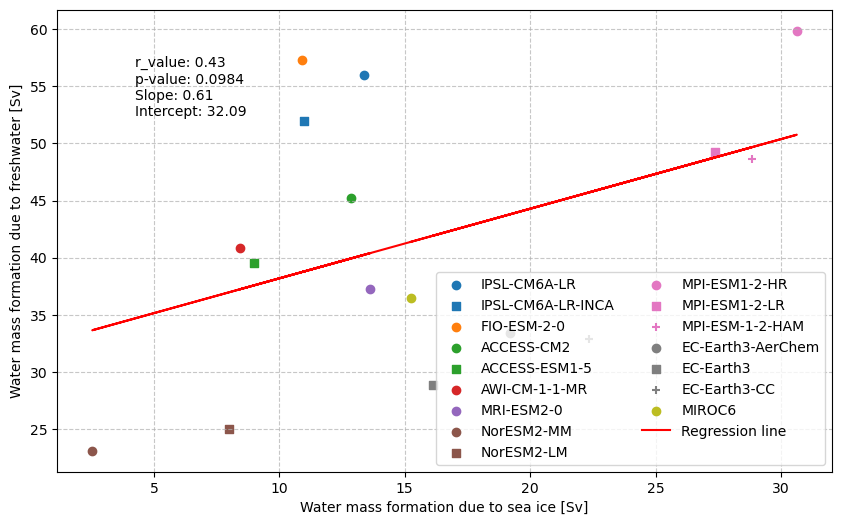

In [85]:
xx = hfds_pumping_list
yy = total_pumping_list
model_list_p = model_list_fsi_rank
plot_correlation(xx, yy, model_list_p)

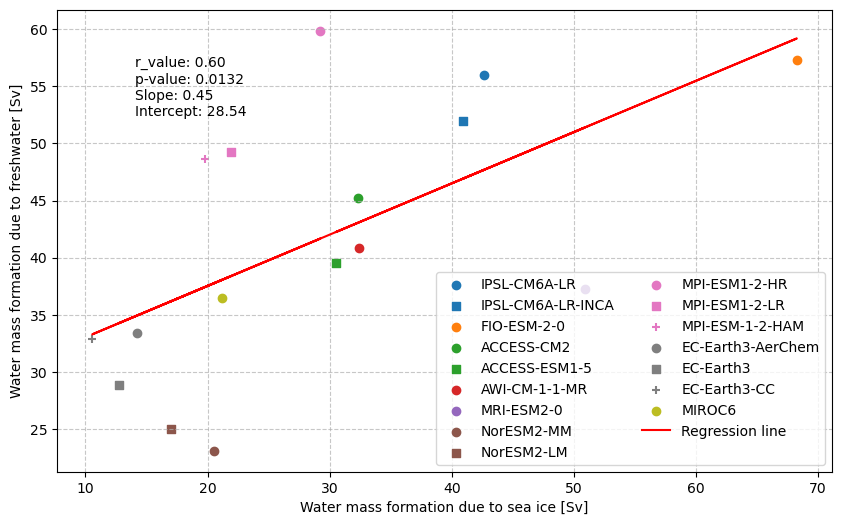

In [86]:
xx = wfo_pumping_list
yy = total_pumping_list
model_list_p = model_list_fsi_rank
plot_correlation(xx, yy, model_list_p)

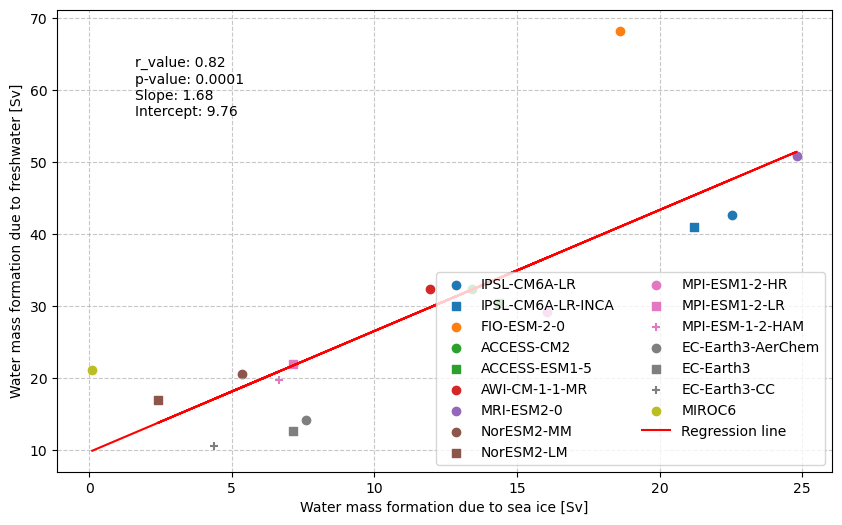

In [87]:
xx = fsi_pumping_list
yy = wfo_pumping_list
model_list_p = model_list_fsi_rank
plot_correlation(xx, yy, model_list_p)

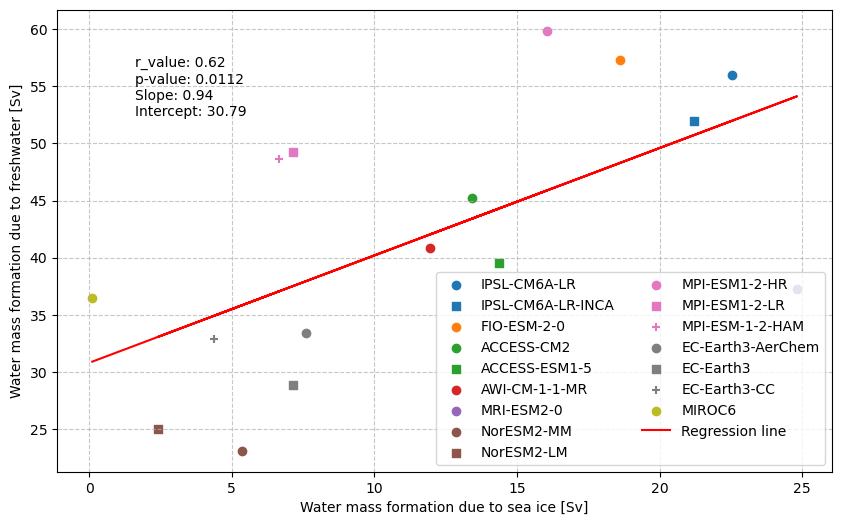

In [88]:
xx = fsi_pumping_list
yy = total_pumping_list
model_list_p = model_list_fsi_rank
plot_correlation(xx, yy, model_list_p)

In [89]:
xx = fsi_pumping_list
yy = wfo_pumping_list
model_list_p = model_list_fsi_rank

model_series = {}
xx_series = {}
yy_series = {}

for x,y,model in zip(xx,yy,model_list_p):
    series = model.split('-')[0]  # Assuming the series is the part before the first '-'
    if series not in model_series:
        model_series[series] = []
        xx_series[series] = []
        yy_series[series] = []
    model_series[series].append(model)
    xx_series[series].append(x)
    yy_series[series].append(y)
 
colors = plt.cm.tab10.colors
index_color = 0 # the index for selecting model and color
index_model = 0

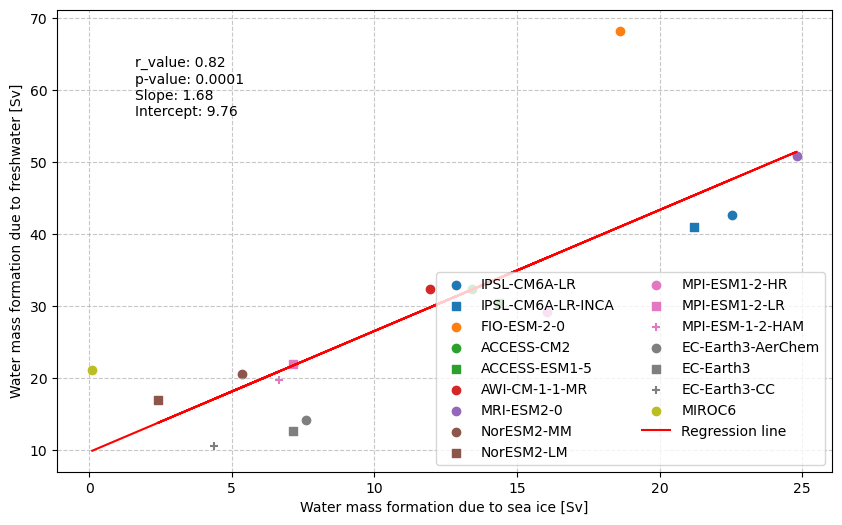

In [90]:
# Set the figure size
plt.figure(figsize=(10, 6))

for series, models in model_series.items():
    marker_styles = ['o', 's', '+', 'x']
    color = colors[index_color]
    index_color = index_color + 1
    xx1 = xx_series[series]
    yy1 = yy_series[series]
     
    # Scatter plot
    for x, y, model in zip(xx1, yy1, models):
        marker_style = marker_styles.pop(0)  # Pop the first line style for the current series        
        plt.scatter(x, y, 
                    label=model ,
                    marker =  marker_style,
                    color = color,
                    )
        index_model = index_model + 1

# Compute linear regression
slope, intercept, r_value, p_value, std_err = linregress(xx, yy)

# Calculate regression line
regression_line = slope * np.array(xx) + intercept

# Plot the regression line
plt.plot(xx, regression_line, color='red', label='Regression line')

# Add correlation and regression equation to the plot
plt.text(0.1, 0.9, f'r_value: {r_value:.2f}\np-value: {p_value:.4f}\nSlope: {slope:.2f}\nIntercept: {intercept:.2f}', transform=plt.gca().transAxes, fontsize=10, verticalalignment='top')


# Add labels and title
plt.xlabel('Water mass formation due to sea ice [Sv]')
plt.ylabel('Water mass formation due to freshwater [Sv]')
# plt.title('Scatter plot with Linear Regression')
plt.grid(linestyle = '--', alpha = 0.7)
# Add legend
plt.legend(loc = 'lower right', ncol=2)

# Show plot
plt.show()

### Annual mean

In [91]:
for model in model_list_fsi_rank:
    data = model_data[model]
    if 'mix_tr_in_density' in data:
        mix = data['mix_tr_in_density_annual']        
        mix_fr_annual = tr_to_fr(mix)    
        data.update({
                    'mix_fr_annual' : mix_fr_annual,
                    })
    fsi = data['fsi_tr_in_density_annual']
    wfo = data['wfo_tr_in_density_annual']
    total = data['total_tr_in_density_annual']
    hfds = data['hfds_tr_in_density_annual']
    
    fsi_fr_annual = tr_to_fr(fsi) # Use function tr_to_fr_annual to transform WMT to WMF
    wfo_fr_annual = tr_to_fr(wfo)
    total_fr_annual = tr_to_fr(total)
    hfds_fr_annual = tr_to_fr(hfds)
    
    data.update({'fsi_fr_annual' : fsi_fr_annual,
        'wfo_fr_annual' : wfo_fr_annual,
        'hfds_fr_annual' : hfds_fr_annual,
        'total_fr_annual' : total_fr_annual,   
    })

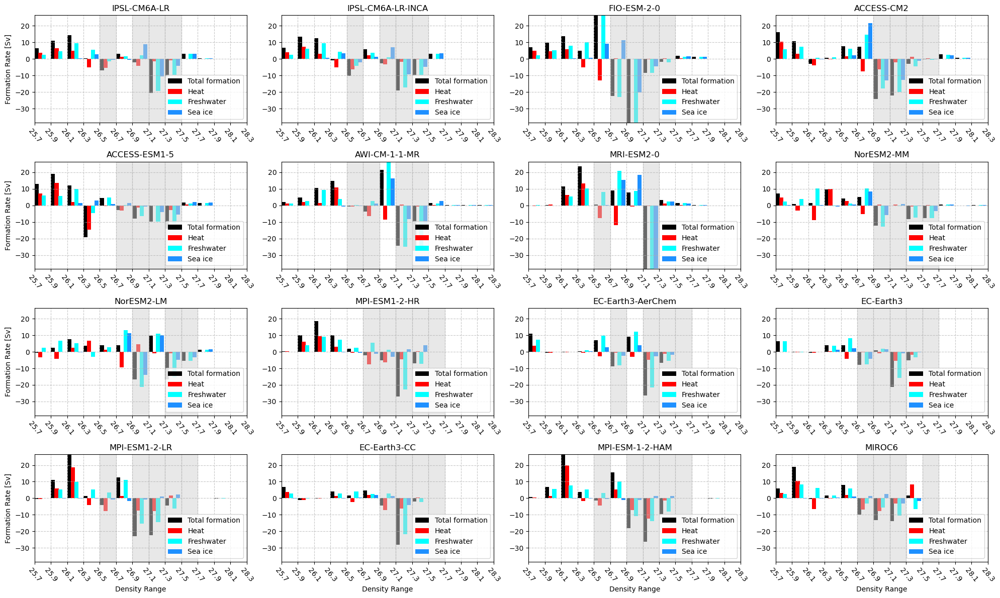

In [92]:
# Assuming model_list_fsi_rank is a list of models
num_models = len(model_list_fsi_rank)
num_cols = 4  # Number of columns for subplots
num_rows = (num_models - 1) // num_cols + 1  # Calculate number of rows
x_tic = [24.5, 24.7, 24.9, 25.1, 25.3, 25.5, 25.7, 25.9, 26.1, 26.3, 26.5,
       26.7, 26.9, 27.1, 27.3, 27.5, 27.7, 27.9, 28.1, 28.3]
# Set up the figure and axes
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 3*num_rows))

for i, model in enumerate(model_list_fsi_rank):
    # Get data for the current model
    data = model_data[model]
    hfds_fr = data['hfds_fr_annual']
    wfo_fr = data['wfo_fr_annual']
    fsi_fr = data['fsi_fr_annual']
    # if 'lateral_fr_in_density' in data:
    #     total_fr = data['lateral_fr_in_density']/12
    # else:
    #     total_fr = wfo_fr + hfds_fr
    total_fr = wfo_fr + hfds_fr
    

    # Data for multiple series
    number_data = 4
    interval = 0.2
    bar_width = interval / number_data

    # Create new data with adjusted interval
    hfds_fr_new = fr_new_interval(hfds_fr, interval)
    wfo_fr_new = fr_new_interval(wfo_fr, interval)
    fsi_fr_new = fr_new_interval(fsi_fr, interval)
    total_fr_new = fr_new_interval(total_fr, interval)

    # Determine subplot index
    row = i // num_cols
    col = i % num_cols

    # Create a bar plot for the current model
    ax = axs[row, col]

    # ax.bar(hfds_fr_new.density + 0 * bar_width, hfds_fr_new + wfo_fr_new, width=bar_width, color='k', align='edge', label='Total formation')
    # ax.bar(hfds_fr_new.density + 0.9 * bar_width, hfds_fr_new, width=bar_width, color='r', align='edge', label='Heat')
    # ax.bar(hfds_fr_new.density + 1.8 * bar_width, wfo_fr_new, width=bar_width, color='cyan', align='edge', label='Freshwater')
    # ax.bar(hfds_fr_new.density + 2.7 * bar_width, fsi_fr_new, width=bar_width, color='dodgerblue', align='edge', label='Sea ice')
    # Plot bars for total formation
    bars_total = ax.bar(hfds_fr_new.density + 0 * bar_width, total_fr_new, width=bar_width, color='k', align='edge', label='Total formation')
    
    # Plot bars for heat
    bars_heat = ax.bar(hfds_fr_new.density + 0.9 * bar_width, hfds_fr_new, width=bar_width, color='r', align='edge', label='Heat')
    
    # Plot bars for freshwater
    bars_freshwater = ax.bar(hfds_fr_new.density + 1.8 * bar_width, wfo_fr_new, width=bar_width, color='cyan', align='edge', label='Freshwater')
    
    # Plot bars for sea ice
    bars_sea_ice = ax.bar(hfds_fr_new.density + 2.7 * bar_width, fsi_fr_new, width=bar_width, color='dodgerblue', align='edge', label='Sea ice')

    # Add gray background where hfds_fr_new + wfo_fr_new is negative
    for bar_total, density in zip(bars_total, hfds_fr_new.density):
        if density > 26.4 and density < 27.6:
            if bar_total.get_height() < 1:
                ax.axvspan(density, density + interval, color='lightgrey', alpha=0.5)
 
    ax.set_xlabel('Density')
    ax.set_ylabel('Formation Rate [Sv]')
    ax.set_xticks(np.arange(24.5,28.5,interval))
    ax.set_xticklabels(x_tic, fontsize=10, rotation=-50)
    # Set the x and y axis labels
    if col  == 0:
        ax.set_ylabel('Formation Rate [Sv]')
    else:
        ax.set_ylabel('')
    if row  == num_rows - 1:
        ax.set_xlabel('Density Range')
    else:
        ax.set_xlabel('')
    
    # ax.set_xticklabels(np.arange(24.5,28.5,interval), rotation=-20)
    ax.set_title(f'{model}')
    ax.legend(loc = 'lower right')
    # ax.grid(axis='x')
    ax.grid(linestyle = '--', alpha =0.7)
    
    # ax.set_ylim(-32, 22)
    ax.set_ylim(-38.4, 26.4)        
    
    # if 'MRI' in model:
    ax.set_xlim(25.7, 28.3)
    

# Adjust layout
plt.tight_layout()
# Save the figure as PNG
plt.savefig('formation_plots.png')
# Show plot
plt.show()


## Plot of ensemble

In [93]:
model_series = {}
for model in model_list_fsi_rank:
    series = model.split('-')[0]  # Assuming the series is the part before the first '-'
    if series not in model_series:
        model_series[series] = []
    model_series[series].append(model)

In [94]:
model_series

{'IPSL': ['IPSL-CM6A-LR', 'IPSL-CM6A-LR-INCA'],
 'FIO': ['FIO-ESM-2-0'],
 'ACCESS': ['ACCESS-CM2', 'ACCESS-ESM1-5'],
 'AWI': ['AWI-CM-1-1-MR'],
 'MRI': ['MRI-ESM2-0'],
 'NorESM2': ['NorESM2-MM', 'NorESM2-LM'],
 'MPI': ['MPI-ESM1-2-HR', 'MPI-ESM1-2-LR', 'MPI-ESM-1-2-HAM'],
 'EC': ['EC-Earth3-AerChem', 'EC-Earth3', 'EC-Earth3-CC'],
 'MIROC6': ['MIROC6']}

### Spaghetti Plot

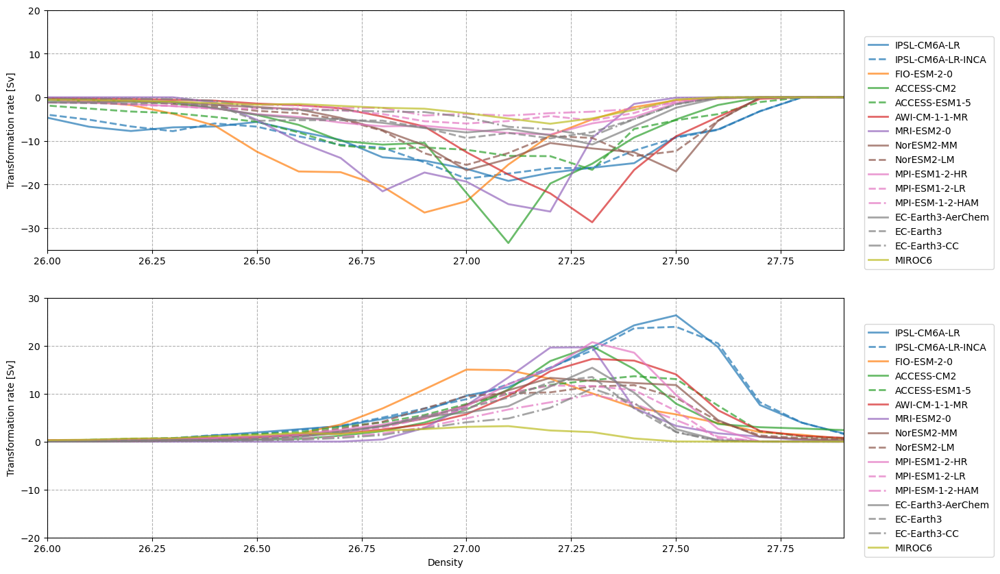

In [95]:
colors = plt.cm.tab10.colors
fig, axs = plt.subplots(nrows = 2, ncols = 1, figsize=(15,10))

index_color = 0
index_model = 0

# Plot the hf of each model with legend
for series, models in model_series.items():
    line_styles = ['-', '--', '-.', ':']
    color = colors[index_color]
    index_color = index_color + 1
    for model in models:
        data = model_data[model]
        fsi_melt_tr_in_density = data['fsi_melt_tr_in_density'] / 12
        fsi_form_tr_in_density = data['fsi_form_tr_in_density'] / 12
        
        line_style = line_styles.pop(0)  # Pop the first line style for the current series
        fsi_melt_tr_in_density .plot(label=f'{model}', 
                                        linestyle=line_style,
                                        linewidth=2,
                                        color=color, 
                                        alpha=0.7,
                                        ax = axs[0])  # Replace 'mix' with 'hf'
        fsi_form_tr_in_density .plot(label=f'{model}', 
                                        linestyle=line_style,
                                        linewidth=2,
                                        color=color, 
                                        alpha=0.7,
                                        ax = axs[1]) 
        index_model = index_model + 1  
# Add labels, title, legend, etc.
for ax in axs:
    ax.set_xlabel('')
    ax.set_ylabel('Transformation rate [Sv]')
    # ax.set_title(f'Water mass transformation of {data_name_list[index]} in Each Model')
    # ax.set_title(f'{data_name_list[index]}')
    ax.legend(loc='lower left', bbox_to_anchor=(1.02, -0.1))  # Set the legend at the left bottom
    # ax.set_xticks(mean_data.density)
    ax.grid(True,linestyle='--')
    ax.set_xlim(26,27.9)
    ax.set_ylim(-35,20)
axs[-1].set_ylim(-20,30)
axs[-1].set_xlabel('Density')
# plt.savefig('/g/data/jk72/zc0441/Subject_1/Figure/Transf_seaice_den_noCNRM.png', bbox_inches='tight')
plt.show()

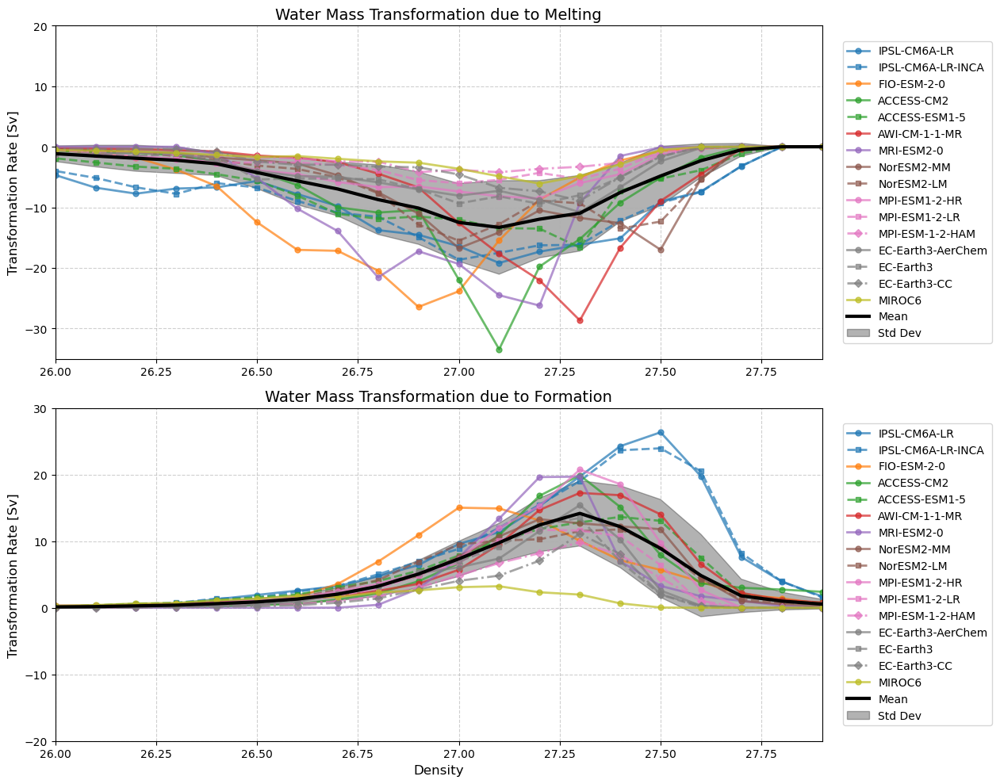

In [96]:
colors = plt.cm.tab10.colors
fig, axs = plt.subplots(nrows=2, ncols=1, figsize=(15,10))

index_color = 0
index_model = 0

# Store all models' data to calculate the mean later
all_melt_data = []
all_form_data = []

# Plot the hf of each model with legend
for series, models in model_series.items():
    line_styles = ['-', '--', '-.', ':']
    markers = ['o', 's', 'D', '^']  # Different markers for distinction
    color = colors[index_color]
    index_color = index_color + 1
    for model in models:
        data = model_data[model]
        fsi_melt_tr_in_density = data['fsi_melt_tr_in_density'] / 12
        fsi_form_tr_in_density = data['fsi_form_tr_in_density'] / 12

        # Append data to the lists for mean calculation
        all_melt_data.append(fsi_melt_tr_in_density)
        all_form_data.append(fsi_form_tr_in_density)

        line_style = line_styles.pop(0)  # Pop the first line style for the current series
        marker = markers.pop(0)  # Pop the first marker for the current series
        fsi_melt_tr_in_density.plot(label=f'{model}', 
                                    linestyle=line_style,
                                    marker=marker,
                                    markersize=5,
                                    linewidth=2,
                                    color=color, 
                                    alpha=0.7,
                                    ax=axs[0])
        fsi_form_tr_in_density.plot(label=f'{model}', 
                                    linestyle=line_style,
                                    marker=marker,
                                    markersize=5,
                                    linewidth=2,
                                    color=color, 
                                    alpha=0.7,
                                    ax=axs[1])
        index_model = index_model + 1  

# Calculate the mean of all models' data
# mean_data = xr.concat(data, dim='model').mean(dim='model')
# std_data = xr.concat(data, dim='model').std(dim='model')
mean_melt_tr_in_density = xr.concat(all_melt_data, dim='model').mean(dim='model')
std_melt_tr_in_density = xr.concat(all_melt_data, dim='model').std(dim='model')
mean_form_tr_in_density = xr.concat(all_form_data, dim='model').mean(dim='model')
std_form_tr_in_density = xr.concat(all_form_data, dim='model').std(dim='model')

# Plot the mean lines
mean_melt_tr_in_density.plot(label='Mean', 
                             linestyle='-', 
                             linewidth=3, 
                             color='black', 
                             ax=axs[0])
axs[0].fill_between(mean_melt_tr_in_density.density, mean_melt_tr_in_density - std_melt_tr_in_density, mean_melt_tr_in_density + std_melt_tr_in_density, 
                    alpha=0.3, 
                    color='k', 
                    label='Std Dev')
mean_form_tr_in_density.plot(label='Mean', 
                             linestyle='-', 
                             linewidth=3, 
                             color='black', 
                             ax=axs[1])
axs[1].fill_between(mean_form_tr_in_density.density, mean_form_tr_in_density - std_form_tr_in_density, mean_form_tr_in_density + std_form_tr_in_density, 
                    alpha=0.3, 
                    color='k', 
                    label='Std Dev')



# Add labels, title, legend, etc.
for ax in axs:
    ax.set_xlabel('')
    ax.set_ylabel('Transformation Rate [Sv]', fontsize=12)
    ax.legend(loc='center left', bbox_to_anchor=(1.02, 0.5), fontsize=10)  # Set the legend at the center left
    ax.grid(True, linestyle='--', alpha=0.6)
    ax.set_xlim(26, 27.9)
    ax.set_ylim(-35, 20)
    ax.tick_params(axis='both', which='major', labelsize=10)

# Specific adjustments for the bottom subplot
axs[-1].set_ylim(-20, 30)
axs[-1].set_xlabel('Density', fontsize=12)

# Add titles to each subplot for clarity
axs[0].set_title('Water Mass Transformation due to Melting', fontsize=14)
axs[1].set_title('Water Mass Transformation due to Formation', fontsize=14)

plt.tight_layout(rect=[0, 0, 0.85, 1])  # Adjust layout to accommodate the legend outside
plt.show()


In [97]:
# # Function to determine the correct coordinate names and create a regridder
# def get_regridder(ds_in, ds_out_latlon, ds_out_lat_lon):
#     if 'latitude' in ds_in.coords and 'longitude' in ds_in.coords:
#         ds_out = ds_out_latlon
#         lat_name, lon_name = 'latitude', 'longitude'
#     elif 'lat' in ds_in.coords and 'lon' in ds_in.coords:
#         ds_out = ds_out_lat_lon
#         lat_name, lon_name = 'lat', 'lon'
#     elif 'nav_lat' in ds_in.coords and 'nav_lon' in ds_in.coords:
#         ds_out = ds_out_lat_lon
#         lat_name, lon_name = 'lat', 'lon'
#     else:
#         raise ValueError("Input data is missing required coordinates")
    
#     regridder = xe.Regridder(ds_in, ds_out, 'bilinear')
#     return regridder, lat_name, lon_name

### Contribution within density class

In [98]:
total_map_list = []
fsi_map_list = []
density_map_list = []
density_Sep_map_list = []
sic_Sep_map_list = []


new_lat_values = np.arange(-90, 0, 0.5)
new_lon_values = np.arange(0, 360, 2)
ds_out_latlon = xr.Dataset({'latitude': (['latitude'], new_lat_values),
                            'longitude': (['longitude'], new_lon_values)})

for model in model_list_fsi_rank[:5] + model_list_fsi_rank[6:] :
    data = model_data[model]
    ds_for_regrid = data['buo_total_map']
    fsi_ds_for_regrid = data['buo_fsi_map']
    density_ds_for_regrid = data['surface_density_mean_mon'].mean('month')
    density_Sep_ds_for_regrid = data['surface_density_mean_mon'].sel(month = 9)
    sic_Sep_ds_for_regrid = data['sic_mean_mon'].sel(month = 9)
    ds_for_regrid_si = sic_Sep_ds_for_regrid
    if 'IPSL' in model:
        ds_for_regrid = ds_for_regrid.rename({'nav_lat': 'latitude', 'nav_lon': 'longitude'})
        ds_for_regrid_si = sic_Sep_ds_for_regrid.rename({'nav_lat': 'latitude', 'nav_lon': 'longitude'})
        
    # get_regridder
    # Create the target grid with a uniform spacing of 4 degrees in latitude and longitude
    
    ds_in = ds_for_regrid
    ds_in_si = ds_for_regrid_si
    ds_out = ds_out_latlon
    if 'IPSL' or 'NorESM' in model:
        regridder = xe.Regridder(ds_in, ds_out, 'bilinear', ignore_degenerate=True)
        regridder_si = xe.Regridder(ds_in_si, ds_out, 'bilinear', ignore_degenerate=True)
    else:
        regridder = xe.Regridder(ds_in, ds_out, 'bilinear')
        regridder_si = xe.Regridder(ds_in_si, ds_out, 'bilinear')
        
    ds_regrided = regridder(ds_for_regrid)
    fsi_ds_regrided = regridder(fsi_ds_for_regrid)
    density_ds_regrided = regridder(density_ds_for_regrid)
    density_Sep_ds_regrided = regridder(density_Sep_ds_for_regrid)
    sic_Sep_ds_regrided = regridder_si(sic_Sep_ds_for_regrid)
    
    total_map_list.append(ds_regrided)
    fsi_map_list.append(fsi_ds_regrided)
    density_map_list.append(density_ds_regrided)
    density_Sep_map_list.append(density_Sep_ds_regrided)
    sic_Sep_map_list.append(sic_Sep_ds_regrided)


--------------------------------------------------------------------------
but there are no active ports detected (or Open MPI was unable to use
them).  This is most certainly not what you wanted.  Check your
cables, subnet manager configuration, etc.  The openib BTL will be
ignored for this job.

  Local host: gadi-cpu-bdw-0032
--------------------------------------------------------------------------
/g/data/hh5/public/apps/miniconda3/envs/analysis3-24.04/lib/python3.10/site-packages/xesmf/backend.py:56: UserWarning: Latitude is outside of [-90, 90]
  warnings.warn('Latitude is outside of [-90, 90]')


In [99]:
total_map = xr.concat(total_map_list, dim='model')
fsi_map = xr.concat(fsi_map_list, dim='model')
density_map = xr.concat(density_map_list, dim='model')
density_Sep_map = xr.concat(density_Sep_map_list, dim='model')
sic_Sep_map = xr.concat(sic_Sep_map_list, dim='model')


In [100]:
# Assuming density_map is your xarray DataArray or Dataset
fsi_map_mean = fsi_map.where(fsi_map != 0).mean('model', skipna=True)
total_map_mean = total_map.where(fsi_map != 0).mean('model', skipna=True)
density_map_mean = density_map.where(density_map != 0).mean('model', skipna=True)
density_Sep_map_mean = density_Sep_map.where(density_Sep_map != 0).mean('model', skipna=True)
sic_Sep_map_mean = sic_Sep_map.where(sic_Sep_map != 0).mean('model', skipna=True)


# Convert 0 values to NaN
density_map_mean = density_map_mean.where(density_map_mean != 0, np.nan)                                 
# density_map_mean.plot(levels=np.arange(1025, 1028, 0.1),)

In [101]:
colors = plt.cm.tab10.colors
index_color = 0
index_model = 0

# Store all models' data to calculate the mean later
all_melt_data = []
all_form_data = []
all_hfds_data = []
all_wfo_data = []

# Plot the hf of each model with legend
for series, models in model_series.items():
    line_styles = ['-', '--', '-.', ':']
    markers = ['o', 's', 'D', '^']  # Different markers for distinction
    color = colors[index_color]
    index_color = index_color + 1
    for model in models:
        data = model_data[model]
        fsi_melt_tr_in_density = data['fsi_melt_tr_in_density'] / 12
        fsi_form_tr_in_density = data['fsi_form_tr_in_density'] / 12
        wfo_tr_in_density = data['wfo_tr_in_density'] / 12
        hfds_tr_in_density = data['hfds_tr_in_density'] / 12
        

        # Append data to the lists for mean calculation
        all_melt_data.append(fsi_melt_tr_in_density)
        all_form_data.append(fsi_form_tr_in_density)
        all_hfds_data.append(hfds_tr_in_density)
        all_wfo_data.append(wfo_tr_in_density)

# Calculate the mean of all models' data
# mean_data = xr.concat(data, dim='model').mean(dim='model')
# std_data = xr.concat(data, dim='model').std(dim='model')

hfds_tr_in_density = xr.concat(all_hfds_data, dim='model')
wfo_tr_in_density = xr.concat(all_wfo_data, dim='model')
melt_tr_in_density = xr.concat(all_melt_data, dim='model')
form_tr_in_density = xr.concat(all_form_data, dim='model')
fsi_tr_in_density = melt_tr_in_density + form_tr_in_density
nonsi_wfo_tr_in_density = wfo_tr_in_density - fsi_tr_in_density
total_tr_in_density = hfds_tr_in_density + wfo_tr_in_density


mean_melt_tr_in_density = melt_tr_in_density.mean(dim='model')
std_melt_tr_in_density = melt_tr_in_density.std(dim='model')
mean_form_tr_in_density = form_tr_in_density.mean(dim='model')
std_form_tr_in_density = form_tr_in_density.std(dim='model')
mean_hfds_tr_in_density = hfds_tr_in_density.mean(dim='model')
std_hfds_tr_in_density = hfds_tr_in_density.std(dim='model')
mean_wfo_tr_in_density = wfo_tr_in_density.mean(dim='model')
std_wfo_tr_in_density = wfo_tr_in_density.std(dim='model')

std_nonsi_wfo_tr_in_density = nonsi_wfo_tr_in_density.std(dim='model')
std_total_tr_in_density = total_tr_in_density.std(dim='model')
std_fsi_tr_in_density = fsi_tr_in_density.std(dim='model')



# Plot the mean lines
mean_fsi_tr_in_density = mean_melt_tr_in_density + mean_form_tr_in_density
mean_nonsi_wfo_tr_in_density = mean_wfo_tr_in_density - mean_fsi_tr_in_density
mean_total_tr_in_density = mean_hfds_tr_in_density + mean_wfo_tr_in_density

# Plot of formation rate
mean_fsi_fr_in_density = tr_to_fr(mean_fsi_tr_in_density)
mean_nonsi_wfo_fr_in_density = tr_to_fr(mean_nonsi_wfo_tr_in_density)
mean_hfds_fr_in_density = tr_to_fr(mean_hfds_tr_in_density)
mean_total_fr_in_density = mean_fsi_fr_in_density+mean_nonsi_wfo_fr_in_density+mean_hfds_fr_in_density

###======For models near obs feeze/melt===#
co_mean_melt_tr_in_density = melt_tr_in_density.sel(model=slice(2,6)).mean(dim='model')
co_std_melt_tr_in_density = melt_tr_in_density.sel(model=slice(2,6)).std(dim='model')
co_mean_form_tr_in_density = form_tr_in_density.sel(model=slice(2,6)).mean(dim='model')
co_std_form_tr_in_density = form_tr_in_density.sel(model=slice(2,6)).std(dim='model')
co_mean_hfds_tr_in_density = hfds_tr_in_density.sel(model=slice(2,6)).mean(dim='model')
co_std_hfds_tr_in_density = hfds_tr_in_density.sel(model=slice(2,6)).std(dim='model')
co_mean_wfo_tr_in_density = wfo_tr_in_density.sel(model=slice(2,6)).mean(dim='model')
co_std_wfo_tr_in_density = wfo_tr_in_density.sel(model=slice(2,6)).std(dim='model')

co_std_nonsi_wfo_tr_in_density = nonsi_wfo_tr_in_density.sel(model=slice(2,6)).std(dim='model')
co_std_total_tr_in_density = total_tr_in_density.sel(model=slice(2,6)).std(dim='model')
co_std_fsi_tr_in_density = fsi_tr_in_density.sel(model=slice(2,6)).std(dim='model')

# Plot the mean lines
co_mean_fsi_tr_in_density = co_mean_melt_tr_in_density + co_mean_form_tr_in_density
co_mean_nonsi_wfo_tr_in_density = co_mean_wfo_tr_in_density - co_mean_fsi_tr_in_density
co_mean_total_tr_in_density = co_mean_hfds_tr_in_density + co_mean_wfo_tr_in_density

# Plot of formation rate
co_mean_fsi_fr_in_density = tr_to_fr(co_mean_fsi_tr_in_density)
co_mean_nonsi_wfo_fr_in_density = tr_to_fr(co_mean_nonsi_wfo_tr_in_density)
co_mean_hfds_fr_in_density = tr_to_fr(co_mean_hfds_tr_in_density)
co_mean_total_fr_in_density = co_mean_fsi_fr_in_density+co_mean_nonsi_wfo_fr_in_density+co_mean_hfds_fr_in_density

In [201]:
cancellation_rate = (1-abs(melt_tr_in_density + form_tr_in_density).sum(dim='density')/(abs(melt_tr_in_density) + form_tr_in_density).sum(dim='density'))
for model, rate in zip(model_list_fsi_rank, cancellation_rate):
    print(f"Model: {model}, Cancellation Rate: {rate.values : .2f}")

Model: IPSL-CM6A-LR, Cancellation Rate:  0.61
Model: IPSL-CM6A-LR-INCA, Cancellation Rate:  0.60
Model: FIO-ESM-2-0, Cancellation Rate:  0.54
Model: ACCESS-CM2, Cancellation Rate:  0.58
Model: ACCESS-ESM1-5, Cancellation Rate:  0.65
Model: AWI-CM-1-1-MR, Cancellation Rate:  0.77
Model: MRI-ESM2-0, Cancellation Rate:  0.48
Model: NorESM2-MM, Cancellation Rate:  0.79
Model: NorESM2-LM, Cancellation Rate:  0.79
Model: MPI-ESM1-2-HR, Cancellation Rate:  0.59
Model: EC-Earth3-AerChem, Cancellation Rate:  0.63
Model: EC-Earth3, Cancellation Rate:  0.61
Model: MPI-ESM1-2-LR, Cancellation Rate:  0.74
Model: EC-Earth3-CC, Cancellation Rate:  0.73
Model: MPI-ESM-1-2-HAM, Cancellation Rate:  0.77
Model: MIROC6, Cancellation Rate:  0.76


In [105]:
flip_density = abs(total_tr_in_density.sel(density=slice(26.5, 27.6))).idxmin(dim='density')
max_density = total_tr_in_density.sel(density = slice(26.5,27.6)).idxmax(dim='density')
min_density = total_tr_in_density.sel(density = slice(26.5,27.6)).idxmin(dim='density')

In [106]:
# Sea ice contribution in each cell of MOC
si_uppercell = fsi_tr_in_density.sel(density=flip_density) - fsi_tr_in_density.sel(density=min_density)
si_lowercell = fsi_tr_in_density.sel(density=max_density) - fsi_tr_in_density.sel(density=flip_density)

In [107]:
# (si_lowercell+si_uppercell).std()
si_lowercell.mean()

<xarray.DataArray ()> Size: 8B
array(5.12646004)

In [209]:
den_range = slice(26.6, 27.5)
# den_range = slice(26.6, 27.2)
des_region_total_formation = mean_total_fr_in_density.sel(density = den_range).sum().values
des_region_total_std = tr_to_fr(total_tr_in_density).sel(density = den_range).sum(dim = 'density').std().values

des_region_nonsi_wfo_formation = mean_nonsi_wfo_fr_in_density.sel(density = den_range).sum().values
des_region_hfds_formation = mean_hfds_fr_in_density.sel(density = den_range).sum().values
des_region_fsi_formation = mean_fsi_fr_in_density.sel(density = den_range).sum().values
for_276_total_formation = mean_total_fr_in_density.sel(density = slice(27.5, 28.3)).sum().values
for_265_total_formation = mean_total_fr_in_density.sel(density = slice(25.5, 26.6)).sum().values

print(f'Total: {des_region_total_formation:.2f} Sv, std {des_region_total_std:.2f}'
      f'\nHeat: {des_region_hfds_formation:.2f} Sv, '
      f'\nNon-SI FW: {des_region_nonsi_wfo_formation:.2f} Sv, '
      f'\nSea ice: {des_region_fsi_formation:.2f} Sv')

Total: -42.39 Sv, std 14.61
Heat: -15.05 Sv, 
Non-SI FW: -18.93 Sv, 
Sea ice: -8.41 Sv


In [213]:
print(f'To upper cell: {mean_total_tr_in_density.min().values:.2f} Sv',
      f'\nTo lower cell: {mean_total_tr_in_density.max().values:.2f} Sv',
)

To upper cell: -36.79 Sv 
To lower cell: 5.65 Sv


In [215]:
print(
    # f'Total: {des_region_total_formation:.2f} Sv, std {des_region_total_std:.2f}'
      f'\nHeat portion: {des_region_hfds_formation/des_region_total_formation:.2f}, '
      f'\nNon-SI FW portion: {des_region_nonsi_wfo_formation/des_region_total_formation:.2f}, '
      f'\nSea ice portion: {des_region_fsi_formation/des_region_total_formation:.2f}')


Heat portion: 0.35, 
Non-SI FW portion: 0.45, 
Sea ice portion: 0.20


In [218]:
den_range = slice(27.0, 27.5)
si_region_total_formation = mean_total_fr_in_density.sel(density = den_range).sum().values
si_region_nonsi_wfo_formation = mean_nonsi_wfo_fr_in_density.sel(density = den_range).sum().values
si_region_hfds_formation = mean_hfds_fr_in_density.sel(density = den_range).sum().values
si_region_fsi_formation = mean_fsi_fr_in_density.sel(density = den_range).sum().values
si_region_fsi_formation_std = tr_to_fr(fsi_tr_in_density).sel(density = den_range).sum(dim = 'density').std()

print(f'Total: {si_region_total_formation:.2f} Sv, '
      f'\nHeat: {si_region_hfds_formation:.2f} Sv, '
      f'\nNon-SI FW: {si_region_nonsi_wfo_formation:.2f} Sv, '
      f'\nSea ice: {si_region_fsi_formation:.2f} Sv, '
      f'std: {si_region_fsi_formation_std:.2f} Sv'
        )

Total: -22.24 Sv, 
Heat: 1.83 Sv, 
Non-SI FW: -14.84 Sv, 
Sea ice: -9.23 Sv, std: 7.85 Sv


In [220]:
print(
      f'Portions in sea ice region'
      f'\nHeat portion: {si_region_hfds_formation/si_region_total_formation:.2f}, '
      f'\nNon-SI FW portion: {si_region_nonsi_wfo_formation/si_region_total_formation:.2f}, '
      f'\nSea ice portion: {si_region_fsi_formation/si_region_total_formation:.2f}')

Portions in sea ice region
Heat portion: -0.08, 
Non-SI FW portion: 0.67, 
Sea ice portion: 0.42


In [111]:
den_range = slice(27.0, 27.2)
si_region_total_formation = mean_total_fr_in_density.sel(density = den_range).sum().values
si_region_nonsi_wfo_formation = mean_nonsi_wfo_fr_in_density.sel(density = den_range).sum().values
si_region_hfds_formation = mean_hfds_fr_in_density.sel(density = den_range).sum().values
si_region_fsi_formation = mean_fsi_fr_in_density.sel(density = den_range).sum().values
si_region_fsi_formation_std = tr_to_fr(fsi_tr_in_density).sel(density = den_range).sum(dim = 'density').std()

print(f'Total: {si_region_total_formation:.2f} Sv, '
      f'\nHeat: {si_region_hfds_formation:.2f} Sv, '
      f'\nNon-SI FW: {si_region_nonsi_wfo_formation:.2f} Sv, '
      f'\nSea ice: {si_region_fsi_formation:.2f} Sv, '
      f'std: {si_region_fsi_formation_std:.2f} Sv'
        )

Total: -14.85 Sv, 
Heat: -2.90 Sv, 
Non-SI FW: -6.33 Sv, 
Sea ice: -5.62 Sv, std: 4.46 Sv


In [222]:
den_range = slice(27.1, 27.5)
si_region_total_formation = co_mean_total_fr_in_density.sel(density = den_range).sum().values
si_region_nonsi_wfo_formation = co_mean_nonsi_wfo_fr_in_density.sel(density = den_range).sum().values
si_region_hfds_formation = co_mean_hfds_fr_in_density.sel(density = den_range).sum().values
si_region_fsi_formation = co_mean_fsi_fr_in_density.sel(density = den_range).sum().values
si_region_fsi_formation_std = tr_to_fr(fsi_tr_in_density).sel(density = den_range).sum(dim = 'density').std()

print(f'Total: {si_region_total_formation:.2f} Sv, '
      f'\nHeat: {si_region_hfds_formation:.2f} Sv, '
      f'\nNon-SI FW: {si_region_nonsi_wfo_formation:.2f} Sv, '
      f'\nSea ice: {si_region_fsi_formation:.2f} Sv, '
      f'std: {si_region_fsi_formation_std:.2f} Sv'
        )
print(
      f'===Portions in sea ice region==='
      f'\nHeat portion: {si_region_hfds_formation/si_region_total_formation:.2f}, '
      f'\nNon-SI FW portion: {si_region_nonsi_wfo_formation/si_region_total_formation:.2f}, '
      f'\nSea ice portion: {si_region_fsi_formation/si_region_total_formation:.2f}')

Total: -21.40 Sv, 
Heat: 3.61 Sv, 
Non-SI FW: -11.16 Sv, 
Sea ice: -13.85 Sv, std: 9.09 Sv
===Portions in sea ice region===
Heat portion: -0.17, 
Non-SI FW portion: 0.52, 
Sea ice portion: 0.65


In [113]:
def plot_correlation_for_des(xx, yy, model_list_p):
    model_series = {}
    xx_series = {}
    yy_series = {}
    
    for x,y,model in zip(xx,yy,model_list_p):
        series = model.split('-')[0]  # Assuming the series is the part before the first '-'
        if series not in model_series:
            model_series[series] = []
            xx_series[series] = []
            yy_series[series] = []
        model_series[series].append(model)
        xx_series[series].append(x)
        yy_series[series].append(y)
     
    colors = plt.cm.tab10.colors
    index_color = 0 # the index for selecting model and color
    index_model = 0
    # Set the figure size
    plt.figure(figsize=(10, 6))
    
    for series, models in model_series.items():
        marker_styles = ['o', 's', '+', 'x']
        color = colors[index_color]
        index_color = index_color + 1
        xx1 = xx_series[series]
        yy1 = yy_series[series]
         
        # Scatter plot
        for x, y, model in zip(xx1, yy1, models):
            marker_style = marker_styles.pop(0)  # Pop the first line style for the current series        
            plt.scatter(x, y, 
                        label=model ,
                        marker =  marker_style,
                        color = color,
                        )
            index_model = index_model + 1
    
    # Compute linear regression
    slope, intercept, r_value, p_value, std_err = linregress(xx, yy)
    
    # Calculate regression line
    regression_line = slope * np.array(xx) + intercept
    
    # Plot the regression line
    plt.plot(xx, regression_line, color='red', label='Regression line')
    
    # Add correlation and regression equation to the plot
    plt.text(0.1, 0.9, f'r_value: {r_value:.2f}\np-value: {p_value:.4f}\nSlope: {slope:.2f}\nIntercept: {intercept:.2f}', transform=plt.gca().transAxes, fontsize=10, verticalalignment='top')
    
    
    # Add labels and title
    plt.xlabel('Freeze and melt rate[Sv]')
    plt.ylabel('Water mass destruction due to sea ice [Sv]')

    plt.ylim(-20, 25)
    # plt.title('Scatter plot with Linear Regression')
    plt.grid(linestyle = '--', alpha = 0.7)
    # Add legend
    plt.legend(loc = 'lower right', ncol=4)

    # Show plot
    plt.show()

In [114]:
def plot_correlation_for_des(ax, xx, yy, model_list_p):
    model_series = {}
    xx_series = {}
    yy_series = {}
    
    for x, y, model in zip(xx, yy, model_list_p):
        series = model.split('-')[0]  # Assuming the series is the part before the first '-'
        if series not in model_series:
            model_series[series] = []
            xx_series[series] = []
            yy_series[series] = []
        model_series[series].append(model)
        xx_series[series].append(x)
        yy_series[series].append(y)
     
    colors = plt.cm.tab10.colors
    index_color = 0  # the index for selecting model and color
    index_model = 0
    
    for series, models in model_series.items():
        marker_styles = ['o', 's', '+', 'x']
        color = colors[index_color]
        index_color += 1
        xx1 = xx_series[series]
        yy1 = yy_series[series]
         
        # Scatter plot
        for x, y, model in zip(xx1, yy1, models):
            marker_style = marker_styles.pop(0)  # Pop the first line style for the current series        
            ax.scatter(x, y, 
                        label=model,
                        marker=marker_style,
                        color=color)
            index_model += 1
    
    # Compute linear regression
    slope, intercept, r_value, p_value, std_err = linregress(xx, yy)
    
    # Calculate regression line
    regression_line = slope * np.array(xx) + intercept
    
    # Plot the regression line
    ax.plot(xx, regression_line, color='red', label='Regression line')
    
    # Add correlation and regression equation to the plot
    ax.text(0.1, 0.9, f'r_value: {r_value:.2f}\np-value: {p_value:.4f}\nSlope: {slope:.2f}\nIntercept: {intercept:.2f}', transform=ax.transAxes, fontsize=10, verticalalignment='top')
    
    # Set y-axis limits
    ax.set_ylim(-5, 25)
    
    # Add labels and title
    ax.set_xlabel('Freeze and melt rate[Sv]')
    ax.set_ylabel('Water mass destruction due to sea ice [Sv]')
    ax.grid(linestyle='--', alpha=0.7)
    
    # Add legend
    ax.legend(loc='lower right', ncol=4, bbox_to_anchor=(1, -0.5))


In [115]:
fsi_form

[0.6039551146666667,
 0.5964494933333333,
 0.3689288533333333,
 0.3778536533333334,
 0.375759232,
 0.39897961784232144,
 0.28778634666666664,
 0.33646284800000004,
 0.32836908800000003,
 0.38622067200000004,
 0.24890257066666666,
 0.24273390933333336,
 0.26840390399999997,
 0.16186417066666667,
 0.192703552,
 0.09561223466666667]

In [116]:
fsi_form_melt_mean_rate = xr.DataArray((np.array(fsi_form) + np.array(fsi_melt))/2)

In [117]:
total_tr_in_density.min(dim = 'density')

<xarray.DataArray (model: 16)> Size: 128B
array([-38.84245984, -39.04126281, -68.2442175 , -41.17289266,
       -34.20803932, -41.00101949, -71.1201424 , -25.2414327 ,
       -26.75115557, -46.74869546, -47.10900516, -46.09404582,
       -31.16583122, -30.5587858 , -33.64337677, -31.30942571])
Dimensions without coordinates: model

In [118]:
des_in_models = tr_to_fr(fsi_tr_in_density).sel(density =slice(27.0,27.5)).sum(dim='density')
min_fsi_tr_model = fsi_tr_in_density.min(dim='density') # minimun transformation rate in model

In [119]:
des_in_models_hfds = tr_to_fr(hfds_tr_in_density).sel(density =slice(27.0,27.5)).sum(dim='density')
des_in_models_wfo = tr_to_fr(wfo_tr_in_density).sel(density =slice(27.0,27.5)).sum(dim='density')
des_in_models_total = des_in_models_wfo + des_in_models_hfds

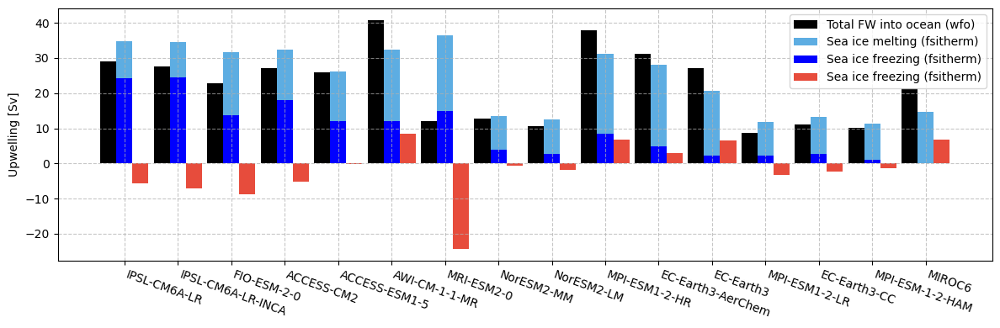

In [120]:
des_in_models_wfo 

# Bar plot
bar_width = 0.30
bar_positions = range(len(mf_fsi_models))

fig, ax = plt.subplots(figsize = (12,4))

# bar1 = ax.bar([pos + 0 *bar_width for pos in bar_positions], epr_sum_list, bar_width, label='Freshwater flux from land and atmosphere', color = '#F1948A')
bar1 = ax.bar([pos + 0 *bar_width for pos in bar_positions], -des_in_models_total, bar_width, label='Total FW into ocean (wfo)', color = 'k')
bar2 = ax.bar([pos + 1*bar_width for pos in bar_positions], -des_in_models_wfo, bar_width, label='Sea ice melting (fsitherm)',color = '#5DADE2')
bar3 = ax.bar([pos + 1*bar_width for pos in bar_positions], -des_in_models, bar_width, label='Sea ice freezing (fsitherm)', color = 'b')
bar4 = ax.bar([pos + 2*bar_width for pos in bar_positions], -des_in_models_hfds, bar_width, label='Sea ice freezing (fsitherm)', color = '#E74C3C')



ax.set_xticks([pos + 1 * bar_width for pos in bar_positions])
ax.set_xticklabels(mf_fsi_models, rotation=-20, ha='left') 
ax.legend()

# plt.xlabel('Model')
plt.ylabel('Upwelling [Sv]')
# plt.title('Fresh and Dense Values for Each Model')
plt.grid(linestyle = '--', alpha = 0.7)
plt.tight_layout() 
# plt.savefig('melt_and_form.png')
plt.show()

In [121]:
-des_in_models[2:7].mean()
# -des_in_models_total[2:7].mean()


<xarray.DataArray ()> Size: 8B
array(14.16936425)

In [122]:
# cancellation_rate
fsi_form_melt_mean_rate

<xarray.DataArray (dim_0: 16)> Size: 128B
array([0.68168759, 0.67171343, 0.49736766, 0.48295972, 0.45977186,
       0.446444  , 0.42864801, 0.39896589, 0.38608724, 0.33628557,
       0.28167678, 0.27567924, 0.23463246, 0.18373708, 0.16850398,
       0.12511358])
Dimensions without coordinates: dim_0

### Correlation plots

In [123]:
len(fsi_form_melt_mean_rate)

16

In [124]:
fsi_form_melt_mean_rate

<xarray.DataArray (dim_0: 16)> Size: 128B
array([0.68168759, 0.67171343, 0.49736766, 0.48295972, 0.45977186,
       0.446444  , 0.42864801, 0.39896589, 0.38608724, 0.33628557,
       0.28167678, 0.27567924, 0.23463246, 0.18373708, 0.16850398,
       0.12511358])
Dimensions without coordinates: dim_0

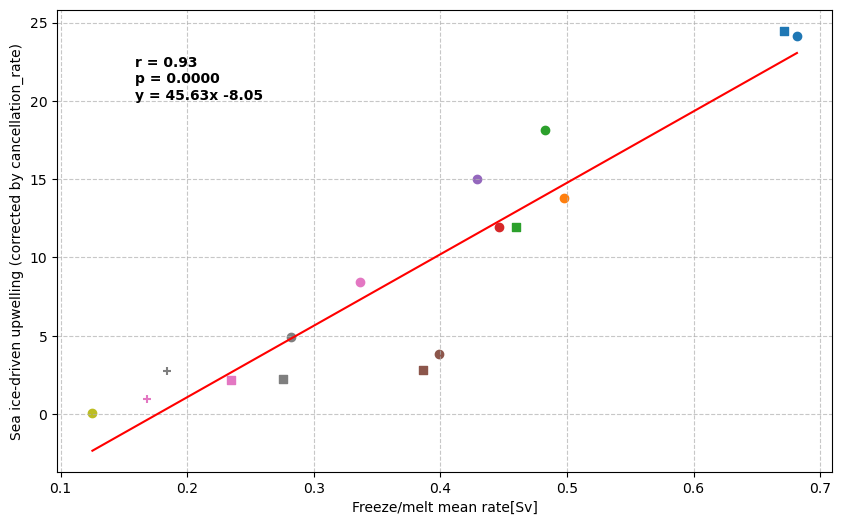

In [125]:
xx = fsi_form_melt_mean_rate
# xx = fsi_annual_melt_list
# fsi_annual_freeze_list
# xx = -des_in_models_wfo
# yy = cancellation_rate
yy = -des_in_models /(1- cancellation_rate) * 0.6
# yy = 
yy = -des_in_models
# yy = -min_fsi_tr_model
model_list_p = model_list_fsi_rank
x_lab = 'Freeze/melt mean rate[Sv]'
# y_lab = 'Cancellation rate'
y_lab = 'Sea ice-driven upwelling (corrected by cancellation_rate)'

fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(10, 6))

model_series = {}
xx_series = {}
yy_series = {}

for x,y,model in zip(xx,yy,model_list_p):
    series = model.split('-')[0]  # Assuming the series is the part before the first '-'
    if series not in model_series:
        model_series[series] = []
        xx_series[series] = []
        yy_series[series] = []
    model_series[series].append(model)
    xx_series[series].append(x)
    yy_series[series].append(y)
 
colors = plt.cm.tab10.colors
index_color = 0 # the index for selecting model and color
index_model = 0
# Set the figure size
# plt.figure(figsize=(10, 6))

for series, models in model_series.items():
    marker_styles = ['o', 's', '+', 'x']
    color = colors[index_color]
    index_color = index_color + 1
    xx1 = xx_series[series]
    yy1 = yy_series[series]
     
    # Scatter plot
    for x, y, model in zip(xx1, yy1, models):
        marker_style = marker_styles.pop(0)  # Pop the first line style for the current series        
        plt.scatter(x, y, 
                    label=model ,
                    marker =  marker_style,
                    color = color,
                    )
        index_model = index_model + 1

# Compute linear regression
slope, intercept, r_value, p_value, std_err = linregress(xx, yy)

# Calculate regression line
regression_line = slope * np.array(xx) + intercept

# Plot the regression line
plt.plot(xx, regression_line, color='red', label='Regression line')

# Add correlation and regression equation to the plot
plt.text(0.1, 0.9, f'r = {r_value:.2f}\np = {p_value:.4f}\ny = {slope:.2f}x {intercept:.2f}', weight='bold', transform=plt.gca().transAxes, fontsize=10, verticalalignment='top')


# Add labels and title
plt.xlabel(x_lab)
plt.ylabel(y_lab)

# plt.ylim(-2, 22)
# plt.title('Scatter plot with Linear Regression')
plt.grid(linestyle = '--', alpha = 0.7)
# Add legend
# plt.legend(loc = 'lower right', ncol=4)

# Show plot
plt.show()
# plot_correlation_for_des(axs, xx, yy, model_list_p)
fig.savefig('plot_correlation_fm_vs_cancel', bbox_inches='tight')


In [126]:
fsi_form_melt_mean_rate

<xarray.DataArray (dim_0: 16)> Size: 128B
array([0.68168759, 0.67171343, 0.49736766, 0.48295972, 0.45977186,
       0.446444  , 0.42864801, 0.39896589, 0.38608724, 0.33628557,
       0.28167678, 0.27567924, 0.23463246, 0.18373708, 0.16850398,
       0.12511358])
Dimensions without coordinates: dim_0

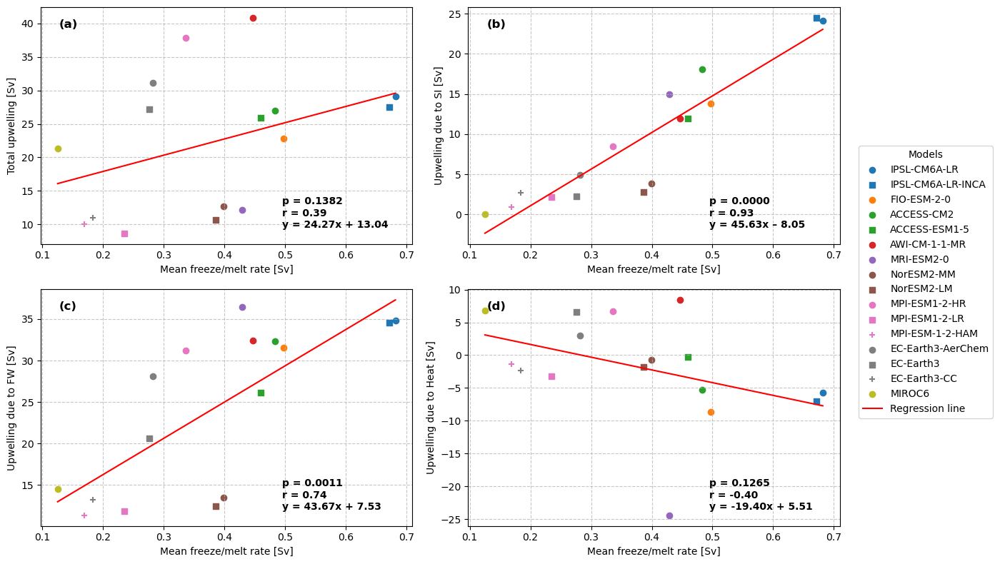

In [127]:
# Define your x and y data pairs
x_data = fsi_form_melt_mean_rate
y_data_list = [-des_in_models_total, -des_in_models , -des_in_models_wfo, -des_in_models_hfds]
y_labels = ['Total upwelling [Sv]', 'Upwelling due to SI [Sv]', 'Upwelling due to FW [Sv]', 'Upwelling due to Heat [Sv]']

# Create subplots
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(12, 8))

axs = axs.flatten()
# Iterate over the different y datasets
for i, (yy, ylabel) in enumerate(zip(y_data_list, y_labels)):
    ax = axs[i]

    model_series = {}
    xx_series = {}
    yy_series = {}

    for x, y, model in zip(x_data, yy, model_list_fsi_rank):
        series = model.split('-')[0]  # Assuming the series is the part before the first '-'
        if series not in model_series:
            model_series[series] = []
            xx_series[series] = []
            yy_series[series] = []
        model_series[series].append(model)
        xx_series[series].append(x)
        yy_series[series].append(y)

    colors = plt.cm.tab10.colors
    index_color = 0
    index_model = 0

    for series, models in model_series.items():
        marker_styles = ['o', 's', '+', 'x']
        color = colors[index_color]
        index_color += 1
        xx1 = xx_series[series]
        yy1 = yy_series[series]

        # Scatter plot
        for x, y, model in zip(xx1, yy1, models):
            marker_style = marker_styles.pop(0)
            handle = ax.scatter(x, y,
                       label=model,
                       marker=marker_style,
                       color=color)
            index_model += 1

    # Compute linear regression
    slope, intercept, r_value, p_value, std_err = linregress(x_data, yy)

    # Calculate regression line
    regression_line = slope * np.array(x_data) + intercept

    # Plot the regression line
    ax.plot(x_data, regression_line, color='red', label='Regression line')

    # Add correlation and regression equation to the plot
    if intercept > 0: 
        ax.text(0.65, 0.2, f'p = {p_value:.4f}\nr = {r_value:.2f}\ny = {slope:.2f}x + {intercept:.2f}',
                weight='bold', transform=ax.transAxes, fontsize=10, verticalalignment='top')
    else:
        ax.text(0.65, 0.2, f'p = {p_value:.4f}\nr = {r_value:.2f}\ny = {slope:.2f}x – {abs(intercept):.2f}',
                weight='bold', transform=ax.transAxes, fontsize=10, verticalalignment='top')        

    # Add labels and title
    ax.set_xlabel('Mean freeze/melt rate [Sv]')
    ax.set_ylabel(ylabel)
    # ax.set_ylim(-2, 22)
    ax.grid(linestyle='--', alpha=0.7)

    # Add subplot label (a), (b), (c), (d)
    ax.text(0.05, 0.95, f'({chr(97+i)})', transform=ax.transAxes, fontsize=12, weight='bold',
            verticalalignment='top', horizontalalignment='left')
    # Add legend
    # ax.legend(loc='lower right', ncol=4)
# Add a single legend for the entire figure
h, l = ax.get_legend_handles_labels()
fig.legend(h, l, loc='center left', bbox_to_anchor=(1, 0.5), ncol=1, title="Models")

# Adjust layout
plt.tight_layout()

fig.savefig('plot_correlation', bbox_inches='tight')

# Show plot
plt.show()


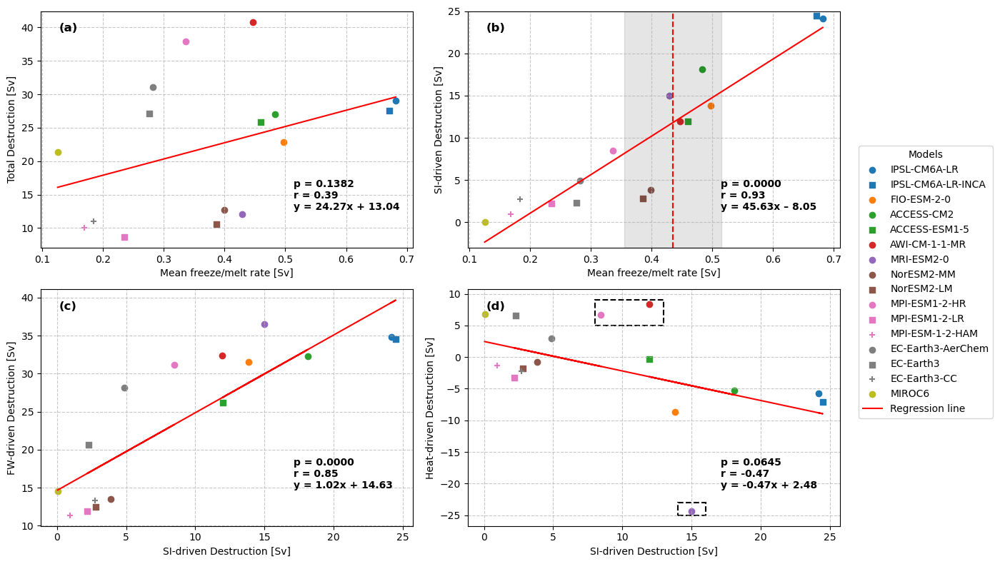

In [146]:
# Define your x and y data pairs
x_data_list = [fsi_form_melt_mean_rate, fsi_form_melt_mean_rate, -des_in_models, -des_in_models]
y_data_list = [-des_in_models_total, -des_in_models , -des_in_models_wfo, -des_in_models_hfds]
x_labels = ['Mean freeze/melt rate [Sv]','Mean freeze/melt rate [Sv]','SI-driven Destruction [Sv]', 'SI-driven Destruction [Sv]']
y_labels = ['Total Destruction [Sv]', 'SI-driven Destruction [Sv]', 'FW-driven Destruction [Sv]', 'Heat-driven Destruction [Sv]']

# Create subplots
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(12, 8))

axs = axs.flatten()
# Iterate over the different y datasets
for i, (xx, xlabel, yy, ylabel) in enumerate(zip(x_data_list, x_labels, y_data_list, y_labels)):
    ax = axs[i]

    model_series = {}
    xx_series = {}
    yy_series = {}

    for x, y, model in zip(xx, yy, model_list_fsi_rank):
        series = model.split('-')[0]  # Assuming the series is the part before the first '-'
        if series not in model_series:
            model_series[series] = []
            xx_series[series] = []
            yy_series[series] = []
        model_series[series].append(model)
        xx_series[series].append(x)
        yy_series[series].append(y)

    colors = plt.cm.tab10.colors
    index_color = 0
    index_model = 0

    for series, models in model_series.items():
        marker_styles = ['o', 's', '+', 'x']
        color = colors[index_color]
        index_color += 1
        xx1 = xx_series[series]
        yy1 = yy_series[series]

        # Scatter plot
        for x, y, model in zip(xx1, yy1, models):
            marker_style = marker_styles.pop(0)
            handle = ax.scatter(x, y,
                       label=model,
                       marker=marker_style,
                       color=color)
            index_model += 1

    # Compute linear regression
    slope, intercept, r_value, p_value, std_err = linregress(xx, yy)

    # Calculate regression line
    regression_line = slope * np.array(xx) + intercept

    # Plot the regression line
    ax.plot(xx, regression_line, color='red', label='Regression line')

    # Plot the obs data
    if i ==1:
        x = 0.435
        y = slope*x + intercept
        # ax.scatter(x, y,label='observation',
        #                    # marker=marker_style,
        #                    color='k')

        ax.fill_betweenx(y=[-3, 25], x1 = x-0.08, x2=x+0.08, color='k', alpha=0.1)
        ax.set_ylim(-3,25)
        ax.axvline(x=x, color='r', linestyle='--')
        # For the last subplot, add boxes to highlight points
    if i == 3:
        # Add the first box
        rect1 = plt.Rectangle((14, -25), 2, 2, linewidth=1.5, edgecolor='k', facecolor='none', linestyle='--')
        ax.add_patch(rect1)

        # # Add the second box
        rect2 = plt.Rectangle((8, 5), 5, 4, linewidth=1.5, edgecolor='k', facecolor='none', linestyle='--')
        ax.add_patch(rect2)
   
        
    # Add correlation and regression equation to the plot
    x_loc = 0.68; y_loc = 0.29
    if i == 5:
        y_loc = 0.90
    if intercept > 0: 
        ax.text(x_loc, y_loc, f'p = {p_value:.4f}\nr = {r_value:.2f}\ny = {slope:.2f}x + {intercept:.2f}',
                weight='bold', transform=ax.transAxes, fontsize=10, verticalalignment='top')
    else:
        ax.text(x_loc, y_loc, f'p = {p_value:.4f}\nr = {r_value:.2f}\ny = {slope:.2f}x – {abs(intercept):.2f}',
                weight='bold', transform=ax.transAxes, fontsize=10, verticalalignment='top')        

    # Add labels and title
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    # ax.set_ylim(-2, 22)
    ax.grid(linestyle='--', alpha=0.7)

    # Add subplot label (a), (b), (c), (d)
    ax.text(0.05, 0.95, f'({chr(97+i)})', transform=ax.transAxes, fontsize=12, weight='bold',
            verticalalignment='top', horizontalalignment='left')
    # Add legend
    # ax.legend(loc='lower right', ncol=4)
# Add a single legend for the entire figure
h, l = ax.get_legend_handles_labels()
fig.legend(h, l, loc='center left', bbox_to_anchor=(1, 0.5), ncol=1, title="Models")

# Adjust layout
plt.tight_layout()

fig.savefig('plot_correlation', bbox_inches='tight')

# Show plot
plt.show()

In [129]:
def plot_arrows(ax, arrow_data):
    """
    Plot arrows on a Cartopy plot.

    Parameters:
    ax (matplotlib.axes.Axes): The axes object to plot the arrows on.
    arrow_data (list of dict): List containing dictionaries with arrow data.
                               Each dictionary should have keys: 'lon_start', 'lat_start', 'lon_end', 'lat_end',
                               'color' (optional), 'arrowstyle' (optional).

    Returns:
    list: List of matplotlib.patches.FancyArrow objects representing each arrow plotted.
    """
    arrows = []
    for arrow in arrow_data:
        lon_start = arrow['lon_start']
        lat_start = arrow['lat_start']
        lon_end = arrow['lon_end']
        lat_end = arrow['lat_end']
        color = arrow.get('color', 'black')
        arrowstyle = arrow.get('arrowstyle', '->')
        linewidth = arrow.get('linewidth', 1.5)
        
        arrow_obj = ax.annotate('', xy=(lon_end, lat_end), xytext=(lon_start, lat_start),
                                arrowprops=dict(facecolor=color, arrowstyle=arrowstyle, edgecolor=color, linewidth=linewidth),
                                transform=ccrs.PlateCarree(),
                                alpha = 0.5
                               )
        arrows.append(arrow_obj)

    return arrows

# Plotting helper function for transformation data
def plot_transformation_data(ax, mean_data, std_data, color, transparency, label):
    mean_data.plot(label=label, linestyle='-', linewidth=3, color=color, ax=ax)
    ax.fill_between(mean_data.density, mean_data - std_data, mean_data + std_data, alpha=transparency, color=color)

In [130]:
co_mean_total_tr_in_density

<xarray.DataArray (density: 40)> Size: 320B
array([ -0.29690167,  -0.38280783,  -0.55592587,  -0.69971376,
        -1.16684257,  -1.62668325,  -3.03165696,  -4.94432966,
        -6.28594677,  -6.91292562, -10.13070209, -16.04237346,
       -17.15495073, -19.58688024, -23.96044344, -23.18973953,
       -22.29463602, -21.25614884, -21.10203937, -27.79667908,
       -37.39977799, -42.00886033, -37.37024795, -33.89753105,
       -28.49626522, -22.70228208, -14.97166339,  -4.51568932,
        -1.46767682,   5.69154917,   6.43022551,   3.70801635,
         2.40914297,   1.7798456 ,   1.28717663,   0.57788715,
         0.38659363,   0.3249068 ,   0.1976592 ,   0.08019646])
Coordinates:
  * density  (density) float64 320B 24.5 24.6 24.7 24.8 ... 28.1 28.2 28.3 28.4

In [131]:
model_list_fsi_rank

['IPSL-CM6A-LR',
 'IPSL-CM6A-LR-INCA',
 'FIO-ESM-2-0',
 'ACCESS-CM2',
 'ACCESS-ESM1-5',
 'AWI-CM-1-1-MR',
 'MRI-ESM2-0',
 'NorESM2-MM',
 'NorESM2-LM',
 'MPI-ESM1-2-HR',
 'EC-Earth3-AerChem',
 'EC-Earth3',
 'MPI-ESM1-2-LR',
 'EC-Earth3-CC',
 'MPI-ESM-1-2-HAM',
 'MIROC6']

### Ensemble of tr/fr plot (models close to obs)

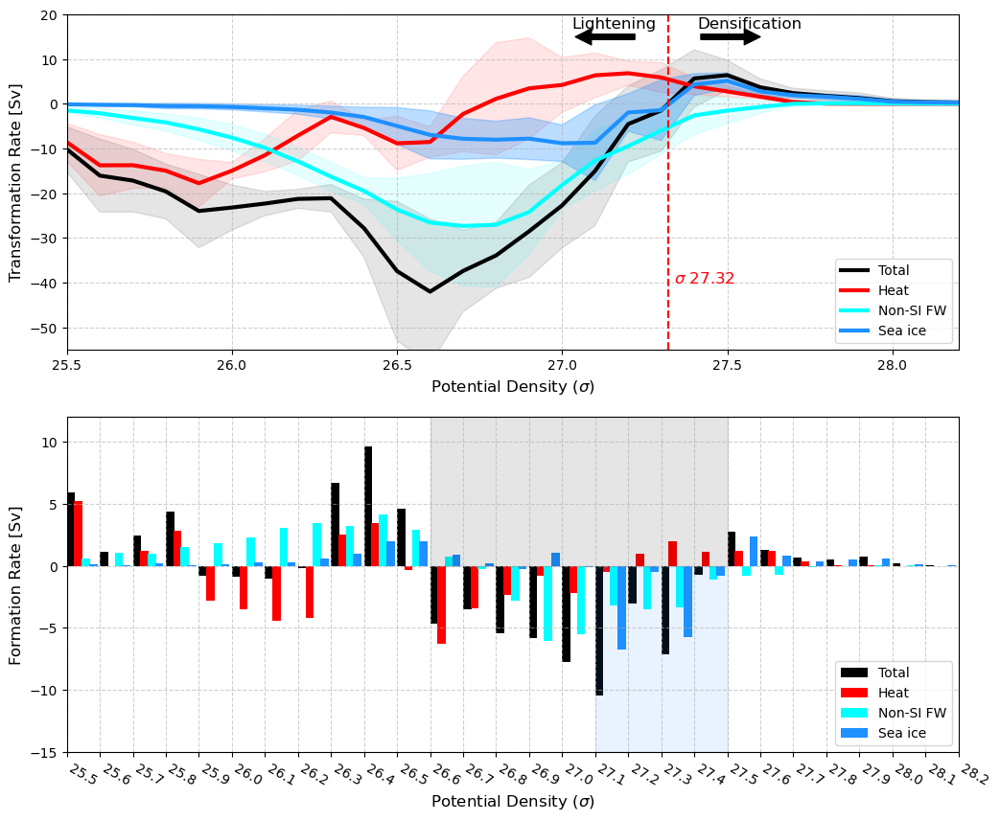

In [132]:
number_data = 4
interval = 0.1
bar_width = interval / number_data
lat_edge = -45  # Assuming lat_edge is defined somewhere
inflection_point = 27.32
# Create a figure
fig, axs = plt.subplots(nrows=2, ncols=1, figsize=(12, 10))
ax1 = axs[0]
ax3 = axs[1]

# =============Plot transformation data=======
plot_transformation_data(ax1, co_mean_total_tr_in_density, co_std_total_tr_in_density, 'k',0.1, 'Total')
plot_transformation_data(ax1, co_mean_hfds_tr_in_density, co_std_hfds_tr_in_density, 'r',0.1, 'Heat')
plot_transformation_data(ax1, co_mean_nonsi_wfo_tr_in_density, co_std_nonsi_wfo_tr_in_density, 'cyan',0.1, 'Non-SI FW')
plot_transformation_data(ax1, co_mean_fsi_tr_in_density, co_std_fsi_tr_in_density, 'dodgerblue',0.3, 'Sea ice')

# add the line of saperation density
ax1.axvline(x=inflection_point, color='r', linestyle='--')
ax1.text(inflection_point + 0.02, -40, rf'$\sigma$ {inflection_point}', fontsize=12, color='r')

# Specific adjustments for transformation subplot
ax1.set_xlim(25.5, 28.2)
ax1.set_ylim(-55, 20)
# ax1.set_title('Water Mass Transformation', fontsize=14)
ax1.legend(loc='lower right', fontsize=10)
ax1.grid(True, linestyle='--', alpha=0.6)
ax1.tick_params(axis='both', which='major', labelsize=10)
ax1.set_ylabel('Transformation Rate [Sv]', fontsize=12)
ax1.set_xlabel('Potential Density ($\sigma$)', fontsize=12)

# Add arrow along the 
x_arrow_start, y_arrow_start = inflection_point-0.09, 15
x_arrow_end, y_arrow_end = x_arrow_start - 0.2, 15
ax1.annotate('', xy=(x_arrow_end, y_arrow_end), xytext=(x_arrow_start, y_arrow_start),
             arrowprops=dict(facecolor='black', shrink=0.05),  # Shrink the arrow by 5% from both ends
            )
ax1.text(x_arrow_end, y_arrow_start+2, 'Lightening', fontsize=12, color='k')

x_arrow_start, y_arrow_start = inflection_point + 0.09, 15
x_arrow_end, y_arrow_end = x_arrow_start + 0.2, 15
ax1.annotate('', xy=(x_arrow_end, y_arrow_end), xytext=(x_arrow_start, y_arrow_start),
             arrowprops=dict(facecolor='black', shrink=0.05),  # Shrink the arrow by 5% from both ends
            )
ax1.text(x_arrow_start, y_arrow_start+2, 'Densification', fontsize=12, color='k')

# =============Plot formation data===========
ax3.bar(co_mean_fsi_fr_in_density.density, co_mean_total_fr_in_density, width=bar_width, color='k', align='edge', label='Total')
ax3.bar(co_mean_fsi_fr_in_density.density + 0.9 * bar_width, co_mean_hfds_fr_in_density, width=bar_width, color='r', align='edge', label='Heat')
ax3.bar(co_mean_fsi_fr_in_density.density + 1.8 * bar_width, co_mean_nonsi_wfo_fr_in_density, width=bar_width, color='cyan', align='edge', label='Non-SI FW')
ax3.bar(co_mean_fsi_fr_in_density.density + 2.7 * bar_width, co_mean_fsi_fr_in_density, width=bar_width, color='dodgerblue', align='edge', label='Sea ice')

# Highlight regions
# ax3.axvspan(26.6, 26.9, color='r', alpha=0.1)
# ax3.axvspan(26.9, 27.5, color='cyan', alpha=0.1)
ax3.fill_betweenx(y=[0, 15], x1=26.6, x2=27.5, color='k', alpha=0.1)
# ax3.fill_betweenx(y=[-10, 0], x1=26.6, x2=26.9, color='r', alpha=0.1)
# ax3.fill_betweenx(y=[-10, 0], x1=26.9, x2=27.5, color='cyan', alpha=0.1)
ax3.fill_betweenx(y=[-15, 0], x1=27.1, x2=27.5, color='dodgerblue', alpha=0.1)

# Add text annotations
# ax3.text(26.6, 9, f'Destruction rate: {des_region_total_formation:.2f} Sv', fontsize=12)#, weight='bold')
# ax3.text(27.5, 9, f'Formation rate: {for_276_total_formation:.2f} Sv', fontsize=12)#, weight='bold')
# ax3.text(25.7, 9, f'Formation rate: {for_265_total_formation:.2f} Sv', fontsize=12)#, weight='bold')


# ax3.text(26.6, -10, 'Heat', fontsize=12, color='r')
# ax3.text(27.0, -10, 'Freshwater', fontsize=12, color='dodgerblue')
# ax3.text(27.1, -9, 'Sea ice', fontsize=12, color='dodgerblue')

# Specific adjustments for formation subplot

ax3.set_xticks(np.arange(25.5, 28.4, 0.1))  # Set x-axis ticks
ax3.set_xlabel('Potential Density ($\sigma$)', fontsize=12)
# ax3.set_title('Water Mass Formation', fontsize=14)
ax3.legend(loc='lower right', fontsize=10)
ax3.grid(True, linestyle='--', alpha=0.6)
ax3.tick_params(axis='both', which='major', labelsize=10)
ax3.set_ylabel('Formation Rate [Sv]', fontsize=12)
ax3.set_xlim(25.5, 28.2)
ax3.set_ylim(-15, 12)

# Rotate the xtick
for label in ax3.get_xticklabels():
    label.set_rotation(-30)
    label.set_horizontalalignment('left')

fig.savefig('plot_ensemble_tr_fr_tier2', bbox_inches='tight')

### Ensemble of tr/fr plot 

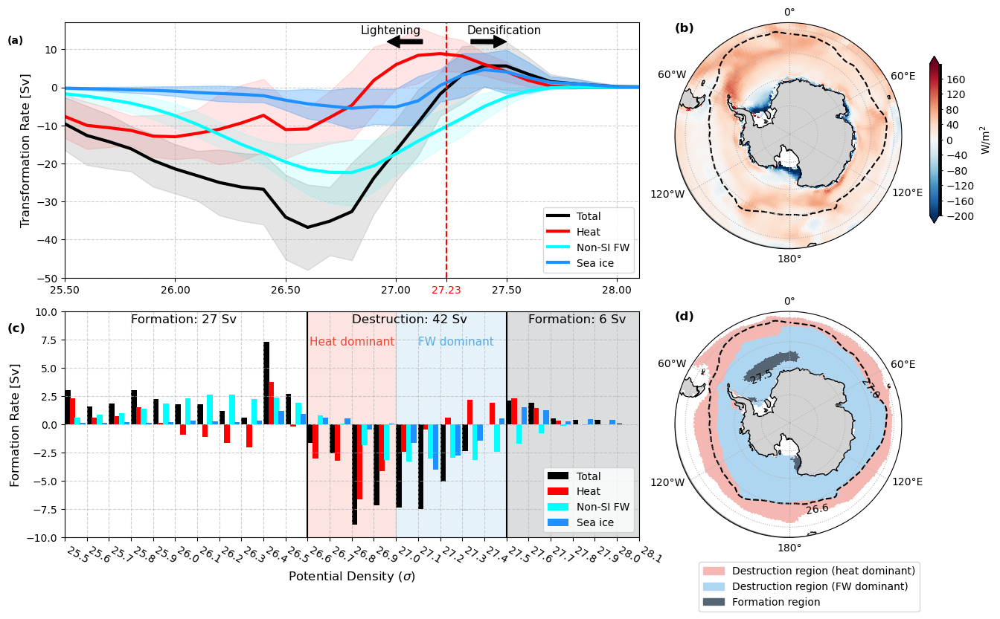

In [133]:

number_data = 4
interval = 0.1
bar_width = interval / number_data
lat_edge = -45  # Assuming lat_edge is defined somewhere
inflection_point = 27.23

# Create a figure
fig = plt.figure(figsize=(15, 9))
gs = gridspec.GridSpec(18, 18)

# Add subplots with different shapes
ax1 = fig.add_subplot(gs[0:9, :12])
ax2 = fig.add_subplot(gs[0:8, 12:], projection=ccrs.Orthographic(0, -90))
ax3 = fig.add_subplot(gs[10:, :12])
ax4 = fig.add_subplot(gs[10:, 12:], projection=ccrs.Orthographic(0, -90))
axs = [ax1, ax2, ax3, ax4]


# =============Plot transformation data=======
plot_transformation_data(ax1, mean_total_tr_in_density, std_total_tr_in_density, 'k',0.1, 'Total')
plot_transformation_data(ax1, mean_hfds_tr_in_density, std_hfds_tr_in_density, 'r',0.1, 'Heat')
plot_transformation_data(ax1, mean_nonsi_wfo_tr_in_density, std_nonsi_wfo_tr_in_density, 'cyan',0.1, 'Non-SI FW')
plot_transformation_data(ax1, mean_fsi_tr_in_density, std_fsi_tr_in_density, 'dodgerblue',0.3, 'Sea ice')

# add the line of saperation density
ax1.axvline(x=inflection_point, color='r', linestyle='--')
# ax1.text(27.25, -30, r'$\sigma$ 27.23', fontsize=12, color='r')

# Add the custom x-tick at 27.23 in red
ax1.set_xticks(list(ax1.get_xticks()) + [inflection_point])
# ax1.tick_params(axis='x', which='both', direction='in', color='r', length=6, width=1.5)
ax1.get_xticklabels()[-1].set_color('r')

# Specific adjustments for transformation subplot
ax1.set_xlim(25.5, 28.1)
ax1.set_ylim(-50, 17)
# ax1.set_title('Water Mass Transformation', fontsize=14)
ax1.legend(loc='lower right', fontsize=10)
ax1.grid(True, linestyle='--', alpha=0.6)
ax1.tick_params(axis='both', which='major', labelsize=10)
ax1.set_ylabel('Transformation Rate [Sv]', fontsize=12)
# ax1.set_xlabel('Potential Density ($\sigma$)', fontsize=12)
ax1.set_xlabel('')


# Add arrow along the 
x_arrow_start, y_arrow_start = inflection_point -.09, 12
x_arrow_end, y_arrow_end = x_arrow_start -0.2, 12
ax1.annotate('', xy=(x_arrow_end, y_arrow_end), xytext=(x_arrow_start, y_arrow_start),
             arrowprops=dict(facecolor='black', shrink=0.1),  # Shrink the arrow by 5% from both ends
            )
ax1.text(x_arrow_end-0.1, y_arrow_start+2, 'Lightening', fontsize=11, color='k')

x_arrow_start, y_arrow_start = inflection_point + .09, 12
x_arrow_end, y_arrow_end = x_arrow_start + 0.2, 12
ax1.annotate('', xy=(x_arrow_end, y_arrow_end), xytext=(x_arrow_start, y_arrow_start),
             arrowprops=dict(facecolor='black', shrink=0.1),  # Shrink the arrow by 5% from both ends
            )
ax1.text(x_arrow_start, y_arrow_start+2, 'Densification', fontsize=11, color='k')
ax1.text(-0.1, 0.95, '(a)', transform=ax1.transAxes, fontsize=10, weight='bold',
        verticalalignment='top', horizontalalignment='left')
# Highlight regions
# ax3.fill_betweenx(y=[-10, 10], x1=26.6, x2=27.0, color='#AED6F1', alpha=0.15)
ax3.fill_betweenx(y=[-10, 10], x1=26.6, x2=27.0, color='#E74C3C', alpha=0.15) # heat domiant
ax3.fill_betweenx(y=[-10, 10], x1=27.0, x2=27.5, color='#5DADE2', alpha=0.15) # fw dominant
# ax3.fill_betweenx(y=[-10, 10], x1=27.5, x2=28.0, color='#FF7F50', alpha=0.15)#8B4513
ax3.fill_betweenx(y=[-10, 10], x1=27.5, x2=28.1, color='#17202A', alpha=0.15)
# =============Plot formation data===========
ax3.bar(mean_fsi_fr_in_density.density, mean_total_fr_in_density, width=bar_width, color='k', align='edge', label='Total')
ax3.bar(mean_fsi_fr_in_density.density + 0.9 * bar_width, mean_hfds_fr_in_density, width=bar_width, color='r', align='edge', label='Heat')
ax3.bar(mean_fsi_fr_in_density.density + 1.8 * bar_width, mean_nonsi_wfo_fr_in_density, width=bar_width, color='cyan', align='edge', label='Non-SI FW')
ax3.bar(mean_fsi_fr_in_density.density + 2.7 * bar_width, mean_fsi_fr_in_density, width=bar_width, color='dodgerblue', align='edge', label='Sea ice')


# Add text annotations
ax3.text(26.8, 9, f'Destruction: {abs(des_region_total_formation):.0f} Sv', fontsize=12)#, weight='bold')
ax3.text(27.6, 9, f'Formation: {for_276_total_formation:.0f} Sv', fontsize=12)#, weight='bold')
ax3.text(25.8, 9, f'Formation: {for_265_total_formation:.0f} Sv', fontsize=12)#, weight='bold')
ax3.text(26.61, 7, f'Heat dominant', fontsize=11, c = '#E74C3C')#, weight='bold')
ax3.text(27.1, 7, f'FW dominant', fontsize=11, c = '#5DADE2')#, weight='bold')


ax3.axvline(x=26.6, color='k', linestyle='-')
ax3.axvline(x=27.5, color='k', linestyle='-')

# Specific adjustments for formation subplot

ax3.set_xticks(np.arange(25.5, 28.4, 0.1))  # Set x-axis ticks
ax3.set_xlabel('Potential Density ($\sigma$)', fontsize=12)
# ax3.set_title('Water Mass Formation', fontsize=14)
ax3.legend(loc='lower right', fontsize=10)
ax3.grid(True, linestyle='--', alpha=0.6)
ax3.tick_params(axis='both', which='major', labelsize=10)
ax3.set_ylabel('Formation Rate [Sv]', fontsize=12)
ax3.set_xlim(25.5, 28.1)
ax3.set_ylim(-10, 10)
ax3.text(-0.1, 0.95, '(c)', transform=ax3.transAxes, fontsize=12, weight='bold',
        verticalalignment='top', horizontalalignment='left')
# Rotate the xtick
for label in ax3.get_xticklabels():
    label.set_rotation(-30)
    label.set_horizontalalignment('left')
    

# ==============Plot sea ice buoyancy flux=========

plot = total_map_mean.plot(x='longitude', y='latitude',
                           transform=ccrs.PlateCarree(),
                           levels=np.arange(-200, 200, 0.5),
                           cmap='RdBu_r',
                           add_colorbar=False,
                           ax=ax2)
# Create a new axis for the colorbar
cbar_ax = fig.add_axes([0.90, 0.58, 0.008, 0.25])  # [left, bottom, width, height]

# Add a horizontal colorbar in the new axis
cbar = fig.colorbar(plot, cax=cbar_ax)

# Set colorbar label 
cbar.set_label('W/m$^2$')

si_extent_plot = sic_Sep_map_mean.plot.contour(x='longitude', y='latitude',
                                              levels=[0.15],
                                              transform=ccrs.PlateCarree(),
                                              linestyles='dashed',
                                              colors = 'k',
                                              ax = ax2
                                              ) 
ax2.coastlines()
ax2.gridlines(linestyle=':', draw_labels=True)
ax2.set_extent([-180, 180, -90, lat_edge], crs=ccrs.PlateCarree())
ax2.add_feature(cfeature.LAND, facecolor='lightgray')
# ax2.set_title('Total buoyancy flux')
ax2.set_title('')

# Add solid line at 50°S latitude
lon = np.linspace(-180, 180, 100)
lat = np.full_like(lon, lat_edge)
ax2.plot(lon, lat, color='gray', linestyle='-', transform=ccrs.PlateCarree())

# Set the boundary with a circle
theta = np.linspace(0, 2 * np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax2.set_boundary(circle, transform=ax2.transAxes)
ax2.text(0.00, 1, '(b)', transform=ax2.transAxes, fontsize=12, weight='bold',
        verticalalignment='top', horizontalalignment='left')
# ==============Plot upwelling region in density coordinate=========
levels = [1026.6, 1027.0, 1027.5]
# colors = ['w', '#AED6F1', '#6495ED', '#FF7F50'] #'#FF7F50' '#273746''#FF7F50'
colors = ['w', '#F5B7B1', '#AED6F1','#566573' ] #'#FF7F50' '#273746''#FF7F50'



# Assuming mean_total_map is defined somewhere
mean_total_map = total_map.mean('model').where(total_map.mean('model') != 0, np.nan)

# density_map_mean
density_Sep_map_mean.where(density_Sep_map_mean>1000).plot(x='longitude', y='latitude',
                                                                           levels=levels,
                                                                           transform=ccrs.PlateCarree(),
                                                                           colors=colors,
                                                                           add_colorbar = False,
                                                                           ax = ax4,
                                                                           ) 
# density_map_mean.where(density_Sep_map_mean>1000).plot(x='longitude', y='latitude',
#                                                                            levels=[1027.23],
#                                                                            transform=ccrs.PlateCarree(),
#                                                                            colors=colors,
#                                                                            add_colorbar = False,
#                                                                            ax = ax2,
#                                                                            ) 
contour_plot = (density_Sep_map_mean.where(density_Sep_map_mean>1000)-1000).plot.contour(x='longitude', y='latitude',
                                                                                  levels=[26.6, 27.0, 27.5],
                                                                                  transform=ccrs.PlateCarree(),
                                                                                  linestyles=':',
                                                                                  colors = colors,
                                                                                  ax = ax4,
                                                                                  # alpha = 0.8,
                                                                                  ) 
ax4.clabel(contour_plot, inline=True, fontsize=10, fmt='%1.1f', colors='k')   # Format as needed

si_extent_plot = sic_Sep_map_mean.plot.contour(x='longitude', y='latitude',
                                              levels=[0.15],
                                              transform=ccrs.PlateCarree(),
                                              linestyles='dashed',
                                              colors = 'k',
                                              ax = ax4
                                              ) 

legend_handles = [
    Patch(color=colors[1], label='Destruction region (heat dominant)'),
    # Patch(color=colors[2], label='Non-SI FW'),
    Patch(color=colors[2], label='Destruction region (FW dominant)'),
    Patch(color=colors[3], label='Formation region'),
]

ax4.legend(handles=legend_handles, loc='lower right', bbox_to_anchor=(1.1, -0.35),ncol=1)
ax4.coastlines()
ax4.gridlines(linestyle=':', draw_labels=True)
ax4.set_extent([-180, 180, -90, lat_edge], crs=ccrs.PlateCarree())
ax4.add_feature(cfeature.LAND, facecolor='lightgray')
# ax4.set_title('Upwelling region')
ax4.set_title('')


# Add solid line at 50°S latitude
ax4.plot(lon, lat, color='gray', linestyle='-', transform=ccrs.PlateCarree())

# Set the boundary with a circle
ax4.set_boundary(circle, transform=ax4.transAxes)

# Define arrow data as a list of dictionaries
arrow_data = [
    {'lon_start': 180, 'lat_start': -64, 'lon_end': 180, 'lat_end': -70, 'color': 'k'},
    {'lon_start': 180, 'lat_start': -61, 'lon_end': 180, 'lat_end': -55, 'color': 'k'},
    {'lon_start': 90, 'lat_start': -58, 'lon_end': 90, 'lat_end': -64, 'color': 'k'},
    {'lon_start': 90, 'lat_start': -55, 'lon_end': 90, 'lat_end': -49, 'color': 'k'},
    {'lon_start': 0, 'lat_start': -59, 'lon_end': 0, 'lat_end': -65, 'color': 'k'},
    {'lon_start': 0, 'lat_start': -56, 'lon_end': 0, 'lat_end': -50, 'color': 'k'},
    # Add more arrows as needed
]

# Plot arrows using the function
# plot_arrows(ax4, arrow_data)

ax4.text(0.00, 1, '(d)', transform=ax4.transAxes, fontsize=12, weight='bold',
        verticalalignment='top', horizontalalignment='left')
# Adjust layout
# plt.tight_layout()
plt.show()
fig.savefig('plot_ensemble_cmip6', bbox_inches='tight')

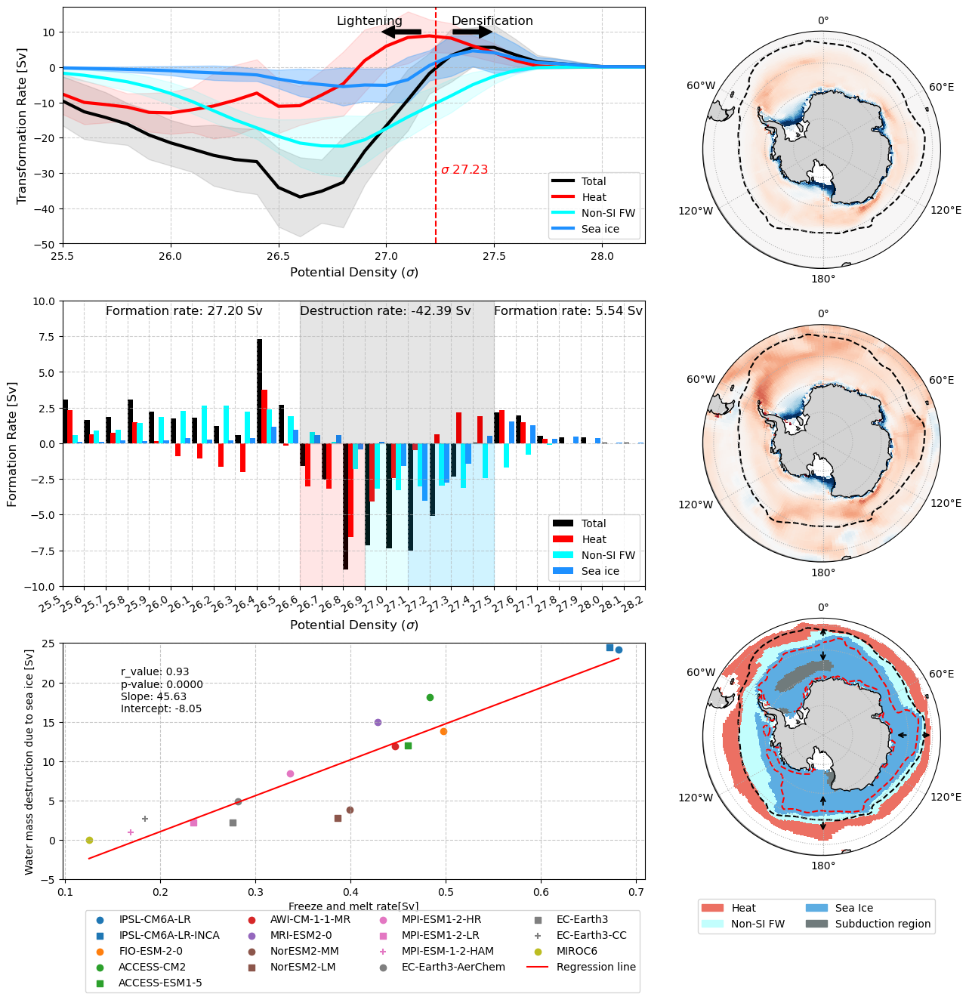

In [134]:

number_data = 4
interval = 0.1
bar_width = interval / number_data
lat_edge = -45  # Assuming lat_edge is defined somewhere

# Create a figure
fig = plt.figure(figsize=(15, 15))
gs = gridspec.GridSpec(18, 18)

# Add subplots with different shapes
ax1 = fig.add_subplot(gs[0:5, :12])
ax2 = fig.add_subplot(gs[0:6, 13:], projection=ccrs.Orthographic(0, -90))
ax2_2 = fig.add_subplot(gs[6:12, 13:], projection=ccrs.Orthographic(0, -90))
ax3 = fig.add_subplot(gs[6:12, :12])
ax4 = fig.add_subplot(gs[12:, 13:], projection=ccrs.Orthographic(0, -90))
ax5 = fig.add_subplot(gs[13:, :12])
axs = [ax1, ax2, ax3, ax4]


# =============Plot transformation data=======
plot_transformation_data(ax1, mean_total_tr_in_density, std_total_tr_in_density, 'k',0.1, 'Total')
plot_transformation_data(ax1, mean_hfds_tr_in_density, std_hfds_tr_in_density, 'r',0.1, 'Heat')
plot_transformation_data(ax1, mean_nonsi_wfo_tr_in_density, std_nonsi_wfo_tr_in_density, 'cyan',0.1, 'Non-SI FW')
plot_transformation_data(ax1, mean_fsi_tr_in_density, std_fsi_tr_in_density, 'dodgerblue',0.3, 'Sea ice')

# add the line of saperation density
ax1.axvline(x=27.23, color='r', linestyle='--')
ax1.text(27.25, -30, r'$\sigma$ 27.23', fontsize=12, color='r')

# Specific adjustments for transformation subplot
ax1.set_xlim(25.5, 28.2)
ax1.set_ylim(-50, 17)
# ax1.set_title('Water Mass Transformation', fontsize=14)
ax1.legend(loc='lower right', fontsize=10)
ax1.grid(True, linestyle='--', alpha=0.6)
ax1.tick_params(axis='both', which='major', labelsize=10)
ax1.set_ylabel('Transformation Rate [Sv]', fontsize=12)
ax1.set_xlabel('Potential Density ($\sigma$)', fontsize=12)

# Add arrow along the 
x_arrow_start, y_arrow_start = 27.17, 10
x_arrow_end, y_arrow_end = 26.97, 10
ax1.annotate('', xy=(x_arrow_end, y_arrow_end), xytext=(x_arrow_start, y_arrow_start),
             arrowprops=dict(facecolor='black', shrink=0.05),  # Shrink the arrow by 5% from both ends
            )
ax1.text(x_arrow_end-.2, y_arrow_start+2, 'Lightening', fontsize=12, color='k')

x_arrow_start, y_arrow_start = 27.3, 10
x_arrow_end, y_arrow_end = 27.5, 10
ax1.annotate('', xy=(x_arrow_end, y_arrow_end), xytext=(x_arrow_start, y_arrow_start),
             arrowprops=dict(facecolor='black', shrink=0.05),  # Shrink the arrow by 5% from both ends
            )
ax1.text(x_arrow_start, y_arrow_start+2, 'Densification', fontsize=12, color='k')

# =============Plot formation data===========
ax3.bar(mean_fsi_fr_in_density.density, mean_total_fr_in_density, width=bar_width, color='k', align='edge', label='Total')
ax3.bar(mean_fsi_fr_in_density.density + 0.9 * bar_width, mean_hfds_fr_in_density, width=bar_width, color='r', align='edge', label='Heat')
ax3.bar(mean_fsi_fr_in_density.density + 1.8 * bar_width, mean_nonsi_wfo_fr_in_density, width=bar_width, color='cyan', align='edge', label='Non-SI FW')
ax3.bar(mean_fsi_fr_in_density.density + 2.7 * bar_width, mean_fsi_fr_in_density, width=bar_width, color='dodgerblue', align='edge', label='Sea ice')

# Highlight regions
# ax3.axvspan(26.6, 26.9, color='r', alpha=0.1)
# ax3.axvspan(26.9, 27.5, color='cyan', alpha=0.1)
ax3.fill_betweenx(y=[0, 10], x1=26.6, x2=27.5, color='k', alpha=0.1)
ax3.fill_betweenx(y=[-10, 0], x1=26.6, x2=26.9, color='r', alpha=0.1)
ax3.fill_betweenx(y=[-10, 0], x1=26.9, x2=27.5, color='cyan', alpha=0.1)
ax3.fill_betweenx(y=[-10, 0], x1=27.1, x2=27.5, color='dodgerblue', alpha=0.1)

# Add text annotations
ax3.text(26.6, 9, f'Destruction rate: {des_region_total_formation:.2f} Sv', fontsize=12)#, weight='bold')
ax3.text(27.5, 9, f'Formation rate: {for_276_total_formation:.2f} Sv', fontsize=12)#, weight='bold')
ax3.text(25.7, 9, f'Formation rate: {for_265_total_formation:.2f} Sv', fontsize=12)#, weight='bold')


# ax3.text(26.6, -10, 'Heat', fontsize=12, color='r')
# ax3.text(27.0, -10, 'Freshwater', fontsize=12, color='dodgerblue')
# ax3.text(27.1, -9, 'Sea ice', fontsize=12, color='dodgerblue')

# Specific adjustments for formation subplot

ax3.set_xticks(np.arange(25.5, 28.4, 0.1))  # Set x-axis ticks
ax3.set_xlabel('Potential Density ($\sigma$)', fontsize=12)
# ax3.set_title('Water Mass Formation', fontsize=14)
ax3.legend(loc='lower right', fontsize=10)
ax3.grid(True, linestyle='--', alpha=0.6)
ax3.tick_params(axis='both', which='major', labelsize=10)
ax3.set_ylabel('Formation Rate [Sv]', fontsize=12)
ax3.set_xlim(25.5, 28.2)
ax3.set_ylim(-10, 10)

# Rotate the xtick
for label in ax3.get_xticklabels():
    label.set_rotation(30)
    label.set_horizontalalignment('right')
    
# =============Plot total buoyancy flux=========
plot = fsi_map_mean.plot(x='longitude', y='latitude',
                           transform=ccrs.PlateCarree(),
                           levels=np.arange(-200, 200, 0.5),
                           cmap='RdBu_r',
                           add_colorbar=False,
                           ax=ax2)
si_extent_plot = sic_Sep_map_mean.plot.contour(x='longitude', y='latitude',
                                              levels=[0.15],
                                              transform=ccrs.PlateCarree(),
                                              linestyles='dashed',
                                              colors = 'k',
                                              ax = ax2
                                              ) 
ax2.coastlines()
ax2.gridlines(linestyle=':', draw_labels=True)
ax2.set_extent([-180, 180, -90, lat_edge], crs=ccrs.PlateCarree())
ax2.add_feature(cfeature.LAND, facecolor='lightgray')
# ax2.set_title('Total buoyancy flux')
ax2.set_title('')

# Add solid line at 50°S latitude
lon = np.linspace(-180, 180, 100)
lat = np.full_like(lon, lat_edge)
ax2.plot(lon, lat, color='gray', linestyle='-', transform=ccrs.PlateCarree())

# Set the boundary with a circle
theta = np.linspace(0, 2 * np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax2.set_boundary(circle, transform=ax2.transAxes)

# # Configure colorbar
# cbar = plot.colorbar
# cbar.set_label('W/m$^2$')
# cbar.set_ticks(np.arange(-200, 200.1, 50))
# ==============Plot sea ice buoyancy flux=========

plot = total_map_mean.plot(x='longitude', y='latitude',
                           transform=ccrs.PlateCarree(),
                           levels=np.arange(-200, 200, 0.5),
                           cmap='RdBu_r',
                           add_colorbar=False,
                           ax=ax2_2)
si_extent_plot = sic_Sep_map_mean.plot.contour(x='longitude', y='latitude',
                                              levels=[0.15],
                                              transform=ccrs.PlateCarree(),
                                              linestyles='dashed',
                                              colors = 'k',
                                              ax = ax2_2
                                              ) 
ax2_2.coastlines()
ax2_2.gridlines(linestyle=':', draw_labels=True)
ax2_2.set_extent([-180, 180, -90, lat_edge], crs=ccrs.PlateCarree())
ax2_2.add_feature(cfeature.LAND, facecolor='lightgray')
# ax2_2.set_title('Total buoyancy flux')
ax2_2.set_title('')

# Add solid line at 50°S latitude
lon = np.linspace(-180, 180, 100)
lat = np.full_like(lon, lat_edge)
ax2_2.plot(lon, lat, color='gray', linestyle='-', transform=ccrs.PlateCarree())

# Set the boundary with a circle
theta = np.linspace(0, 2 * np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax2_2.set_boundary(circle, transform=ax2_2.transAxes)

# ==============Plot upwelling region in density coordinate=========
levels = [1026.6, 1026.9, 1027.1, 1027.5]
colors = ['w', '#EC7063', '#C2FEFD', '#5DADE2', '#707B7C']

# Assuming mean_total_map is defined somewhere
mean_total_map = total_map.mean('model').where(total_map.mean('model') != 0, np.nan)

density_Sep_map_mean.where(density_Sep_map_mean>1000).plot(x='longitude', y='latitude',
                                                                           levels=levels,
                                                                           transform=ccrs.PlateCarree(),
                                                                           colors=colors,
                                                                           add_colorbar = False,
                                                                           ax = ax4,
                                                                           ) 
contour_plot = density_Sep_map_mean.where(density_Sep_map_mean>1000).plot.contour(x='longitude', y='latitude',
                                                                                  levels=[1027.23],
                                                                                  transform=ccrs.PlateCarree(),
                                                                                  linestyles='dashed',
                                                                                  colors = 'r',
                                                                                  ax = ax4
                                                                                  ) 
si_extent_plot = sic_Sep_map_mean.plot.contour(x='longitude', y='latitude',
                                              levels=[0.15],
                                              transform=ccrs.PlateCarree(),
                                              linestyles='dashed',
                                              colors = 'k',
                                              ax = ax4
                                              ) 
# contour_plot = density_Sep_map_mean.where(density_Sep_map_mean>1000).plot.contour(x='longitude', y='latitude',
#                                                                                   levels=[1027.23],
#                                                                                   transform=ccrs.PlateCarree(),
#                                                                                   linestyles='dashed',
#                                                                                   colors = 'r',
#                                                                                   ax = ax4
#                                                                                   ) 
legend_handles = [
    Patch(color=colors[1], label='Heat'),
    Patch(color=colors[2], label='Non-SI FW'),
    Patch(color=colors[3], label='Sea Ice'),
    Patch(color=colors[4], label='Subduction region'),
]

ax4.legend(handles=legend_handles, loc='lower right', bbox_to_anchor=(1, -0.35),ncol=2)
ax4.coastlines()
ax4.gridlines(linestyle=':', draw_labels=True)
ax4.set_extent([-180, 180, -90, lat_edge], crs=ccrs.PlateCarree())
ax4.add_feature(cfeature.LAND, facecolor='lightgray')
# ax4.set_title('Upwelling region')
ax4.set_title('')


# Add solid line at 50°S latitude
ax4.plot(lon, lat, color='gray', linestyle='-', transform=ccrs.PlateCarree())

# Set the boundary with a circle
ax4.set_boundary(circle, transform=ax4.transAxes)

# Define arrow data as a list of dictionaries
arrow_data = [
    {'lon_start': 180, 'lat_start': -65, 'lon_end': 180, 'lat_end': -70, 'color': 'k'},
    {'lon_start': 180, 'lat_start': -60, 'lon_end': 180, 'lat_end': -55, 'color': 'k'},
    {'lon_start': 90, 'lat_start': -60, 'lon_end': 90, 'lat_end': -65, 'color': 'k'},
    {'lon_start': 90, 'lat_start': -55, 'lon_end': 90, 'lat_end': -50, 'color': 'k'},
    {'lon_start': 0, 'lat_start': -60, 'lon_end': 0, 'lat_end': -65, 'color': 'k'},
    {'lon_start': 0, 'lat_start': -55, 'lon_end': 0, 'lat_end': -50, 'color': 'k'},
    # Add more arrows as needed
]
# Plot arrows using the function
plot_arrows(ax4, arrow_data)

xx = fsi_form_melt_mean_rate
yy = -des_in_models
# yy = -min_fsi_tr_model
model_list_p = model_list_fsi_rank
plot_correlation_for_des(ax5, xx, yy, model_list_p)

# Adjust layout
# plt.tight_layout()
plt.show()
fig.savefig('plot_ensemble_cmip6', bbox_inches='tight')

# Marix

In [135]:
test = model_data['AWI-CM-1-1-MR']['hfds_mean_mon'].mean('month').compute()

In [136]:
buo_for_heat_335j = wmt.buoyancy_flux_heat(H = 335, S=35, T=-1, p=0)

In [137]:
buo_for_fwf_1g = wmt.buoyancy_flux_water(FWF = 0.001, S=35, T=-1, p=0)

In [138]:
buo_for_fwf_1g/buo_for_heat_335j

8.33709680540654

In [139]:
model_data[model_list[0]].keys()

dict_keys(['hfds_mean_mon', 'wfo_mean_mon', 'tos_mean_mon', 'sos_mean_mon', 'grid_area', 'lat_key', 'lon_key', 'lat_edge', 'vmo_mean_mon', 'thetao_mean_mon', 'so_mean_mon', 'nearest_index', 'sic_mean_mon', 'sid_mean_mon', 'sif_mean_mon', 'fsi_mean_mon', 'new_wfo_mean_mon', 'tr_sid_weighted_mon', 'tr_fsi_weighted_mon', 'surface_density_mean_mon', 'tr_hfds_weighted_mon', 'tr_wfo_weighted_mon', 'lateral_density_mean_mon', 'tr_lateral_mean_mon', 'buo_sid_map', 'buo_fsi_map', 'buo_total_map', 'buo_hfds_map', 'buo_wfo_map', 'wfo_sum', 'hfds_sum', 'fsi_melt', 'fsi_form', 'epr_sum', 'sid_melt', 'sid_form', 'sif_melt', 'sif_form', 'sid_tr_in_density', 'sid_form_tr_in_density', 'sid_melt_tr_in_density', 'fsi_tr_in_density', 'fsi_form_tr_in_density', 'fsi_melt_tr_in_density', 'wfo_tr_in_density', 'hfds_tr_in_density', 'total_tr_in_density', 'mix_tr_in_density', 'lateral_fr_in_density', 'sid_tr_in_density_annual', 'sid_form_tr_in_density_annual', 'sid_melt_tr_in_density_annual', 'fsi_tr_in_density

In [140]:
model_data[model_list[0]]['sic_mean_mon'].sel(month =9)

<xarray.DataArray 'sic_mean_mon' (j: 300, i: 360)> Size: 432kB
[108000 values with dtype=float32]
Coordinates:
  * j          (j) int32 1kB 0 1 2 3 4 5 6 7 ... 292 293 294 295 296 297 298 299
  * i          (i) int32 1kB 0 1 2 3 4 5 6 7 ... 352 353 354 355 356 357 358 359
    latitude   (j, i) float64 864kB -77.88 -77.88 -77.88 ... 66.04 65.63 65.21
    longitude  (j, i) float64 864kB 80.5 81.5 82.5 83.5 ... 79.96 79.97 79.99
    type       |S7 7B b'sea_ice'
    month      int64 8B 9
Attributes:
    standard_name:   sea_ice_area_fraction
    long_name:       Sea-Ice Area Percentage (Ocean Grid)
    comment:         Percentage of grid cell covered by sea ice
    units:           %
    original_units:  1
    history:         2020-08-17T00:32:59Z altered by CMOR: Converted units fr...
    cell_methods:    area: mean where sea time: mean
    cell_measures:   area: areacello

In [141]:
lat_limit = -50
for model in model_list_fsi_rank:
    data = model_data[model]
    sos_mean_mon = data['sos_mean_mon']
    tos_mean_mon = data['tos_mean_mon']
    hfds_mean_mon = data['hfds_mean_mon']
    wfo_mean_mon = data['wfo_mean_mon']
    sic_mean_sep = data['sic_mean_mon'].sel(month =9)
    lat_key = data['lat_key']
    # total_mean_mon = hfds_mean_mon + wfo_mean_mon
    
    if 'sid_mean_mon' in data:
        sid_mean_mon = data['sid_mean_mon']
        
        # The sea ice grid didn;t match ocean grid in 'NorESM2' and 'CMCC'
        if 'NorESM2' in model:
            buo_sid_mon = wmt.buoyancy_flux_water(sid_mean_mon,sos_mean_mon[:-1,:], tos_mean_mon[:-1,:], 0)
            buo_sid_mon = buo_sid_mon * data['grid_area'][:-1,:]
        elif 'CMCC' in model:
            buo_sid_mon = wmt.buoyancy_flux_water(sid_mean_mon,sos_mean_mon[:-1,1:-1], tos_mean_mon[:-1,1:-1], 0)
            buo_sid_mon = buo_sid_mon * data['grid_area'][:-1,1:-1]
            
        else:
            buo_sid_mon = wmt.buoyancy_flux_water(sid_mean_mon,sos_mean_mon, tos_mean_mon, 0)
            buo_sid_mon = buo_sid_mon * data['grid_area']

        model_data[model]['buo_sid_mon'] = buo_sid_mon
        
    if 'fsi_mean_mon' in data:
        fsi_mean_mon = data['fsi_mean_mon']
        buo_fsi_mon = wmt.buoyancy_flux_water_to_heat(fsi_mean_mon, sos_mean_mon, tos_mean_mon, 0)
        buo_fsi_mon = buo_fsi_mon.mean('month') * data['grid_area']
        
        model_data[model]['buo_fsi_mon'] = buo_fsi_mon

    buo_total_mon, buo_hfds_mon, buo_wfo_mon= wmt.buoyancy_flux(hfds_mean_mon, wfo_mean_mon, sos_mean_mon, tos_mean_mon, 0,formula='hf_term') #  formula='hf_term'
    buo_total_mon = buo_total_mon * data['grid_area']
    buo_hfds_mon = buo_hfds_mon * data['grid_area']
    buo_wfo_mon = buo_wfo_mon * data['grid_area']

    buo_total_mon = buo_total_mon.mean('month')
    buo_wfo_mon = buo_wfo_mon.mean('month')
    buo_hfds_mon = buo_hfds_mon.mean('month')
    
    buo_total_mon_dense= buo_total_mon.where(buo_total_mon<0).where(buo_total_mon[lat_key] < lat_limit).where(sic_mean_sep>.15).sum().values.item()
    buo_total_mon_light = buo_total_mon.where(buo_total_mon>0).where(buo_total_mon[lat_key] < lat_limit).where(sic_mean_sep>.15).sum().values.item()
    if 'sid_mean_mon' in data:
        # buo_sid_mon_dense= buo_sid_mon.where(buo_total_mon>0).where(buo_total_mon[lat_key] < lat_limit).sum().values.item()
        # buo_sid_mon_light = buo_sid_mon.where(buo_total_mon<0).where(buo_total_mon[lat_key] < lat_limit).sum().values.item()
        buo_sid_mon_dense= buo_sid_mon.where(buo_sid_mon>0).where(buo_total_mon[lat_key] < lat_limit).sum().values.item()
        buo_sid_mon_light = buo_sid_mon.where(buo_sid_mon<0).where(buo_total_mon[lat_key] < lat_limit).sum().values.item()
        data.update({
        'buo_sid_mon_dense': buo_sid_mon_dense,
        'buo_sid_mon_light': buo_sid_mon_light,
        }) 
    if 'fsi_mean_mon' in data:
        buo_fsi_mon_dense= buo_fsi_mon.where(buo_fsi_mon<0).where(buo_total_mon[lat_key] < lat_limit).sum().values.item()
        buo_fsi_mon_light = buo_fsi_mon.where(buo_fsi_mon>0).where(buo_total_mon[lat_key] < lat_limit).sum().values.item()
        buo_fsi_mon_dense_sie= buo_fsi_mon.where(buo_total_mon<0).where(buo_total_mon[lat_key] < lat_limit).where(sic_mean_sep>.15).sum().values.item()
        buo_fsi_mon_light_sie = buo_fsi_mon.where(buo_total_mon>0).where(buo_total_mon[lat_key] < lat_limit).where(sic_mean_sep>.15).sum().values.item()
        data.update({
        'buo_fsi_mon_dense': buo_fsi_mon_dense,
        'buo_fsi_mon_light': buo_fsi_mon_light,
        'buo_fsi_mon_dense_sie': buo_fsi_mon_dense_sie,
        'buo_fsi_mon_light_sie': buo_fsi_mon_light_sie,
        }) 
    data.update({
        'buo_total_mon_dense': buo_total_mon_dense,
        'buo_total_mon_light': buo_total_mon_light,
        # 'buo_sid_mon_dense': buo_sid_mon_dense,
        # 'buo_sid_mon_light': buo_sid_mon_light,
    }) 

In [142]:
# model_data

In [143]:
total_buo_dense_lsit = []
total_buo_light_lsit = []
fsi_buo_dense_lsit = []
fsi_buo_light_lsit = []
fsi_dense_ratio_list = []
fsi_light_ratio_list = []

for model in model_list_fsi_rank:
    data = model_data[model]
    total_dense = data['buo_total_mon_dense']
    total_light = data['buo_total_mon_light']
    fsi_dense = data['buo_fsi_mon_dense']
    fsi_light = data['buo_fsi_mon_light']
    fsi_dense_ratio = fsi_dense/total_dense
    fsi_light_ratio = fsi_light/total_light
    
    total_buo_dense_lsit.append(total_dense)
    total_buo_light_lsit.append(total_light)
    fsi_buo_dense_lsit.append(fsi_dense)
    fsi_buo_light_lsit.append(fsi_light)
    fsi_dense_ratio_list.append(fsi_dense_ratio)
    fsi_light_ratio_list.append(fsi_light_ratio)

# Assuming all lists have the same length
data = {
    'model': model_list_fsi_rank,
    'total_buo_dense': total_buo_dense_lsit,
    'total_buo_light': total_buo_light_lsit,
    'fsi_buo_dense': fsi_buo_dense_lsit,
    'fsi_buo_light': fsi_buo_light_lsit,
    'fsi_dense_ratio': fsi_dense_ratio_list,
    'fsi_light_ratio': fsi_light_ratio_list
}

# Create DataFrame
df = pd.DataFrame(data)

# Display DataFrame
df


,model,total_buo_dense,total_buo_light,fsi_buo_dense,fsi_buo_light,fsi_dense_ratio,fsi_light_ratio
0,IPSL-CM6A-LR,-1.086547e+15,1.430631e+15,-1.177916e+15,1.005172e+15,1.084091,0.702607
1,IPSL-CM6A-LR-INCA,-1.087405e+15,1.354517e+15,-1.172897e+15,9.658349e+14,1.078620,0.713048
2,FIO-ESM-2-0,-4.855638e+14,1.943649e+15,-6.670711e+14,1.044452e+15,1.373807,0.537367
3,ACCESS-CM2,-9.221032e+14,1.025344e+15,-7.222077e+14,8.612951e+14,0.783218,0.840006
4,ACCESS-ESM1-5,-7.727106e+14,1.126035e+15,-8.382761e+14,6.493156e+14,1.084851,0.576639
5,AWI-CM-1-1-MR,-5.070010e+14,1.633292e+15,-8.614784e+14,8.869862e+14,1.699165,0.543066
6,MRI-ESM2-0,-4.495246e+14,9.220597e+14,-3.741076e+14,7.634132e+14,0.832229,0.827943
7,NorESM2-MM,-6.996355e+14,1.114612e+15,-9.126493e+14,8.396580e+14,1.304464,0.753318
8,NorESM2-LM,-7.841434e+14,1.135106e+15,-1.003926e+15,8.974112e+14,1.280284,0.790597
9,MPI-ESM1-2-HR,-1.980688e+14,1.804617e+15,-5.563194e+14,1.477361e+14,2.808719,0.081866


In [144]:
total_buo_dense_lsit = []
total_buo_light_lsit = []
sid_buo_dense_lsit = []
sid_buo_light_lsit = []
sid_dense_ratio_list = []
sid_light_ratio_list = []

for model in model_list_sid:
    data = model_data[model]
    total_dense = data['buo_total_mon_dense']
    total_light = data['buo_total_mon_light']
    sid_dense = data['buo_sid_mon_dense']
    sid_light = data['buo_sid_mon_light']
    sid_dense_ratio = sid_dense/total_dense
    sid_light_ratio = sid_light/total_light
    
    total_buo_dense_lsit.append(total_dense)
    total_buo_light_lsit.append(total_light)
    sid_buo_dense_lsit.append(sid_dense)
    sid_buo_light_lsit.append(sid_light)
    sid_dense_ratio_list.append(sid_dense_ratio)
    sid_light_ratio_list.append(sid_light_ratio)



KeyError: 'buo_total_mon_dense'

In [ ]:
# Assuming all lists have the same length
data = {
    'model': model_list_sid,
    'total_buo_dense': total_buo_dense_lsit,
    'total_buo_light': total_buo_light_lsit,
    'sid_buo_dense': sid_buo_dense_lsit,
    'sid_buo_light': sid_buo_light_lsit,
    'sid_dense_ratio': sid_dense_ratio_list,
    'sid_light_ratio': sid_light_ratio_list
}

# Create DataFrame
df = pd.DataFrame(data)

# Display DataFrame
df


In [ ]:
model